# Clustering initialization

## Imports

In [1]:
%load_ext autoreload
%autoreload 2
# This will automatically reload modules before executing code that depends on them.

from copy import deepcopy

# 3rd party imports
import numpy as np
np.set_printoptions(linewidth=1000)
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt
from pprint import pprint

# local imports
from modules import jacobian
from modules.data_fixed import Data
from modules.data import Data as Data_Moving
from cluster_modules import cluster, data_utils, reg_utils

## Create sample datasets

Plotted 30 point correspondences
Set 1 - X range: [50.0, 150.0], Y range: [50.3, 149.7]
Set 2 - X range: [82.8, 217.2], Y range: [51.8, 148.2]
Correspondence distances - Mean: 58.73, Std: 14.59, Max: 83.64


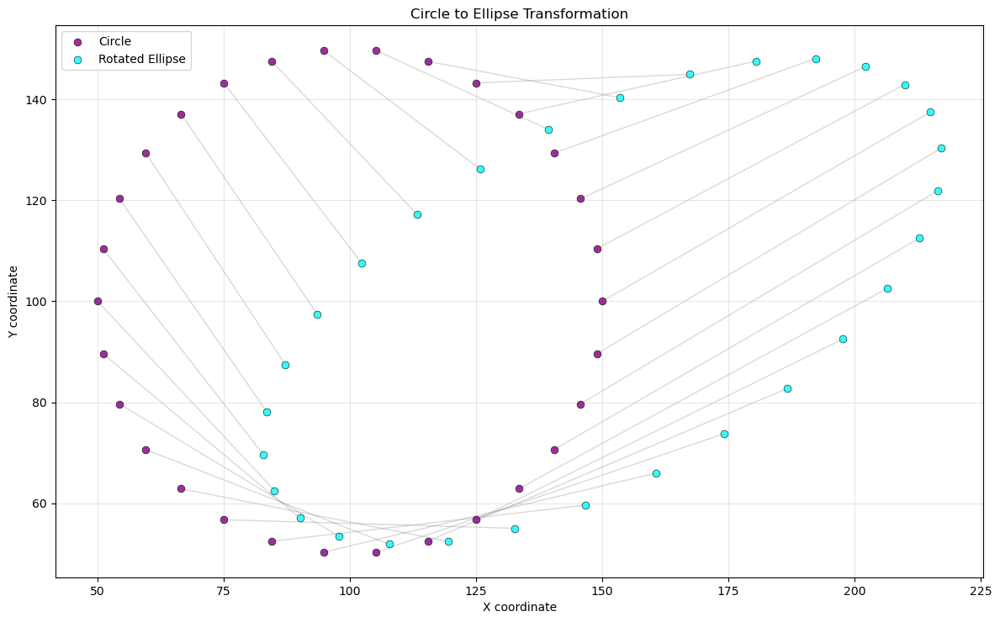

In [2]:
circle_points, ellipse_points = data_utils.circle_to_ellipse_correspondences()

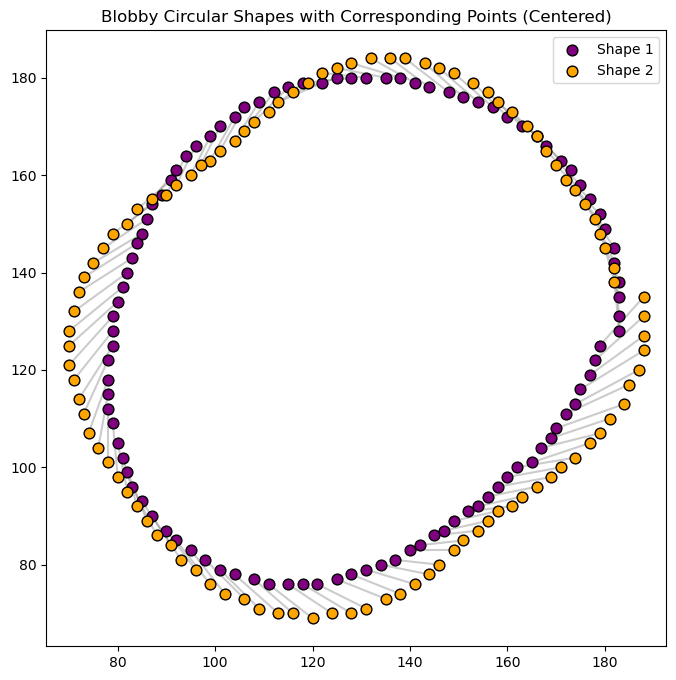

In [3]:
blob1, blob2 = data_utils.create_blobby_circular_shapes(n_points=100, plot=True, noise_scale=6)

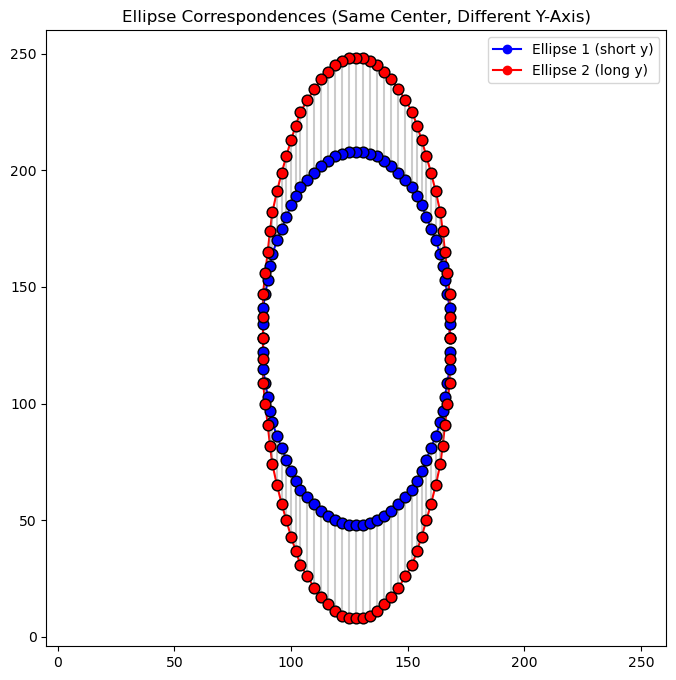

In [4]:
ellipse1, ellipse2 = data_utils.create_ellipse_correspondences(n_points=80, plot=True)

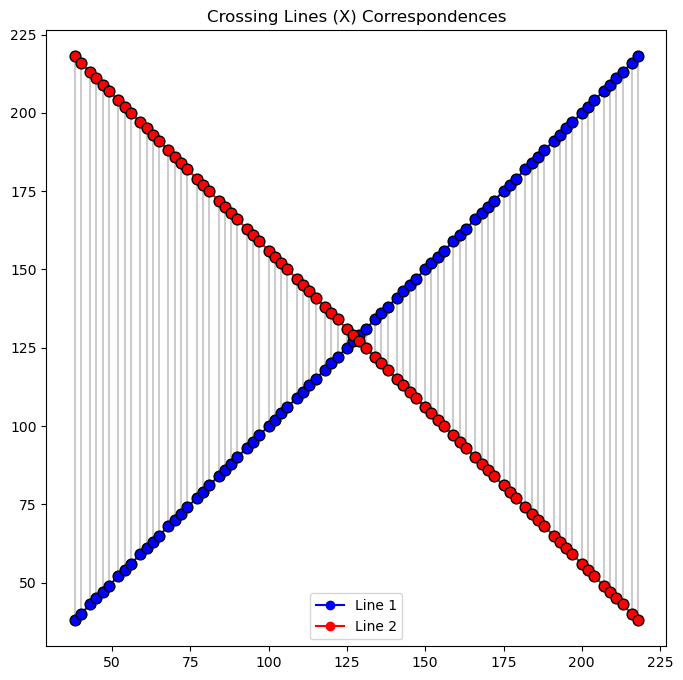

In [5]:
line1, line2 = data_utils.create_crossing_lines_correspondences(n_points=80, plot=True)

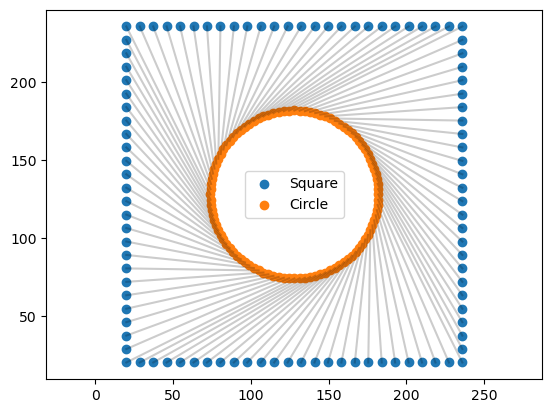

In [6]:
def square_to_circle_correspondences(n_points=100, square_size=1.0, circle_radius=1.0, resolution=(256, 256), padding=20):
    """
    Generates n_points correspondences from a square to a circle,
    mapped to a given image resolution with padding from the edges.
    Returns:
        square_points: (n_points, 2) array of (x, y) in image coordinates
        circle_points: (n_points, 2) array of (x, y) in image coordinates
    """
    # Square points: uniformly sample points along the square perimeter in CCW order starting from bottom left
    per_side = n_points // 4
    remainder = n_points % 4
    sides = [per_side] * 4
    for i in range(remainder):
        sides[i] += 1

    # Bottom (left to right)
    x0 = np.linspace(-square_size, square_size, sides[0], endpoint=False)
    y0 = np.full_like(x0, -square_size)
    # Right (bottom to top)
    y1 = np.linspace(-square_size, square_size, sides[1], endpoint=False)
    x1 = np.full_like(y1, square_size)
    # Top (right to left)
    x2 = np.linspace(square_size, -square_size, sides[2], endpoint=False)
    y2 = np.full_like(x2, square_size)
    # Left (top to bottom)
    y3 = np.linspace(square_size, -square_size, sides[3], endpoint=False)
    x3 = np.full_like(y3, -square_size)

    square_points = np.concatenate([
        np.stack([x0, y0], axis=1),
        np.stack([x1, y1], axis=1),
        np.stack([x2, y2], axis=1),
        np.stack([x3, y3], axis=1)
    ], axis=0)

    # Map each square point to a circle point by angle, starting at -pi/2 (bottom)
    angles = np.linspace(-np.pi/2, 3*np.pi/2, n_points, endpoint=False)
    circle_points = np.stack([
        circle_radius * np.cos(angles),
        circle_radius * np.sin(angles)
    ], axis=1)

    # Center both shapes in the image
    img_center = np.array(resolution) / 2

    def to_image_coords(points, obj_size):
        # Scale so that the largest shape fits within the padded area
        scale = (np.array(resolution) - 2 * padding) / (2 * max(square_size, circle_radius))
        img_points = points * scale + img_center
        return img_points

    square_img_points = to_image_coords(square_points, square_size)
    circle_img_points = to_image_coords(circle_points, circle_radius)

    return square_img_points, circle_img_points

# Usage example
square_pts, circle_pts = square_to_circle_correspondences(n_points=100, circle_radius=0.5)
plt.scatter(square_pts[:,0], square_pts[:,1], label='Square')
plt.scatter(circle_pts[:,0], circle_pts[:,1], label='Circle')
for i in range(len(square_pts)):
    plt.plot([square_pts[i,0], circle_pts[i,0]], [square_pts[i,1], circle_pts[i,1]], 'k-', alpha=0.2)
plt.legend()
plt.axis('equal')
plt.show()

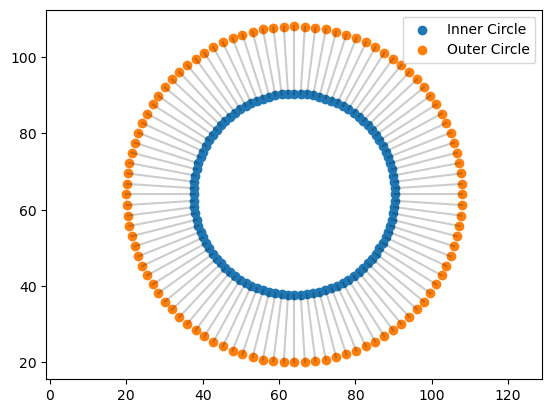

In [7]:
def circle_to_circle_correspondences(n_points=100, inner_radius=0.5, outer_radius=1.0, resolution=(256, 256), padding=20):
    """
    Generates n_points correspondences from an inner circle to an outer circle,
    mapped to a given image resolution with padding from the edges.
    Returns:
        inner_points: (n_points, 2) array of (x, y) in image coordinates
        outer_points: (n_points, 2) array of (x, y) in image coordinates
    """
    # Sample points along the perimeter, CCW starting from bottom
    angles = np.linspace(-np.pi/2, 3*np.pi/2, n_points, endpoint=False)
    inner_points = np.stack([
        inner_radius * np.cos(angles),
        inner_radius * np.sin(angles)
    ], axis=1)
    outer_points = np.stack([
        outer_radius * np.cos(angles),
        outer_radius * np.sin(angles)
    ], axis=1)

    # Center both shapes in the image
    img_center = np.array(resolution) / 2

    def to_image_coords(points, obj_size):
        # Scale so that the largest shape fits within the padded area
        scale = (np.array(resolution) - 2 * padding) / (2 * outer_radius)
        img_points = points * scale + img_center
        return img_points

    inner_img_points = to_image_coords(inner_points, inner_radius)
    outer_img_points = to_image_coords(outer_points, outer_radius)

    return inner_img_points, outer_img_points

# Usage example
inner_pts, outer_pts = circle_to_circle_correspondences(n_points=100, resolution=(128, 128), inner_radius=0.15, outer_radius=0.25)
plt.scatter(inner_pts[:,0], inner_pts[:,1], label='Inner Circle')
plt.scatter(outer_pts[:,0], outer_pts[:,1], label='Outer Circle')
for i in range(len(inner_pts)):
    plt.plot([inner_pts[i,0], outer_pts[i,0]], [inner_pts[i,1], outer_pts[i,1]], 'k-', alpha=0.2)
plt.legend()
plt.axis('equal')
plt.show()

# Correspondence density comparison

## Full double-helix

In [8]:
RUN_EXPERIMENT = False

if RUN_EXPERIMENT:
    # Create a specific double helix for correspondence analysis
    print("\n=== Creating Double Helix for Point Correspondence ===")

    resolution = (256, 256)  # Example resolution for the data
    points_to_skip = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # Skip every nth point for better visualization

    #####################################################################################################

    for num_points_skip in points_to_skip:
        print(f"\n=== Resolution / {num_points_skip} ===")

        helix_wave1, helix_wave2, _ = data_utils.create_double_helix_waves(
            grid_size=256,
            num_cycles=2,
            amplitude_ratio=0.03,
            phase_offset=np.pi,  # 180 degrees for maximum separation
            padding_ratio=0.1,
            plot=False,
            horizontal=False  # Set horizontal to False for vertical helix
        )

        # Decrease point density for better visualization
        helix_wave1 = helix_wave1[::num_points_skip]  # Take every second point
        helix_wave2 = helix_wave2[::num_points_skip]  # Take every second point

        # Plot the correspondences between the two helical waves
        data_utils.plot_point_correspondences(helix_wave1, helix_wave2,
                                labels=('Moving points', 'Fixed points'),
                                colors=('red', 'blue'),
                                title=f'Double Helix Point Correspondences (resolution / {num_points_skip})',
                                show_indices=False,
                                line_alpha=0.2,  # More transparent lines to show the pattern better
                                point_size=20)

        # Swap columns to match expected format (x, y)
        helix_wave1 = helix_wave1[:, [1, 0]]  # Swap to (y, x) format
        helix_wave2 = helix_wave2[:, [1, 0]]  # Swap to (y, x) format 

        # Add 0s on the first axis to format for Data class
        helix_wave1 = np.pad(helix_wave1, ((0, 0), (1, 0)), mode='constant', constant_values=0)
        helix_wave2 = np.pad(helix_wave2, ((0, 0), (1, 0)), mode='constant', constant_values=0)

        # Run Laplacian
        d = Data(helix_wave1, helix_wave2, resolution)
        d.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False,
            title=f"Double helix (point resolution / {num_points_skip})\nMin Jdet: {d.min():.2f}, Negatives: {d.count_negatives()}")

## Downwards cluster

In [9]:
if RUN_EXPERIMENT:
    # Create a specific double helix for correspondence analysis
    print("\n=== Creating Double Helix for Point Correspondence ===")

    resolution = (256, 256)  # Example resolution for the data
    points_to_skip = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # Skip every nth point for better visualization

    #####################################################################################################

    for num_points_skip in points_to_skip:
        print(f"\n=== Resolution / {num_points_skip} ===")

        helix_wave1, helix_wave2, _ = data_utils.create_double_helix_waves(
            grid_size=256,
            num_cycles=2,
            amplitude_ratio=0.03,
            phase_offset=np.pi,  # 180 degrees for maximum separation
            padding_ratio=0.1,
            plot=False,
            horizontal=False  # Set horizontal to False for vertical helix
        )

        # Decrease point density for better visualization
        helix_wave1 = helix_wave1[::num_points_skip]  # Take every second point
        helix_wave2 = helix_wave2[::num_points_skip]  # Take every second point

        # Plot the correspondences between the two helical waves
        data_utils.plot_point_correspondences(helix_wave1, helix_wave2,
                                labels=('Moving points', 'Fixed points'),
                                colors=('red', 'blue'),
                                title='Double Helix Point Correspondences',
                                show_indices=False,
                                line_alpha=0.2,  # More transparent lines to show the pattern better
                                point_size=20)

        # Swap columns to match expected format (x, y)
        helix_wave1 = helix_wave1[:, [1, 0]]  # Swap to (y, x) format
        helix_wave2 = helix_wave2[:, [1, 0]]  # Swap to (y, x) format 

        # Add 0s on the first axis to format for Data class
        helix_wave1 = np.pad(helix_wave1, ((0, 0), (1, 0)), mode='constant', constant_values=0)
        helix_wave2 = np.pad(helix_wave2, ((0, 0), (1, 0)), mode='constant', constant_values=0)

        #print(f"Analyzing {len(original_moving_points)} point correspondences from double helix")
        cluster_indices, cluster_info = cluster.get_cluster_indices(helix_wave1, helix_wave2)

        # Run Laplacian
        d = Data(helix_wave1[cluster_indices[0]], helix_wave2[cluster_indices[0]], resolution)
        d.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False)
        print(f"Minimum Jacobian determinant: {d.min():.2f}")
        print(f"Number of negative Jacobian determinants: {d.count_negatives()}")

## Upwards cluster

In [10]:
if RUN_EXPERIMENT:
    # Create a specific double helix for correspondence analysis
    print("\n=== Creating Double Helix for Point Correspondence ===")

    resolution = (256, 256)  # Example resolution for the data
    points_to_skip = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]  # Skip every nth point for better visualization

    #####################################################################################################

    for num_points_skip in points_to_skip:
        print(f"\n=== Resolution / {num_points_skip} ===")

        helix_wave1, helix_wave2, _ = data_utils.create_double_helix_waves(
            grid_size=256,
            num_cycles=2,
            amplitude_ratio=0.03,
            phase_offset=np.pi,  # 180 degrees for maximum separation
            padding_ratio=0.1,
            plot=False,
            horizontal=False  # Set horizontal to False for vertical helix
        )

        # Decrease point density for better visualization
        helix_wave1 = helix_wave1[::num_points_skip]  # Take every second point
        helix_wave2 = helix_wave2[::num_points_skip]  # Take every second point

        # Plot the correspondences between the two helical waves
        data_utils.plot_point_correspondences(helix_wave1, helix_wave2,
                                labels=('Moving points', 'Fixed points'),
                                colors=('red', 'blue'),
                                title='Double Helix Point Correspondences',
                                show_indices=False,
                                line_alpha=0.2,  # More transparent lines to show the pattern better
                                point_size=20)

        # Swap columns to match expected format (x, y)
        helix_wave1 = helix_wave1[:, [1, 0]]  # Swap to (y, x) format
        helix_wave2 = helix_wave2[:, [1, 0]]  # Swap to (y, x) format 

        # Add 0s on the first axis to format for Data class
        helix_wave1 = np.pad(helix_wave1, ((0, 0), (1, 0)), mode='constant', constant_values=0)
        helix_wave2 = np.pad(helix_wave2, ((0, 0), (1, 0)), mode='constant', constant_values=0)

        #print(f"Analyzing {len(original_moving_points)} point correspondences from double helix")
        cluster_indices, cluster_info = cluster.get_cluster_indices(helix_wave1, helix_wave2)

        # Run Laplacian
        d = Data(helix_wave1[cluster_indices[1]], helix_wave2[cluster_indices[1]], resolution)
        d.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False)
        print(f"Minimum Jacobian determinant: {d.min():.2f}")
        print(f"Number of negative Jacobian determinants: {d.count_negatives()}")

# Create data

## Parameters

In [38]:
resolution = (256, 256)  # Example resolution for the data
num_points_skip = 1  # Skip every 5th point for better visualization
shift_distance = 100  # Distance to shift the moving and fixed points from each other (try 100 for max distance)
cluster_method = 'y_direction'
m_data = None
f_data = None

## Full Laplacian


=== Creating Double Helix for Point Correspondence ===
Created double helix with 206 points per wave
Grid size: 256x256
Padding: 25 pixels on each side
Number of cycles: 2
Phase offset: 3.142 radians (180.0 degrees)
Wave 1 - X range: [25, 230], Y range: [120, 136]
Wave 2 - X range: [25, 230], Y range: [120, 136]
Number of intersection points: 10
Plotted 206 point correspondences
Set 1 - X range: [25.0, 230.0], Y range: [20.0, 36.0]
Set 2 - X range: [25.0, 230.0], Y range: [220.0, 236.0]
Correspondence distances - Mean: 200.00, Std: 10.92, Max: 216.00


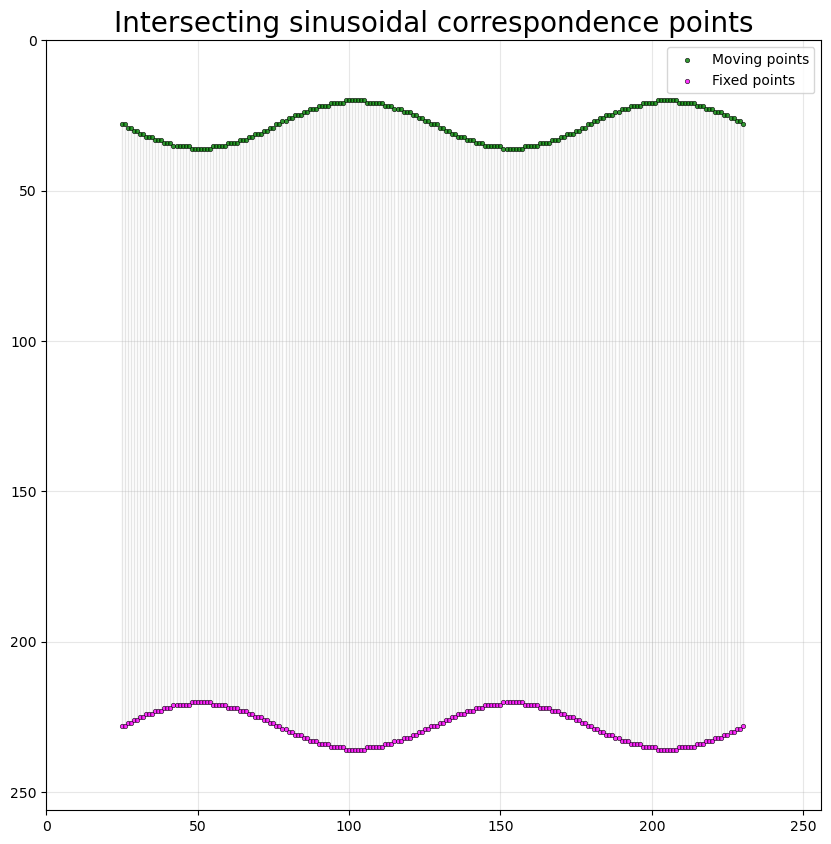

Analyzing 206 point pairs for directional clustering...
Clustering method: y_direction

Clustering Results (Y-direction (0=down, 1=up)):
Number of clusters: 1
Cluster 0: 206 points (indices: [0, 1, 2, 3, 4]...)
  Mean displacement: Z=0.000, Y=200.000, X=0.000
  Std displacement:  Z=0.000, Y=10.915, X=0.000
ERROR: Error getting cluster indices. Ensure the points are in the correct format and the correct method is used (y_direction or x_direction). Using half of the points as down_indices and the other half as up_indices.


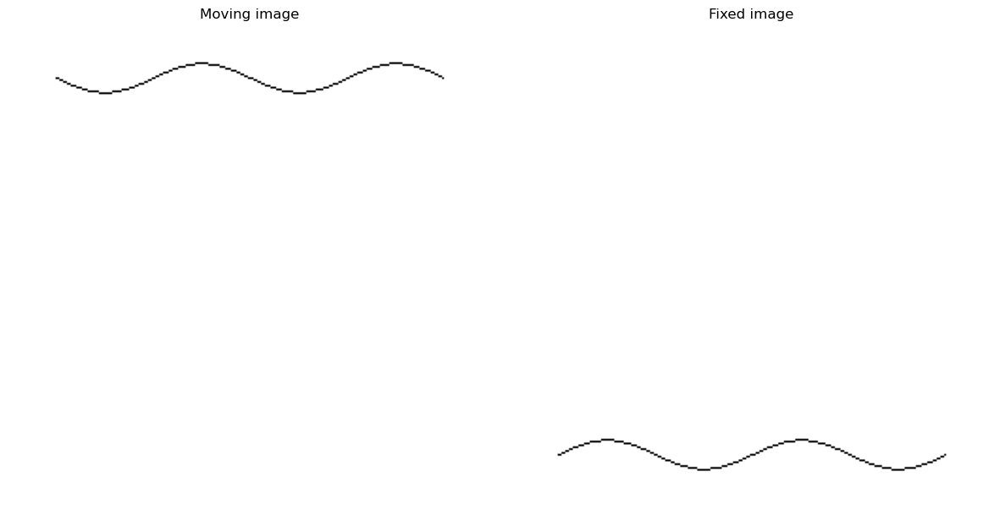

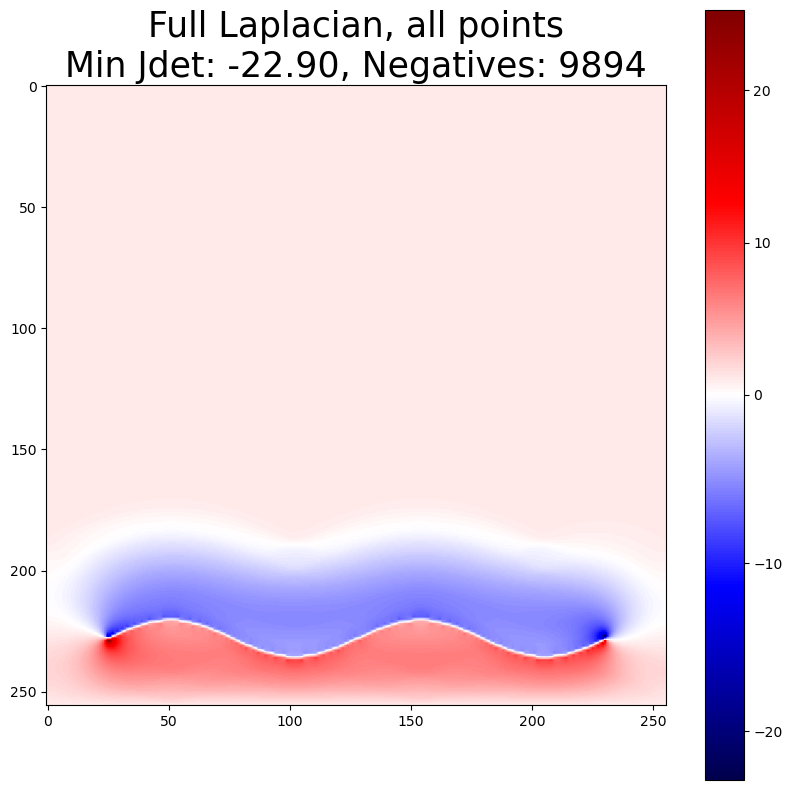

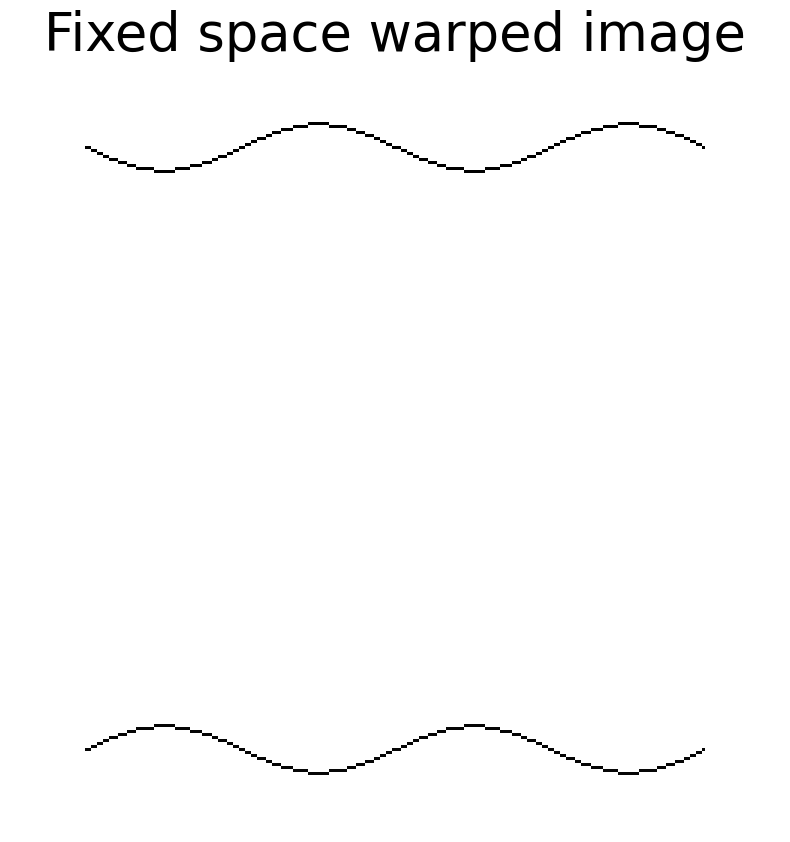

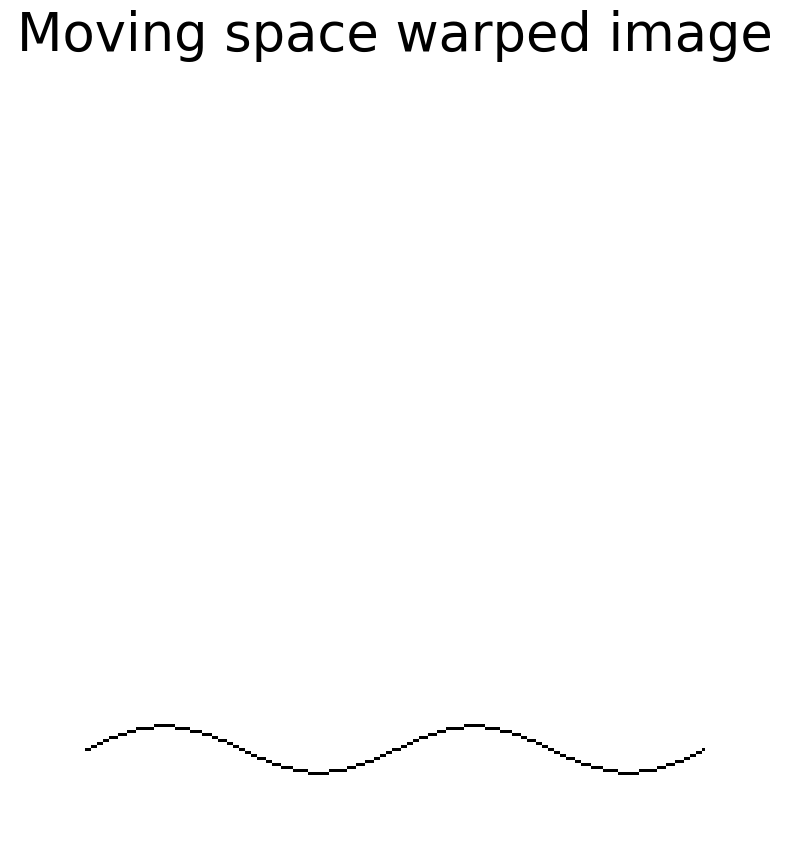

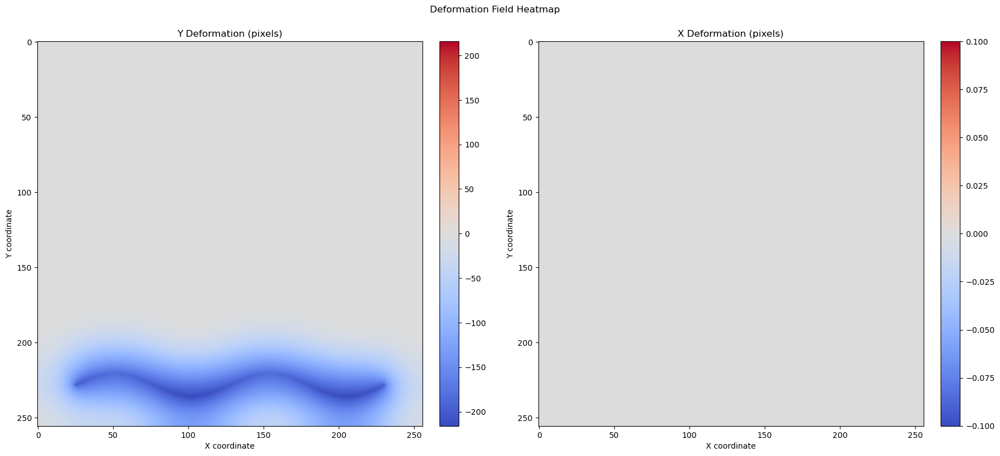

fdata.shape (1, 256, 256)
Time taken to create A:  0.07851958274841309
||Ax - b||: 28.45
Mean error at correspondences: 200.0


In [39]:
#####################################################################################################
# SETUP 
#####################################################################################################

# Create a specific double helix for correspondence analysis
print("\n=== Creating Double Helix for Point Correspondence ===")
helix_wave1, helix_wave2, _ = data_utils.create_double_helix_waves(
    grid_size=min(resolution),
    num_cycles=2,
    amplitude_ratio=0.03,
    phase_offset=np.pi,  # 180 degrees for maximum separation
    padding_ratio=0.1,
    plot=False, horizontal=False,  # Set horizontal to False for vertical helix
)

# Swap with other data if provided
if m_data is not None:
    helix_wave1 = m_data
if f_data is not None:
    helix_wave2 = f_data
    
# Move helix_waves aways from each other
helix_wave1[:, 1] += -shift_distance
helix_wave2[:, 1] += shift_distance

#helix_wave1[:, 1] += 20 # y
#helix_wave1[:, 0] += 20 # x

# Decrease point density for better visualization
helix_wave1 = helix_wave1[::num_points_skip]  # Take every second point
helix_wave2 = helix_wave2[::num_points_skip]  # Take every second point

# Plot the correspondences between the two helical waves
data_utils.plot_point_correspondences(helix_wave1, helix_wave2,
                          labels=('Moving points', 'Fixed points'),
                          colors=('green', 'magenta'),
                          title='Intersecting sinusoidal correspondence points',
                          show_indices=False,
                          line_alpha=0.2,  # More transparent lines to show the pattern better
                          point_size=10,
                          figsize=(10, 10))

# Swap columns to match expected format (x, y)
helix_wave1 = helix_wave1[:, [1, 0]]  # Swap to (y, x) format
helix_wave2 = helix_wave2[:, [1, 0]]  # Swap to (y, x) format 

# Add 0s on the first axis to format for Data class
helix_wave1 = np.pad(helix_wave1, ((0, 0), (1, 0)), mode='constant', constant_values=0)
helix_wave2 = np.pad(helix_wave2, ((0, 0), (1, 0)), mode='constant', constant_values=0)

# Get the downwards and upwards clusters
try:
    cluster_indices, cluster_info = cluster.get_cluster_indices(helix_wave1, helix_wave2, method=cluster_method)
    down_indices = cluster_indices[0]
    up_indices = cluster_indices[1]
    raise Exception
except:
    print("ERROR: Error getting cluster indices. Ensure the points are in the correct format and the correct method is used (y_direction or x_direction). Using half of the points as down_indices and the other half as up_indices.")
    down_indices = [i for i in range(len(helix_wave1)//2)]
    up_indices = [i for i in range(len(helix_wave1)//2, len(helix_wave1))]

# Save to raw image
moving_img = data_utils.create_raw_image(helix_wave1, resolution, save_path="wave1.png")
fixed_img = data_utils.create_raw_image(helix_wave2, resolution, save_path="wave2.png")
data_utils.show_2_pngs(moving_img, fixed_img, title1="Moving image", title2="Fixed image")

#####################################################################################################
# Run Laplacian
#####################################################################################################

d = Data(helix_wave1, helix_wave2, resolution)
d_m = Data_Moving(helix_wave1, helix_wave2, resolution)  # For moving image

d_original = deepcopy(d)  # Save original data for later use

d.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10),
       title=f"Full Laplacian, all points\nMin Jdet: {d.min():.2f}, Negatives: {d.count_negatives()}")
transformed_img = reg_utils.apply_transformation_fixed(d, moving_img, title="Fixed space warped image")
transformed_img_moving = reg_utils.apply_transformation(d_m, moving_img, title="Moving space warped image")

reg_utils.deformation_heatmap(d, title="Deformation Field Heatmap")

_, _, _, total_err = reg_utils.compute_error_fixed(d.resolution, helix_wave1, helix_wave2, d.deformation)
print(f"||Ax - b||: {total_err:.2f}")
errors = reg_utils.correspondence_error(d.deformation, helix_wave1, helix_wave2)
print("Mean error at correspondences:", np.mean(errors))
#rint("Max error at correspondences:", np.max(errors))

In [13]:
#down_indices_copy = deepcopy(down_indices)
#up_indices_copy = deepcopy(up_indices)
#down_indices = down_indices_copy
#up_indices = up_indices_copy

## Run on individual clusters

In [14]:
RUN_EXPERIMENT = False
if RUN_EXPERIMENT:
        # Run Laplacian on down indices
        d = Data(helix_wave1[down_indices], helix_wave2[down_indices], resolution)
        d.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, binarize_negatives=False, figsize=(10, 10),
                title="Down Cluster\nMin Jdet: {:.2f}, Negatives: {}".format(d.min(), d.count_negatives()))
        _ = reg_utils.apply_transformation_fixed(d, moving_img, mpoints=d.mpoints, fpoints=d.fpoints, title="Transformed Moving Image (Down cluster)")
        _, _, _, total_err = reg_utils.compute_error_fixed(d.resolution, helix_wave1[down_indices], helix_wave2[down_indices], d.deformation)
        print(f"Down cluster error: {total_err:.2f}")

        # Run Laplacian on up indices
        d = Data(helix_wave1[up_indices], helix_wave2[up_indices], resolution)
        d.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, binarize_negatives=False, figsize=(10, 10),
                title=f"Up Cluster\nMin Jdet: {d.min():.2f}, Negatives: {d.count_negatives()}")
        _ = reg_utils.apply_transformation_fixed(d, moving_img, mpoints=d.mpoints, fpoints=d.fpoints, title="Transformed Moving Image (Up cluster)")
        _, _, _, total_err = reg_utils.compute_error_fixed(d.resolution, helix_wave1[up_indices], helix_wave2[up_indices], d.deformation)
        print(f"Up cluster error: {total_err:.2f}")

## Laplacian clustering

In [15]:
def cluster_laplacian(moving_points, fixed_points, resolution, clusters, moving_img=None, verbose=True):
    """
    Apply manual cluster-wise deformation as in the 'Down first' block.
    Args:
        moving_points: np.ndarray, shape (N, 3)
        fixed_points: np.ndarray, shape (N, 3)
        resolution: tuple, image resolution
        clusters: list of lists/arrays, each contains indices for a cluster
        moving_img: optional, image for visualization
        verbose: bool, show plots and info
    Returns:
        d_combined: Data object with combined deformation
    """
    # Step 1: First cluster deformation
    cluster1_idx = clusters[0]
    cluster2_idx = clusters[1]
    d1 = Data(moving_points[cluster1_idx], fixed_points[cluster1_idx], resolution)
    if verbose:
        d1.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False,
                binarize_negatives=False, title=f"Cluster 1\nMin Jdet: {d1.min():.2f}, Negatives: {d1.count_negatives()}")
    if moving_img is not None:
        iter1 = reg_utils.apply_transformation_fixed(d1, moving_img, mpoints=moving_points, fpoints=fixed_points,
                                    title="Transformed Moving Image (Cluster 1)")
    else:
        iter1 = None

    # Step 2: Fix cluster 1 points, move cluster 2 points
    new_mpoints = moving_points.copy()
    new_fpoints = fixed_points.copy()
    new_mpoints[cluster1_idx] = new_fpoints[cluster1_idx]  # Fix moving points to fixed points

    for idx in cluster2_idx:
        curr_mcoord = moving_points[idx]
        curr_fcoord = fixed_points[idx]
        
        #curr_mcoord = np.round(curr_mcoord).astype(int)
        #curr_fcoord = np.round(curr_fcoord).astype(int)
        
        new_mdisplacement = d1.deformation[:, 0, np.round(curr_mcoord[1]).astype(int), np.round(curr_mcoord[2]).astype(int)]
        new_fdisplacement = d1.deformation[:, 0, np.round(curr_fcoord[1]).astype(int), np.round(curr_fcoord[2]).astype(int)]
        # Optionally use new_fdisplacement, but original code uses new_mdisplacement for both
        new_mcoord = curr_mcoord + new_mdisplacement
        new_mcoord = np.round(new_mcoord).astype(int)
        #new_fcoord = curr_fcoord + new_mdisplacement
        new_fcoord = curr_fcoord + new_fdisplacement  # Use same displacement for fixed points
        new_fcoord = np.round(new_fcoord).astype(int)
        new_mpoints[idx] = new_mcoord
        new_fpoints[idx] = new_fcoord

    # Step 4: New Data object with updated points
    d2 = Data(new_mpoints, new_fpoints, resolution)
    if verbose:
        d2.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False,
                binarize_negatives=False, title=f"Cluster 2\nMin Jdet: {d2.min():.2f}, Negatives: {d2.count_negatives()}")
    if moving_img is not None and iter1 is not None:
        iter2_reg = reg_utils.apply_transformation_fixed(d2, iter1, mpoints=moving_points, fpoints=fixed_points,
                                                   title="Transformed Moving Image (Cluster 2)")

    # Step 5: Combine deformation fields
    d_combined = Data(moving_points, fixed_points, resolution)
    d_combined.deformation = cluster.compose_deformation_fields(d1.deformation, d2.deformation)
    d_combined.jdet_field = jacobian.sitk_jacobian_determinant(d_combined.deformation)[0]
    if verbose:
        d_combined.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False,
                        title=f"Combined Deformation\nMin Jdet: {d_combined.min():.2f}, Negatives: {d_combined.count_negatives()}")
    if moving_img is not None:
        composed_reg = reg_utils.apply_transformation_fixed(d_combined, moving_img, mpoints=moving_points, fpoints=fixed_points,
                            title="Transformed Moving Image (Composed Deformation)")
        print("L2 difference between iteration 2 and composed deformation:", np.linalg.norm(iter2_reg - composed_reg))

    return d_combined



In [16]:
print(up_indices)
print(down_indices)

[103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102]


In [17]:
# Get coordinates where 
d_original.get_negative_coordinates()

Negative Jacobian determinants:
(121, 48)
(121, 49)
(121, 50)
(121, 51)
(121, 52)
(121, 53)
(121, 54)
(121, 151)
(121, 152)
(121, 153)
(121, 154)
(121, 155)
(121, 156)
(121, 157)
(122, 42)
(122, 43)
(122, 59)
(122, 145)
(122, 146)
(122, 162)
(123, 39)
(123, 63)
(123, 142)
(123, 166)
(124, 66)
(124, 169)
(132, 87)
(132, 190)
(133, 90)
(133, 114)
(133, 193)
(133, 217)
(134, 94)
(134, 110)
(134, 111)
(134, 197)
(134, 213)
(134, 214)
(135, 99)
(135, 100)
(135, 101)
(135, 102)
(135, 103)
(135, 104)
(135, 105)
(135, 202)
(135, 203)
(135, 204)
(135, 205)
(135, 206)
(135, 207)
(135, 208)


array([[121,  48],
       [121,  49],
       [121,  50],
       [121,  51],
       [121,  52],
       [121,  53],
       [121,  54],
       [121, 151],
       [121, 152],
       [121, 153],
       [121, 154],
       [121, 155],
       [121, 156],
       [121, 157],
       [122,  42],
       [122,  43],
       [122,  59],
       [122, 145],
       [122, 146],
       [122, 162],
       [123,  39],
       [123,  63],
       [123, 142],
       [123, 166],
       [124,  66],
       [124, 169],
       [132,  87],
       [132, 190],
       [133,  90],
       [133, 114],
       [133, 193],
       [133, 217],
       [134,  94],
       [134, 110],
       [134, 111],
       [134, 197],
       [134, 213],
       [134, 214],
       [135,  99],
       [135, 100],
       [135, 101],
       [135, 102],
       [135, 103],
       [135, 104],
       [135, 105],
       [135, 202],
       [135, 203],
       [135, 204],
       [135, 205],
       [135, 206],
       [135, 207],
       [135, 208]], dtype=int64

In [18]:
pt = (120, 206)
current_jdet = d_original.jdet_field[pt[0], pt[1]]
current = d_original.deformation[:, 0, pt[0], pt[1]]
down = d_original.deformation[:, 0, pt[0]-1, pt[1]]
up = d_original.deformation[:, 0, pt[0]+1, pt[1]]
left = d_original.deformation[:, 0, pt[0], pt[1]-1]
right = d_original.deformation[:, 0, pt[0], pt[1]+1]

print("Mapping in moving space:")
print("Current point:", pt)
print("Jdet:", current_jdet)

print("Current:", current)
print("Down:", down)
print("Up:", up)
print("Left:", left)
print("Right:", right)

((down - up) / 2) - (right - left) / 2

Mapping in moving space:
Current point: (120, 206)
Jdet: 0.5593869953987345
Current: [ 0.         -4.68028805  0.        ]
Down: [ 0.       -4.250744  0.      ]
Up: [ 0.         -5.13197001  0.        ]
Left: [ 0.         -4.68026533  0.        ]
Right: [ 0.        -4.6645605  0.       ]


array([0.        , 0.43276059, 0.        ])

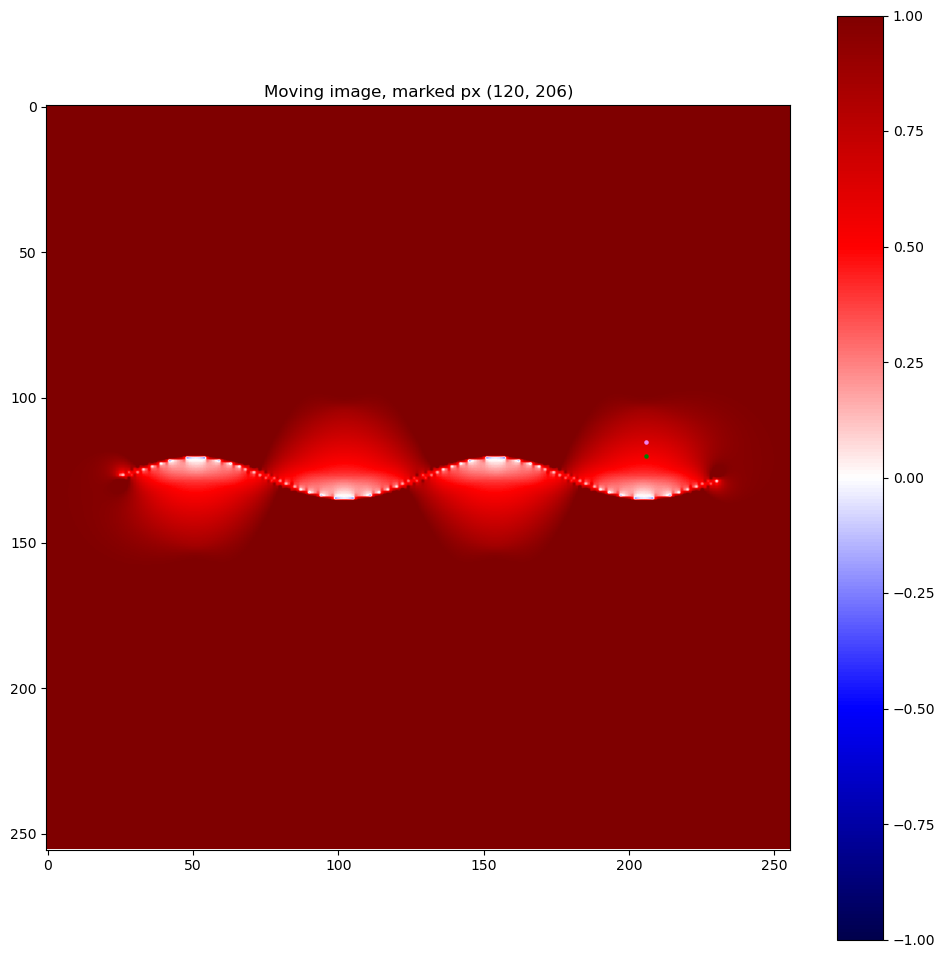

In [19]:
def show(d, px, figsize: tuple = (10, 5), fontsize: int = 6, show_text=True, show_axis=True, show_correspondence=True, show_orientation=False, binarize_negatives=False):
    """Show the deformation field and the Jacobian determinant field.
    
    Args:
        title (str, optional): Title of the plot. Defaults to None.
        figsize (tuple, optional): Size of the plot. Defaults to (10, 5).
        fontsize (int, optional): Font size of the text. Defaults to 6.
        show_text (bool, optional): Whether to show text on the plot. Defaults to True.
        show_axis (bool, optional): Whether to show the normalized axis text or use the default. Defaults to True.
    """
    #norm = mcolors.TwoSlopeNorm(vmin=min(self.jdet_field.min(), -1), vcenter=0, vmax=self.jdet_field.max())
    norm = mcolors.TwoSlopeNorm(vmin=-1, vcenter=0, vmax=1)
    
    jdet_field = d.jdet_field.copy()
    
    #if binarize_negatives:
    #    jdet_field[jdet_field < 0] = -1
    #    jdet_field[jdet_field > 0] = 1  # Clip values to [-1, 1] for better visualization

    f = plt.figure(figsize=figsize)
    plt.imshow(jdet_field, cmap="seismic", norm=norm)
    plt.colorbar()
    
    plt.scatter(px[1], px[0], c='green', s=5)
    plt.scatter(px[1] + d.deformation[2, 0, px[0], px[1]], px[0] + d.deformation[1, 0, px[0], px[1]], c='violet', s=5)
    plt.title(f"Moving image, marked px {px}")
    plt.show()
    f.clear()
    plt.close(f)
    
show(d, px=pt, figsize=(12, 12))

In [20]:
# Find the index of the row in an array where the values match (0, 120, 206)
def find_index(arr, values):
    """
    arr: np.ndarray of shape (N, 3)
    values: tuple or list of 3 values to match
    Returns: index or -1 if not found
    """
    matches = np.where(np.all(arr == values, axis=1))[0]
    return matches[0] if len(matches) > 0 else -1

# Example usage:
idx = find_index(helix_wave1, (0, 120, 206))
print("Index of (0, 120, 206):", idx)

print(helix_wave1[181])
print(helix_wave2[181])

#print(helix_wave1)

Index of (0, 120, 206): 181
[  0 120 206]
[  0 136 206]


### Down first

Down indices then up indices


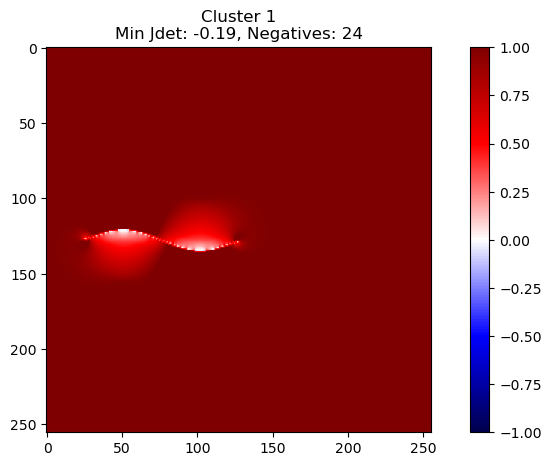

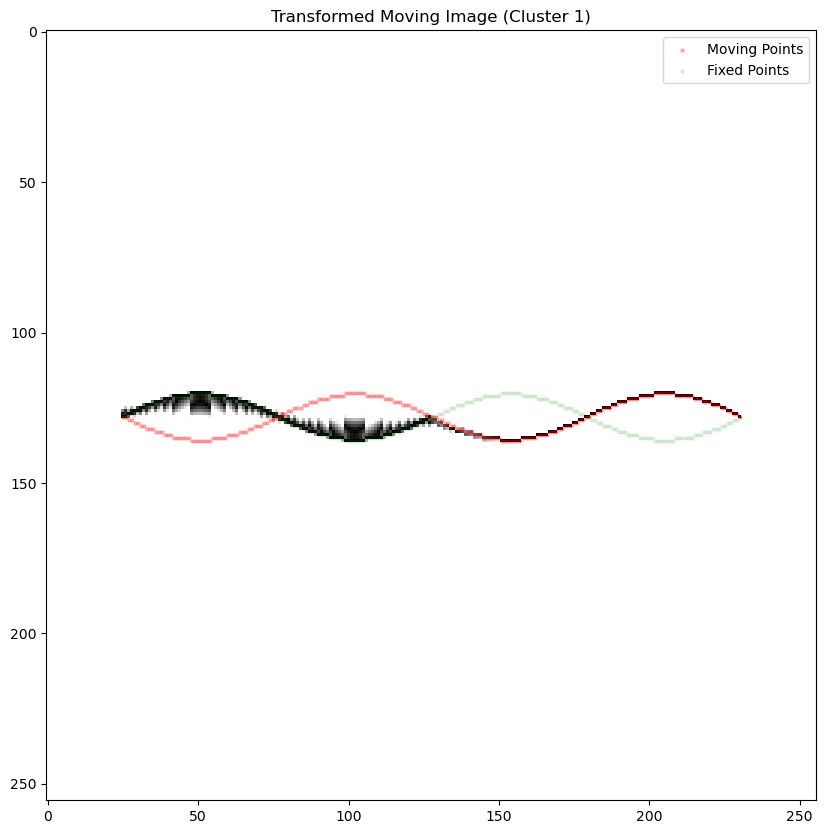

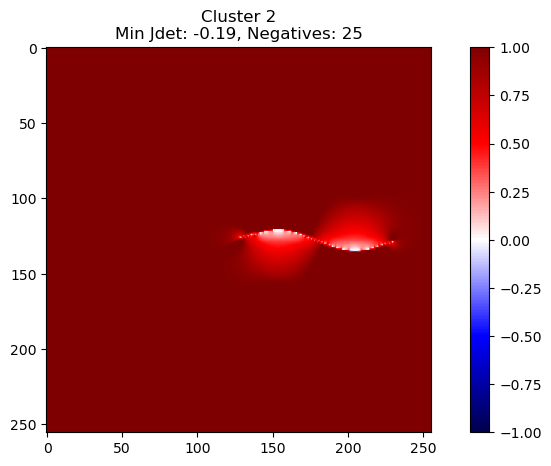

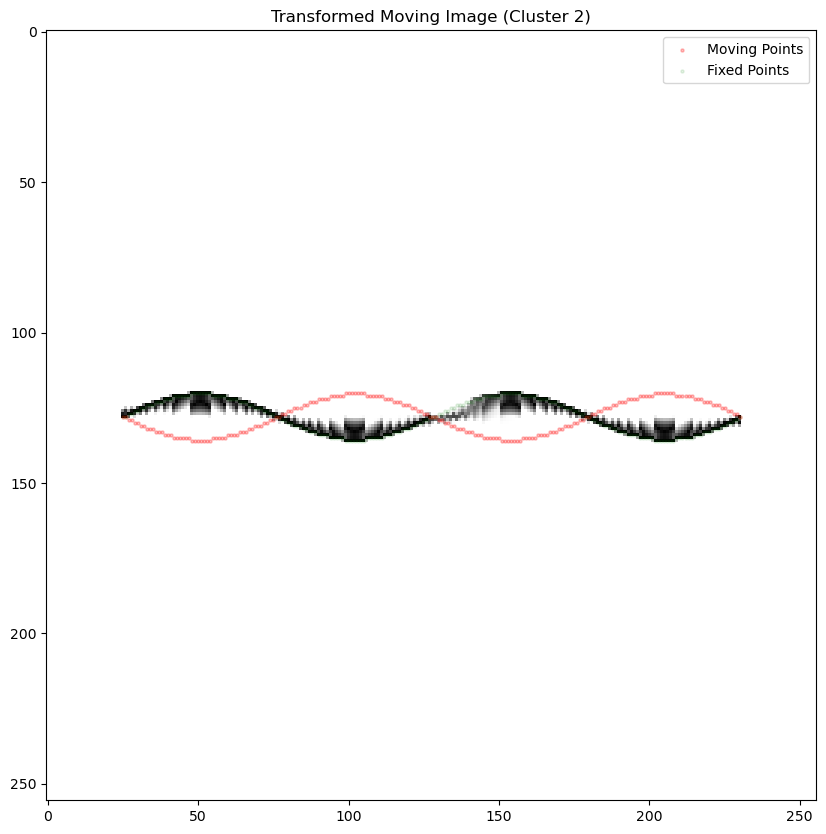

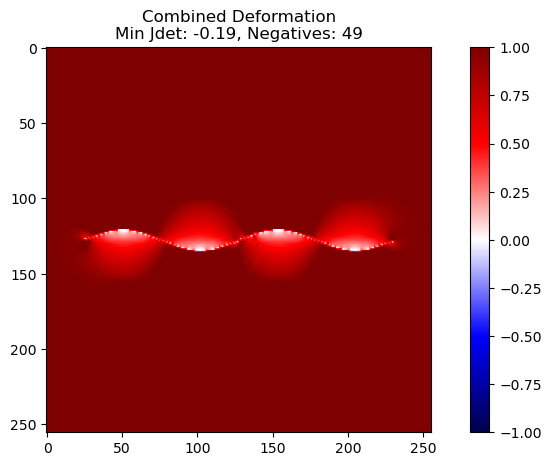

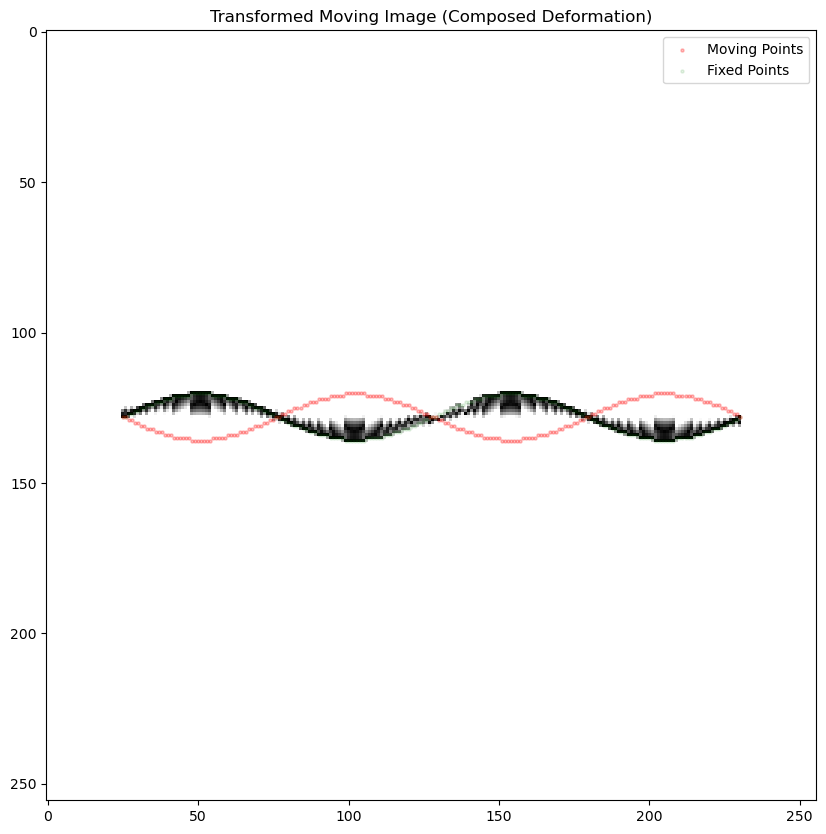

L2 difference between iteration 2 and composed deformation: 4.1245513
fdata.shape (1, 256, 256)
Time taken to create A:  0.07007837295532227
||Ax̂ - b|| for cluster-based deformation: 6.41
L2 error between original deformation and cluster-based deformation: 13.70
Mean error at correspondences: 13.460764124621075


In [21]:
print("Down indices then up indices")
d_result = cluster_laplacian(helix_wave1, helix_wave2, resolution, [down_indices, up_indices], moving_img)
_, _, _, total_err = reg_utils.compute_error_fixed(d_result.resolution, helix_wave1, helix_wave2, d_result.deformation)
print(f"||Ax̂ - b|| for cluster-based deformation: {total_err:.2f}")
print(f"L2 error between original deformation and cluster-based deformation: {np.linalg.norm(d_original.deformation - d_result.deformation):.2f}")
errors = reg_utils.correspondence_error(d_result.deformation, helix_wave1, helix_wave2)
print("Mean error at correspondences:", np.mean(errors))
#print("Max error at correspondences:", np.max(errors))

### Up first

Up indices then down indices


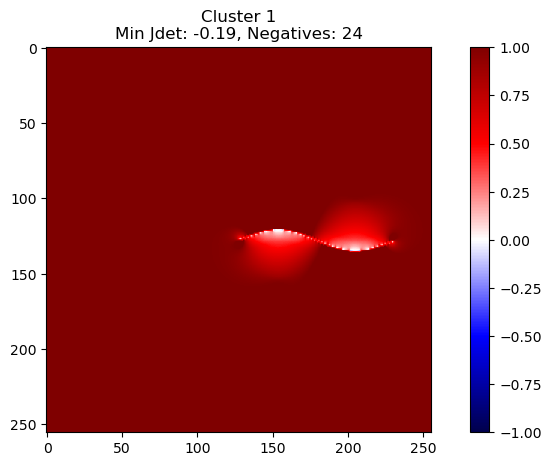

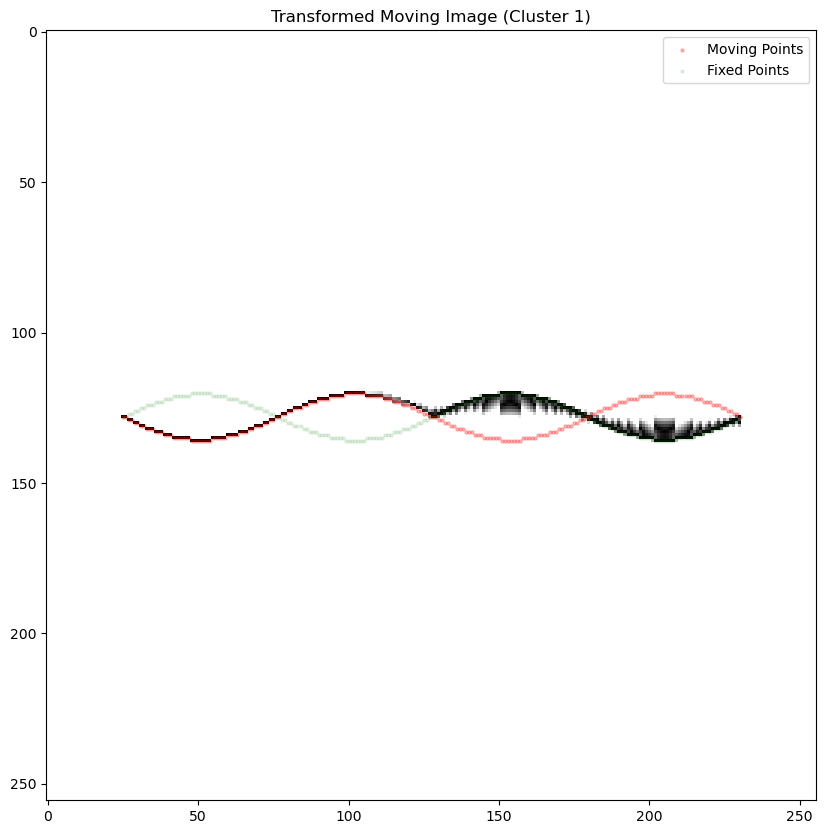

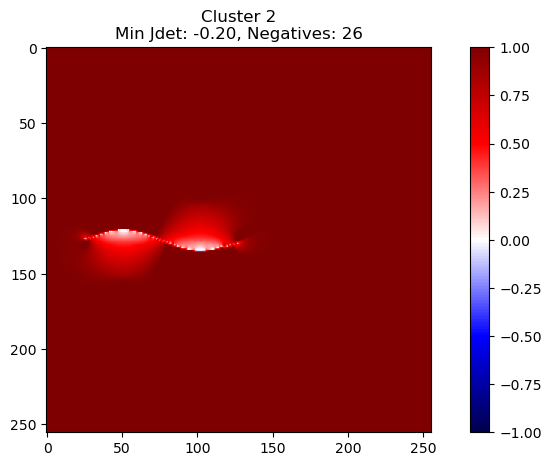

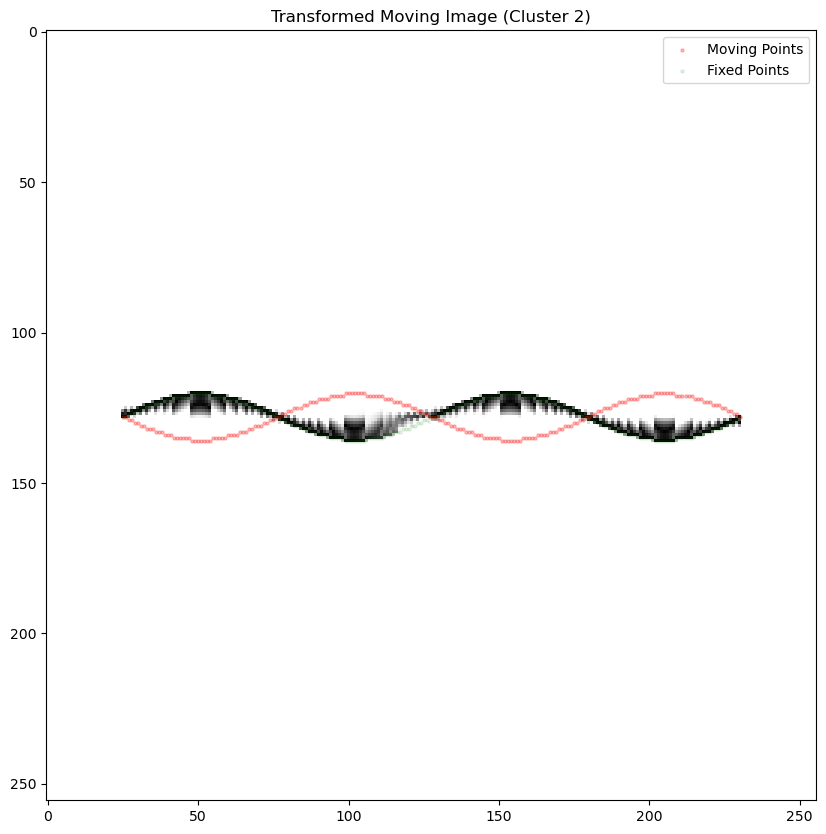

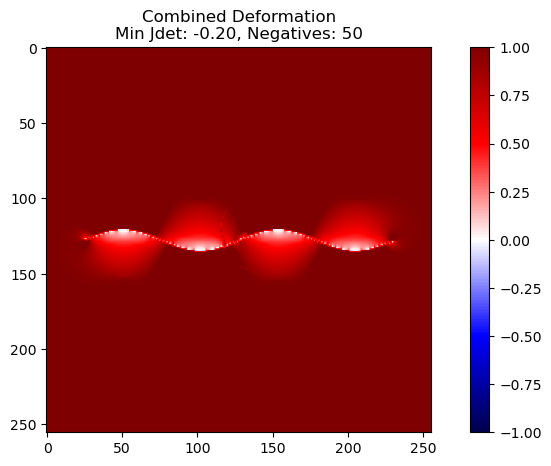

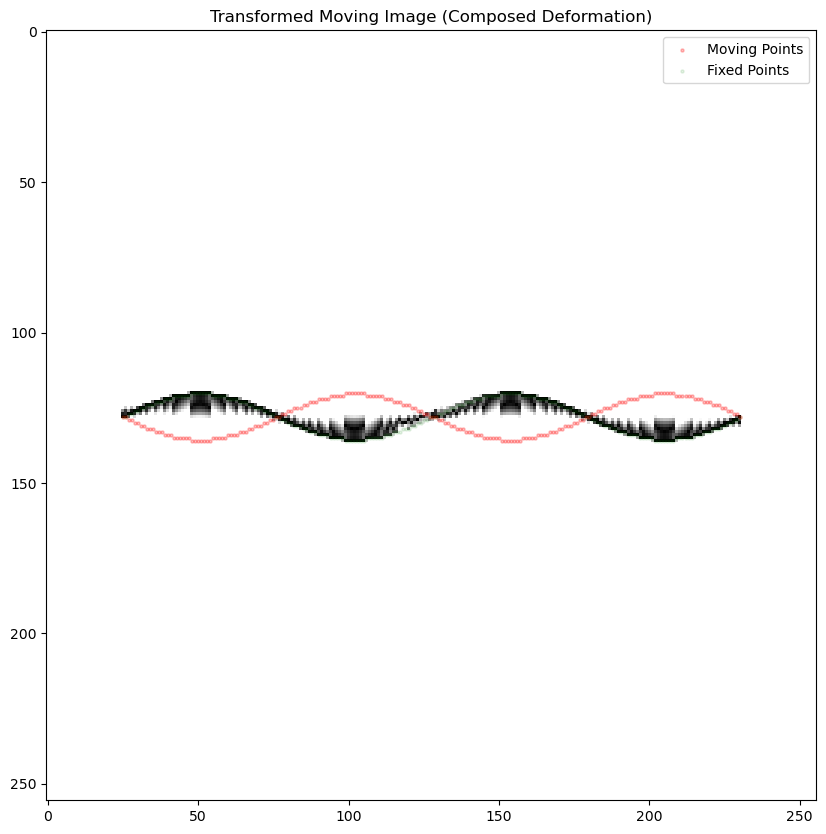

L2 difference between iteration 2 and composed deformation: 4.128187
fdata.shape (1, 256, 256)
Time taken to create A:  0.06357192993164062
||Ax̂ - b|| for cluster-based deformation: 6.83
L2 error between original deformation and cluster-based deformation: 11.39
Mean error at correspondences: 13.422537239923182


In [22]:
print("Up indices then down indices")
d_result = cluster_laplacian(helix_wave1, helix_wave2, resolution, [up_indices, down_indices], moving_img)
_, _, _, total_err = reg_utils.compute_error_fixed(d_result.resolution, helix_wave1, helix_wave2, d_result.deformation)
print(f"||Ax̂ - b|| for cluster-based deformation: {total_err:.2f}")
print(f"L2 error between original deformation and cluster-based deformation: {np.linalg.norm(d_original.deformation - d_result.deformation):.2f}")
errors = reg_utils.correspondence_error(d_result.deformation, helix_wave1, helix_wave2)
print("Mean error at correspondences:", np.mean(errors))
#print("Max error at correspondences:", np.max(errors))

# Run ANTs

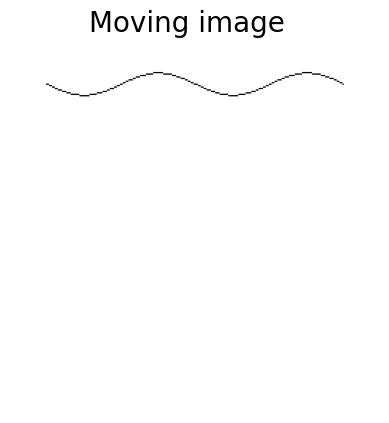

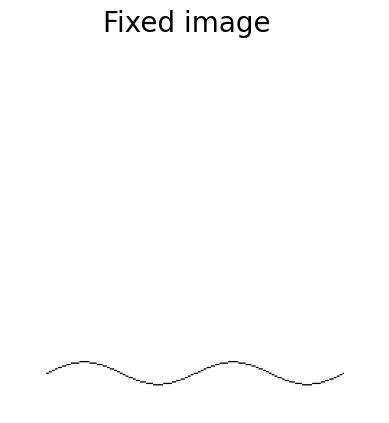

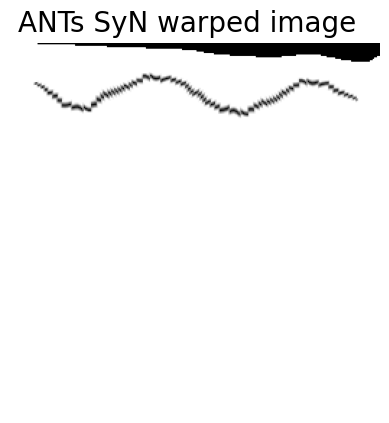

In [97]:
import ants

# Convert numpy arrays to ANTs images
moving_ants = ants.from_numpy(moving_img.T)
fixed_ants = ants.from_numpy(fixed_img.T)

# Perform registration (SyN is typical for nonrigid)
reg = ants.registration(
    fixed=fixed_ants,
    moving=moving_ants,
    type_of_transform='SyN'
)

# Get the warped image
warped_moving = reg['warpedmovout']

# Show result
ants.plot(moving_ants, title='Moving image')
ants.plot(fixed_ants, title='Fixed image')
ants.plot(warped_moving, title='ANTs SyN warped image')

#  Run elastix

In [43]:
import os
import subprocess
import SimpleITK as sitk
import numpy as np
from pathlib import Path

class ElastixWrapper:
    def __init__(self, elastix_path="elastix/elastix.exe", transformix_path="elastix/transformix.exe"):
        """
        elastix_path: Path to elastix binary (e.g., 'C:/elastix/bin/elastix.exe')
        transformix_path: Path to transformix binary
        """
        self.elastix_path = str(elastix_path)
        self.transformix_path = str(transformix_path)

    @staticmethod
    def numpy_to_image(array, path):
        image = sitk.GetImageFromArray(array.astype(np.float32))
        sitk.WriteImage(image, str(path))

    @staticmethod
    def image_to_numpy(path):
        image = sitk.ReadImage(str(path))
        return sitk.GetArrayFromImage(image)

    def register(self, fixed_array, moving_array, param_files, output_dir="elastix_output"):
        """
        Run elastix registration.
        param_files: list of parameter files (e.g., ["rigid.txt", "bspline.txt"])
        """
        os.makedirs(output_dir, exist_ok=True)

        fixed_path = Path(output_dir) / "fixed.nii.gz"
        moving_path = Path(output_dir) / "moving.nii.gz"

        self.numpy_to_image(fixed_array, fixed_path)
        self.numpy_to_image(moving_array, moving_path)

        # Build command
        command = [
            self.elastix_path,
            "-f", str(fixed_path),
            "-m", str(moving_path),
            "-out", str(output_dir)
        ]

        for p in param_files:
            command += ["-p", str(p)]

        print("[INFO] Running:", " ".join(command))
        subprocess.run(command, check=True)

        result_path = Path(output_dir) / "result.0.nii.gz"
        return self.image_to_numpy(result_path)

    def get_deformation_field(self, output_dir="elastix_output"):
        transform_path = Path(output_dir) / "TransformParameters.1.txt"
        
        # Get grid info from fixed image
        fixed_img = sitk.ReadImage(Path(output_dir) / "fixed.nii.gz")
        size = fixed_img.GetSize()
        spacing = fixed_img.GetSpacing()

        # Inject spacing/size/origin if not already in transform file
        with open(transform_path, "r") as f:
            lines = f.readlines()

        def has_tag(tag): return any(tag in line for line in lines)

        # Make sure required fields exist
        if not has_tag("(Size"):
            lines.append(f'(Size {" ".join(str(i) for i in size)})\n')
        if not has_tag("(Spacing"):
            lines.append(f'(Spacing {" ".join(str(s) for s in spacing)})\n')
        if not has_tag("(Origin"):
            origin = fixed_img.GetOrigin()
            lines.append(f'(Origin {" ".join(str(o) for o in origin)})\n')
        if not has_tag("(ComputeDeformationField"):
            lines.append('(ComputeDeformationField "true")\n')

        # Save modified transform file
        with open(transform_path, "w") as f:
            f.writelines(lines)

        # Run transformix
        command = [
            self.transformix_path,
            "-def", "all",
            "-out", str(output_dir),
            "-tp", str(transform_path)
        ]
        print("[INFO] Running:", " ".join(command))
        result = subprocess.run(command, stdout=subprocess.PIPE, stderr=subprocess.STDOUT, text=True)
        print(result.stdout)

        # Load result
        deformation_field = Path(output_dir) / "deformationField.mhd"
        if not deformation_field.exists():
            raise FileNotFoundError("Transformix did not generate deformationField.mhd")

        return self.image_to_numpy(deformation_field)



    def apply_transform(self, array, output_dir="elastix_output", result_name="warped.nii.gz"):
        """
        Warp another image using the computed transformation.
        """
        os.makedirs(output_dir, exist_ok=True)
        moving_path = Path(output_dir) / "temp_moving.nii.gz"
        self.numpy_to_image(array, moving_path)

        command = [
            self.transformix_path,
            "-in", str(moving_path),
            "-out", str(output_dir),
            "-tp", str(Path(output_dir) / "TransformParameters.1.txt")
        ]
        print("[INFO] Running:", " ".join(command))
        result = subprocess.run(command, check=True, stdout=subprocess.PIPE, stderr=subprocess.STDOUT, text=True)
        print(result.stdout)

        result_path = Path(output_dir) / "result.nii.gz"
        return self.image_to_numpy(result_path)


In [44]:
# Assume fixed_np and moving_np are your NumPy arrays
fixed_np = fixed_img.copy()
moving_np = moving_img.copy()

# Create wrapper
elx = ElastixWrapper()

import glob

param_files = sorted(glob.glob("elx_out/TransformParameters.*.txt"))
print("Transform files found:", param_files)


# Register images
result = elx.register(
    fixed_array=fixed_np,
    moving_array=moving_np,
    param_files=["001_parameters_Rigid.txt", "002_parameters_BSpline.txt"],
    output_dir="elx_out"
)

np.save("registered.npy", result)

# Get deformation field
#deformation = elx.get_deformation_field("elx_out")
#np.save("deformation.npy", deformation)

# Warp another image using computed transform
#other_moving = np.load("moving_modality.npy")
#warped_other = elx.apply_transform(other_moving, "elx_out")
#np.save("warped_other.npy", warped_other)



Transform files found: ['elx_out\\TransformParameters.0.txt', 'elx_out\\TransformParameters.1.txt']
[INFO] Running: elastix/elastix.exe -f elx_out\fixed.nii.gz -m elx_out\moving.nii.gz -out elx_out -p 001_parameters_Rigid.txt -p 002_parameters_BSpline.txt


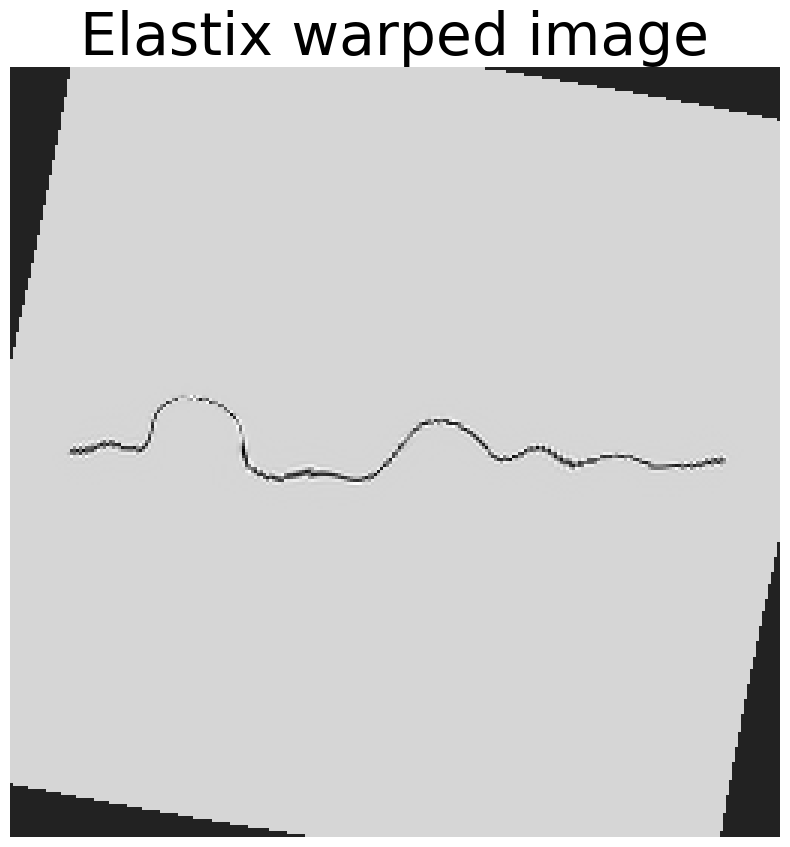

In [45]:
# Visualize result
import matplotlib.pyplot as plt
import nibabel as nib
reg_result = nib.load("elx_out/result.1.nii").get_fdata()
plt.figure(figsize=(10, 10))
plt.imshow(reg_result.T, cmap='gray')
plt.axis('off')
plt.title('Elastix warped image', fontsize=42)
plt.show()

# Laplacian upscaling

When we have jacobian det >1, give it more weighting

Fixed image mapping: increase resolution 3x bigger

For all the known original pixels assign the backward mapping, the corresponding points

Interpolate these correspondences throughout the images to include all the new pixels that we introduced because of upscaling. 

Wherever we upscale the interpolation, wherever we have a group of > 1 jacobians in the original pixels, find the round-off interpolated value, then go back to the corresponding pixel in the other space. (if increasing by 3, then 0.33, 0.66 in that other resolution). 

136, 137 is above jacobian, we look for 4 adjacent pixels above 1 jacobian

When interpolating we see that interpolating corresponding

136 -> 120

137 -> 122.4

Interpolating between 120 122,4 and assigning to 136.3 and 136.66

In the original image, we see which interpolated value is closest, see what is its value, 

120.8 -> 121, 136.33 -> 136

Do the same thing for moving image. 

Make sure two pixels do not map to the same point.

In [2]:
import numpy as np
from scipy.ndimage import zoom


def get_point_info(dvf, pt, scale=1):
    """
    Get the current point's deformation and Jdet information.
    Args:
        d_original: Data object containing the deformation field and Jdet field.
        pt: Tuple (y, x) coordinates of the point in the image.
    Returns:
        current_jdet: Jacobian determinant at the current point.
        current: Deformation vector at the current point.
        down: Deformation vector at the point below.
        up: Deformation vector at the point above.
        left: Deformation vector at the point to the left.
        right: Deformation vector at the point to the right.
    """
    pt = np.array(pt)
    current_jdet = jacobian.sitk_jacobian_determinant(dvf)[0][pt[0], pt[1]]
    current = dvf[:, 0, pt[0], pt[1]]
    down = dvf[:, 0, pt[0]-1, pt[1]]
    up = dvf[:, 0, pt[0]+1, pt[1]]
    left = dvf[:, 0, pt[0], pt[1]-1]
    right = dvf[:, 0, pt[0], pt[1]+1]

    print("Mapping in fixed space:")
    print(f"Current point: {np.array(pt) / scale}")
    print("Mapped point:", np.array((pt[0] / scale + current[1], pt[1] / scale + current[2])))
    print("Jdet:", current_jdet)

    print("Current displacement:", current)
    #print("\tDown:", down)
    #print("\tUp:", up)
    #print("\tLeft:", left)
    #print("\tRight:", right)
    print()


def upscale_dvf_preserve(dvf, scale=3):
    """
    Upscales a DVF (3, 1, H, W) by a factor with linear interpolation.
    Ensures original values at original locations are preserved.

    Parameters:
        dvf (np.ndarray): Deformation vector field of shape (3, 1, H, W)
        scale (int): Upscaling factor (e.g., 3)

    Returns:
        np.ndarray: Upscaled DVF of shape (3, 1, scale*H, scale*W)
    """
    z, c, H, W = dvf.shape
    # Linearly interpolate entire DVF
    dvf_up = zoom(dvf, zoom=(1, 1, scale, scale), order=1)

    # Replace exact original points at the scaled locations (0, scale, 2*scale, ...)
    for y in range(H):
        for x in range(W):
            y_up = y * scale
            x_up = x * scale
            dvf_up[:, 0, y_up, x_up] = dvf[:, 0, y, x]

    return dvf_up


def upscale_dvf_linear_y(dvf, scale=3):
    """
    Upscale a DVF (3, 1, H, W) by a factor, using strict linear interpolation in y-direction.
    Only works if displacements are only in y (i.e., dvf[2, ...] == 0).
    """
    z, c, H, W = dvf.shape
    up_H, up_W = H * scale, W * scale
    dvf_up = np.zeros((z, c, up_H, up_W), dtype=dvf.dtype)

    for x in range(W):
        for y in range(H - 1):
            # Original displacements at y and y+1
            v0 = dvf[:, 0, y, x]
            v1 = dvf[:, 0, y + 1, x]
            for s in range(scale):
                alpha = s / scale
                interp = (1 - alpha) * v0 + alpha * v1
                dvf_up[:, 0, y * scale + s, x * scale] = interp
        # Last point: just copy
        dvf_up[:, 0, (H - 1) * scale, x * scale] = dvf[:, 0, H - 1, x]

    # Optionally, fill in x-direction by copying (if you want a column to be constant)
    for x in range(W):
        for y in range(up_H):
            for s in range(1, scale):
                dvf_up[:, 0, y, x * scale + s] = dvf_up[:, 0, y, x * scale]

    return dvf_up


def get_expanding_coordinates(jdet_field, threshold=1, verbose=True):
    """
    Get the coordinates of expanding Jacobian determinants in the grid.
    
    Args:
        show (bool): Whether to print the coordinates of the expanding Jacobian determinants.
        
    Returns:
        np.ndarray: Array of coordinates of expanding Jacobian determinants.
    """
    # Get coordinate of expanding Jacobian determinants
    found_indices = np.argwhere(jdet_field > threshold)
    if verbose:
        print("Expanding Jacobian determinants:")
        for y, x in found_indices:
            print(f"({y}, {x})")
    print(f"Found {len(found_indices)} expanding Jacobian determinants with threshold {threshold}.")
    return found_indices


def get_contracting_coordinates(jdet_field, threshold=1, verbose=True):
    """
    Get the coordinates of contracting Jacobian determinants in the grid.
    
    Args:
        show (bool): Whether to print the coordinates of the contracting Jacobian determinants.
        
    Returns:
        np.ndarray: Array of coordinates of expanding contracting determinants.
    """
    # Get coordinate of expanding Jacobian determinants
    found_indices = np.argwhere(jdet_field < threshold)
    if verbose:
        print("Contracting Jacobian determinants:")
        for y, x in found_indices:
            print(f"({y}, {x})")
    print(f"Found {len(found_indices)} contracting Jacobian determinants with threshold {threshold}.")
    return found_indices


def get_mapped_point(pt, dvf):
    """
    Get the mapped point in the fixed space given a point in the moving space and a deformation vector field.
    
    Args:
        pt (tuple): Coordinates of the point in the moving space (y, x).
        dvf (np.ndarray): Deformation vector field of shape (3, 1, H, W).
        
    Returns:
        tuple: Mapped coordinates in the fixed space.
    """
    if len(pt) == 2:
        y, x = pt
    elif len(pt) == 3:
        y, x = pt[1], pt[2]
        
    mapped_y = y + dvf[1, 0, y, x]
    mapped_x = x + dvf[2, 0, y, x]
    return np.array((mapped_y, mapped_x))


def get_displacement(pt, dvf):
    """
    Get the displacement vector at a point in the moving space.
    
    Args:
        pt (tuple): Coordinates of the point in the moving space (y, x).
        dvf (np.ndarray): Deformation vector field of shape (3, 1, H, W).
        
    Returns:
        np.ndarray: Displacement vector at the point.
    """
    if len(pt) == 2:
        y, x = pt
    elif len(pt) == 3:
        y, x = pt[1], pt[2]
        
    return dvf[:, 0, y, x]


def jacobian_plot(d, pt=None, figsize=(10, 5), title=None, 
                  xlim=None, ylim=None, 
                  binarize_negatives=False,
                  moving_pts=None, fixed_pts=None):
    """
    Plot the Jacobian determinant field.
    Args:
        d: Data object containing the deformation field and Jdet field.
        figsize: Size of the plot.
        title: Title of the plot.
    """
    jdet_field = d.jdet_field.copy()

    if binarize_negatives:
        jdet_field[jdet_field < 0] = -1
        #jdet_field[jdet_field > 0] = 1
        
    norm = mcolors.TwoSlopeNorm(vmin=jdet_field.min(), vcenter=0, vmax=1)
        
    plt.figure(figsize=figsize)
    plt.imshow(jdet_field, cmap='seismic', norm=norm)
    #plt.colorbar()
    
    # Show Jdet value at all pixels in xlim and ylim
    if xlim is not None and ylim is not None:
        for y in range(ylim[0] + 1, ylim[1]):
            for x in range(xlim[0] + 1, xlim[1]):
                # If negative, show in red bold
                if jdet_field[y, x] < 0:
                    # Font size 20 default
                    plt.text(x, y, f"{d.jdet_field[y, x]:.2f}", fontsize=20, ha='center', va='center', color='red', fontweight='bold')
                else:
                    plt.text(x, y, f"{d.jdet_field[y, x]:.2f}", fontsize=20, ha='center', va='center', color='black')

    if pt is not None:
        plt.scatter(pt[1], pt[0], c='green', s=20)
        plt.scatter(pt[1] + d.deformation[2, 0, pt[0], pt[1]], 
                    pt[0] + d.deformation[1, 0, pt[0], pt[1]], 
                    c='violet', s=20)
        plt.title(f"Moving image, marked px {pt}")
    else:
        plt.title("Jacobian Determinant Field")
    if title:
        plt.title(title, fontsize=30)
    if xlim:
        plt.xlim(xlim)
        #plt.xticks(ticks=np.arange(xlim[0], xlim[1], 1), labels=np.arange(xlim[0], xlim[1], 1))
    if ylim:
        plt.ylim(ylim)
        #plt.yticks(ticks=np.arange(ylim[0], ylim[1], 1), labels=np.arange(ylim[0], ylim[1], 1))
        
    if moving_pts is not None:
        plt.scatter(moving_pts[:, 2], moving_pts[:, 1], c='green', s=10, label='Moving Points')
    if fixed_pts is not None:
        plt.scatter(fixed_pts[:, 2], fixed_pts[:, 1], c='violet', s=10, label='Fixed Points')
        
    # Make aspect ratio square
    #plt.gca().set_aspect('equal', adjustable='box')
    #plt.grid(True, which='both', linestyle='--', linewidth=0.25)
    plt.xticks([])
    plt.yticks([])
    plt.gca().invert_yaxis()
    
    plt.show()

## Fixed space

In [12]:
import nibabel as nib

mdata_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fdata_path = "data/corrected_correspondences_count_touching/fpoints.npy"
brain_img_path = "data/corrected_correspondences_count_touching/registered_output/elastixRefined.nii.gz"
annotation_path = "data/CCF_DATA/annotation_25.nii.gz"
CURR_IDX = 500


# Load the annotation and average images
mdata = np.load(mdata_path)
fdata = np.load(fdata_path)
brain_img = nib.load(brain_img_path).get_fdata()[CURR_IDX, :, :]
annotation_img = nib.load(annotation_path).get_fdata()[CURR_IDX, :, :]  # Get the specific z slice

# Get only elements that are of the current index
mdata = mdata[mdata[:, 0] == CURR_IDX]
fdata = fdata[fdata[:, 0] == CURR_IDX]
mdata[:, 0] = 0
fdata[:, 0] = 0

# Get every N points
N = 3  # 3 for 350, 2 otherwise
mdata = mdata[::N]
fdata = fdata[::N]
#resolution = np.zeros((1, 320, 456))


=== Creating Double Helix for Point Correspondence ===
Created double helix with 206 points per wave
Grid size: 256x256
Padding: 25 pixels on each side
Number of cycles: 2
Phase offset: 3.142 radians (180.0 degrees)
Wave 1 - X range: [25, 230], Y range: [120, 136]
Wave 2 - X range: [25, 230], Y range: [120, 136]
Number of intersection points: 10


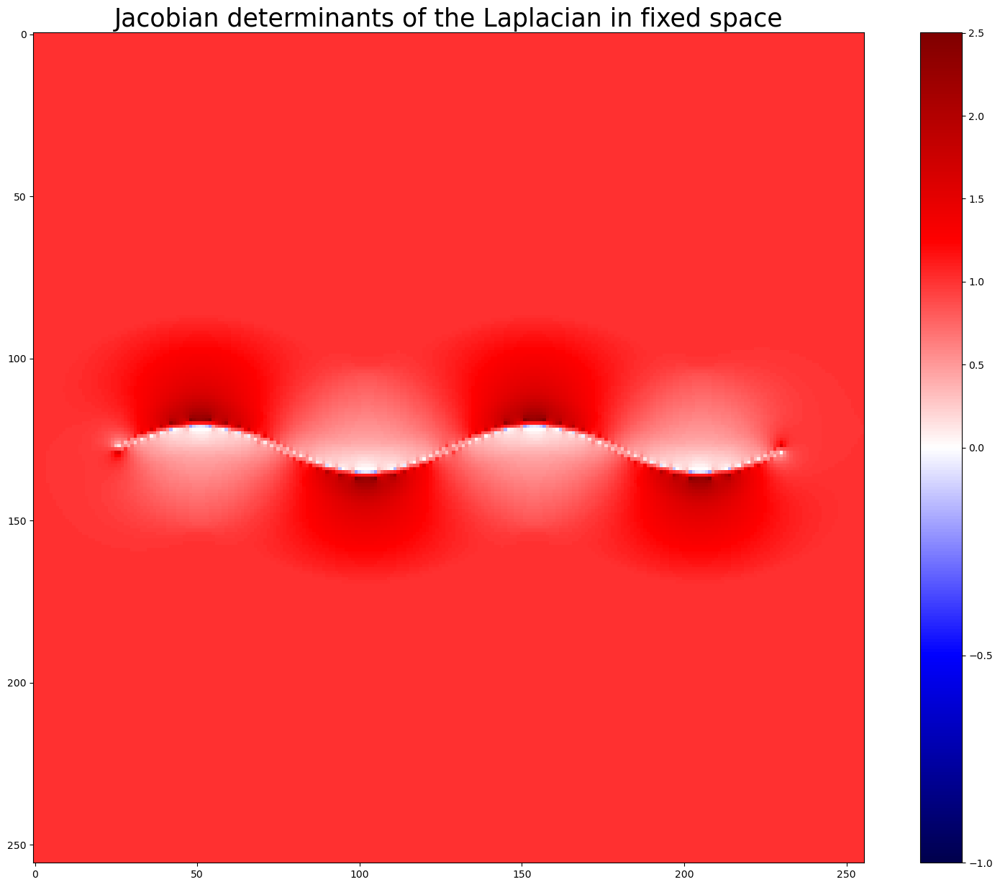

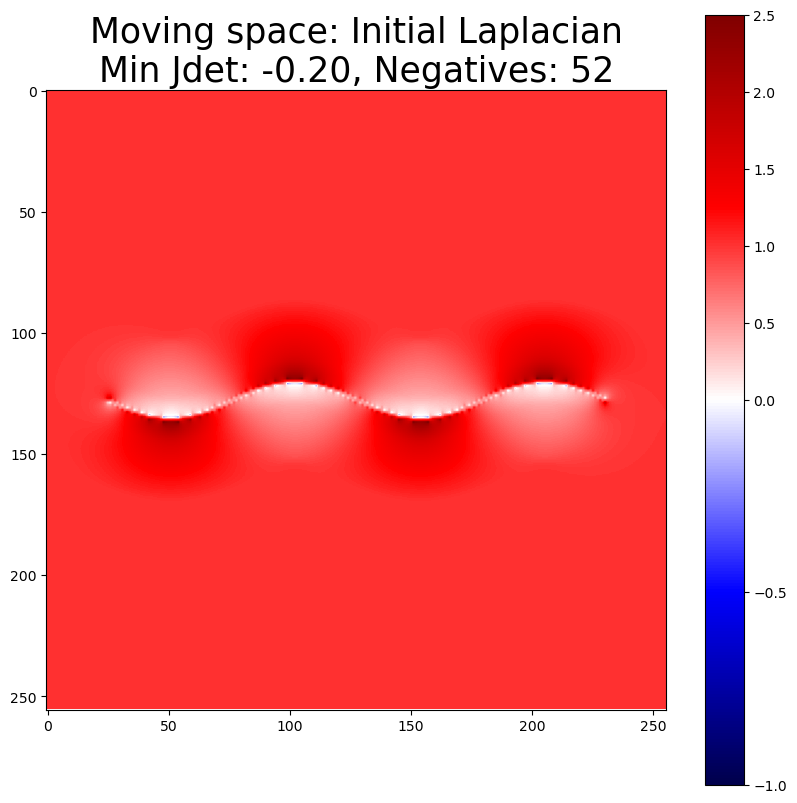

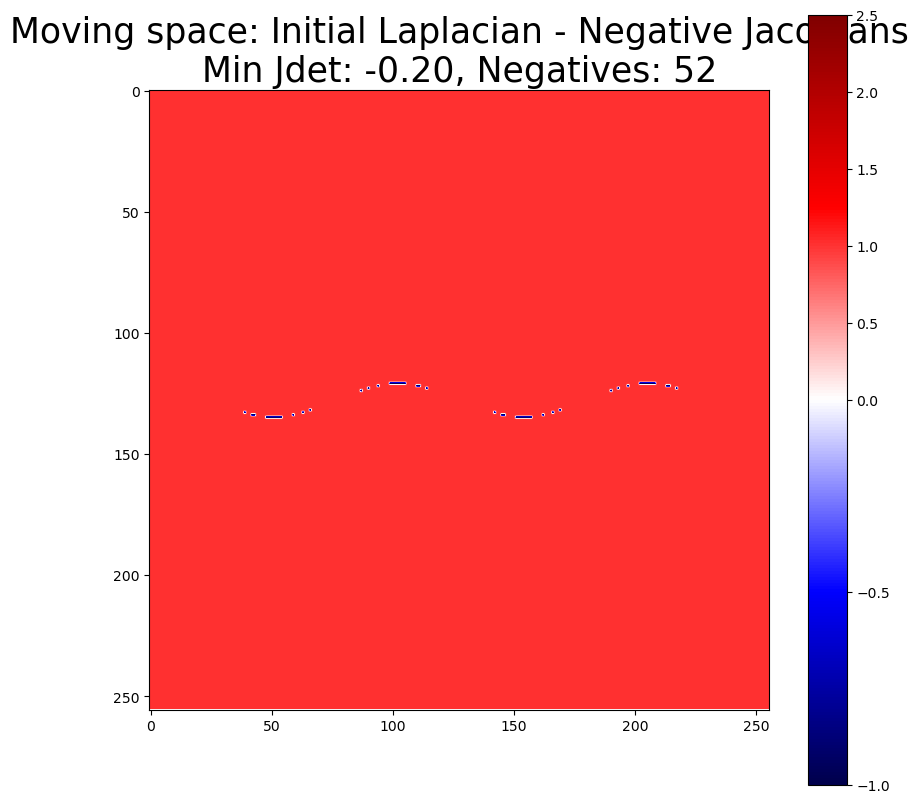

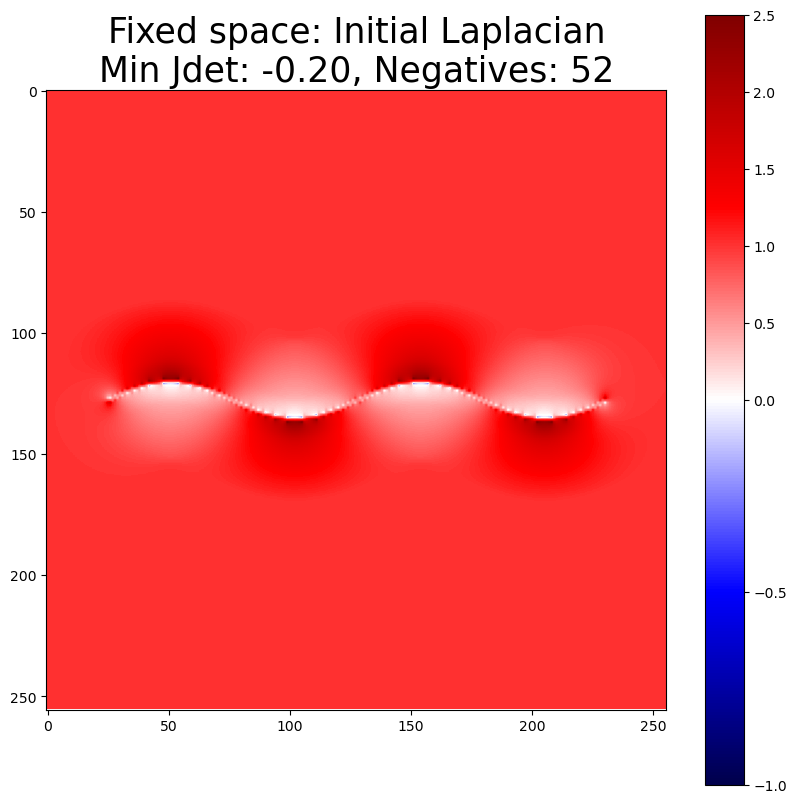

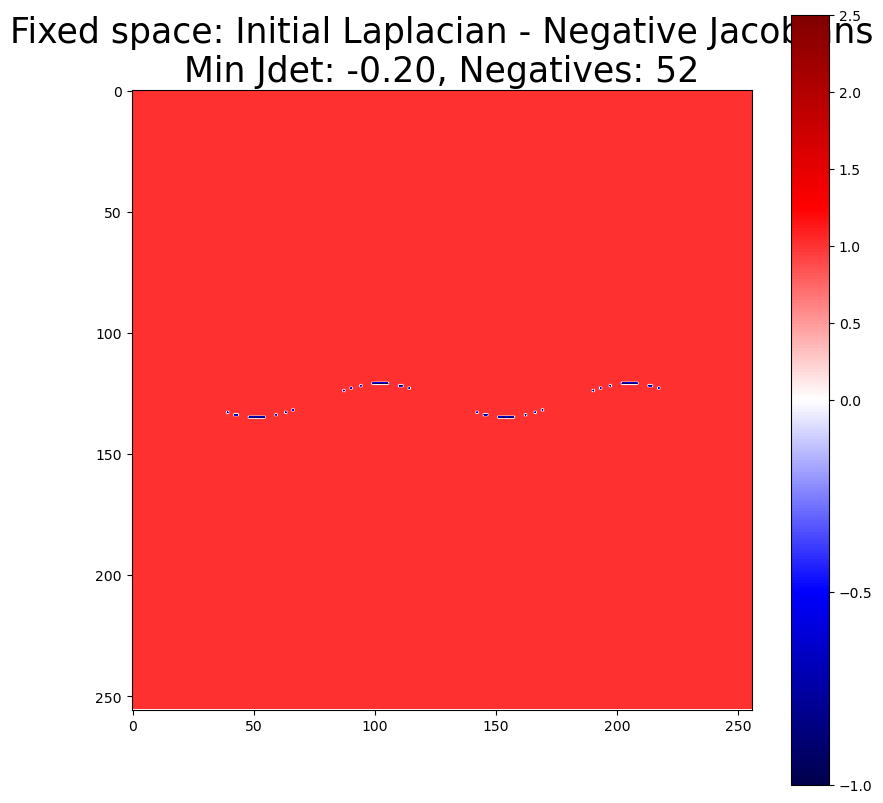

Found 96 expanding Jacobian determinants with threshold 2.0.

New fixed points shape: (96, 3)
New moving points shape: (96, 3)
Cleaned new fixed points shape: (96, 3)
Cleaned new moving points shape: (96, 3)


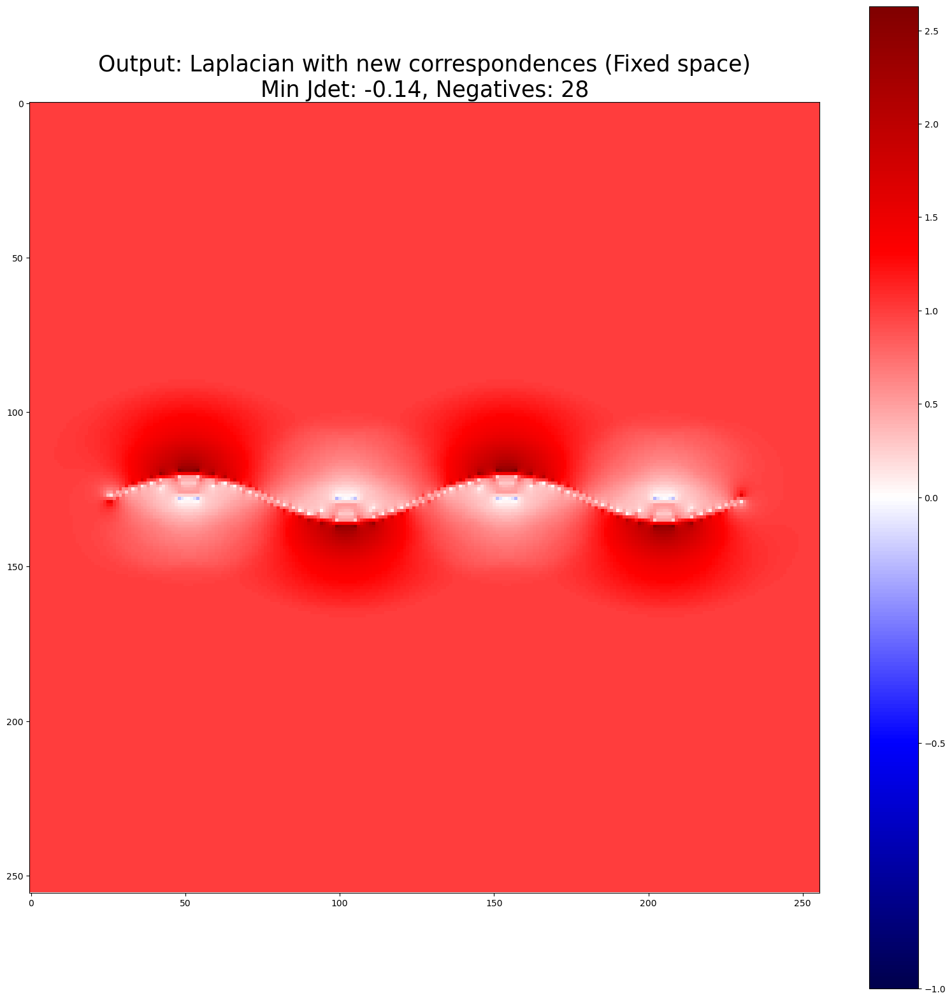

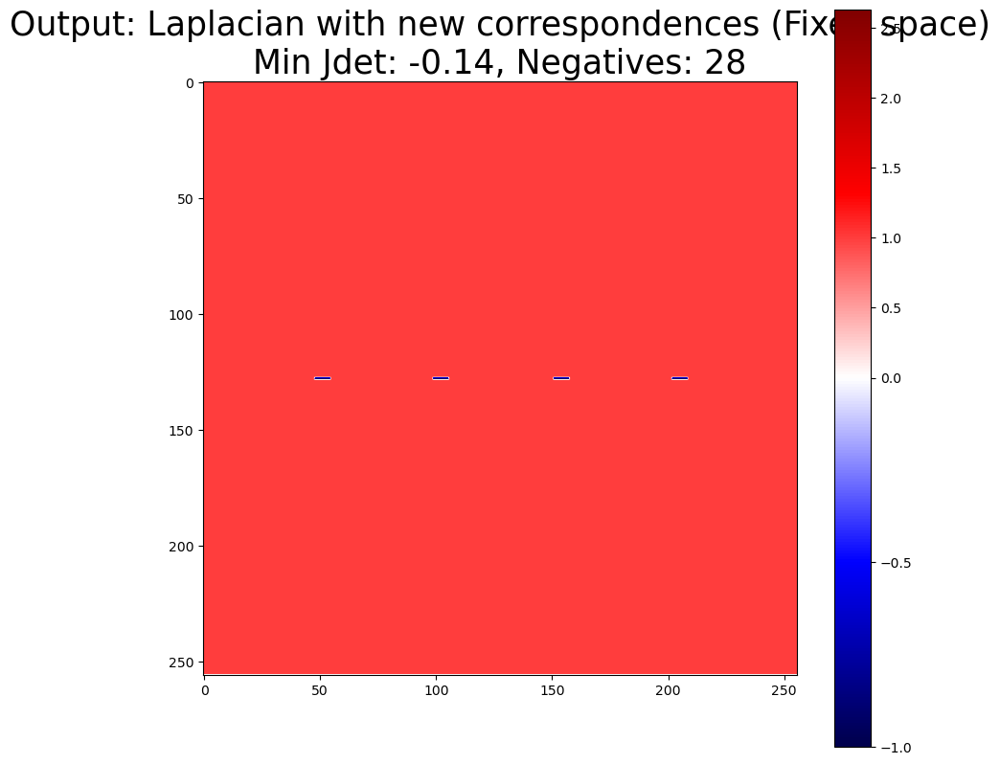

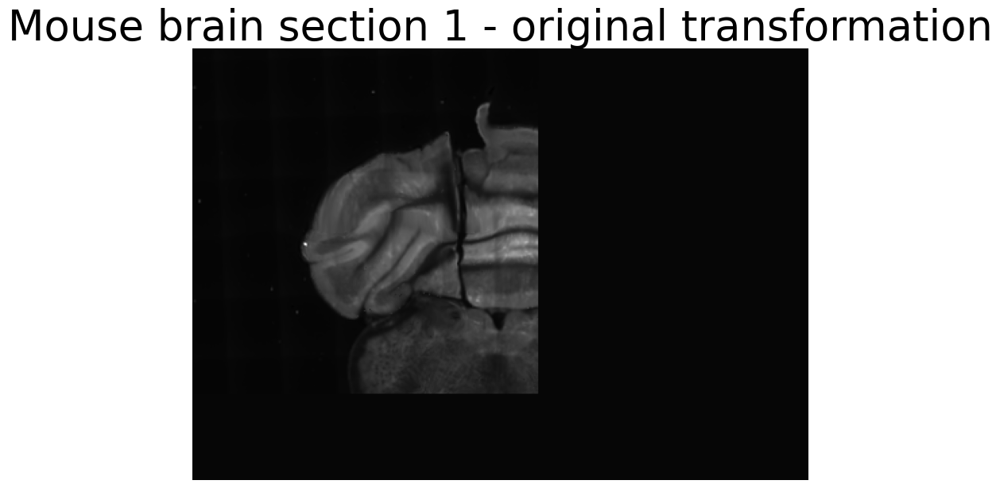

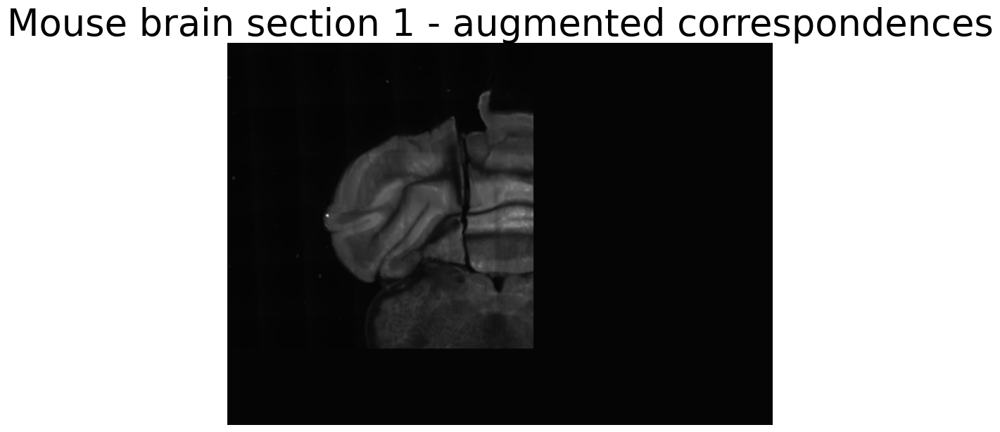

In [13]:
scale = 3
jdet_threshold = 2.0
verbose = False
resolution = (256, 256)
# Remove point pairs where the distance between new_mpoints and new_fpoints is above a threshold
magnitude_thresh = 9999  # 100 elsewhere
plot_points = True


# Create a specific double helix for correspondence analysis
print("\n=== Creating Double Helix for Point Correspondence ===")
mpoints, fpoints, _ = data_utils.create_double_helix_waves(
    grid_size=256,
    num_cycles=2,
    amplitude_ratio=0.03,
    phase_offset=np.pi,  # 180 degrees for maximum separation
    padding_ratio=0.1,
    plot=False, horizontal=False,  # Set horizontal to False for vertical helix
)

mpoints = mpoints[:, [1, 0]]  # Swap to (y, x) format
fpoints = fpoints[:, [1, 0]]  # Swap to (y, x) format 

# Add 0s on the first axis to format for Data class
mpoints = np.pad(mpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)
fpoints = np.pad(fpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)

#mpoints = mdata
#fpoints = fdata

d_fixed = Data(mpoints, fpoints, resolution)
#d_moving = np.load("d_moving.npy", allow_pickle=True).item()
#d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 15),
#       title=f"Jacobian determinants of the Laplacian in moving space")
d_moving = Data_Moving(mpoints, fpoints, resolution)

upscaled_fixed = upscale_dvf_preserve(d_fixed.deformation, scale=scale)
upscaled_moving = upscale_dvf_preserve(d_moving.deformation, scale=scale)

d_fixed.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 15), binarize_negatives=False,
       title=f"Jacobian determinants of the Laplacian in fixed space")


d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Moving space: Initial Laplacian\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
       title=f"Moving space: Initial Laplacian - Negative Jacobians\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

d_fixed.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Fixed space: Initial Laplacian\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
       title=f"Fixed space: Initial Laplacian - Negative Jacobians\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")


########### EDIT:  DO IT IN MOVING SPACE ###########
#d_fixed = d_moving


expanding_coord = get_expanding_coordinates(d_moving.jdet_field, threshold=jdet_threshold, verbose=False)
# Remove points that occur in the fixed points set
expanding_coord = np.array([coord for coord in expanding_coord if tuple(coord) not in set(map(tuple, d_moving.fpoints[:, 1:]))])

# For each expanding coordinate, get the adjacent coordinates in the upscaled deformation field
print()

new_mpoints = []
new_fpoints = []
for y, x in expanding_coord:
    # Get the corresponding coordinates in the upscaled deformation field
    y_curr = y * scale
    x_curr = x * scale
    displacement_curr = upscaled_fixed[:, 0, y_curr, x_curr]
    mapped_point_curr = np.array((y + displacement_curr[1], x + displacement_curr[2]))
    
    # Left and right coordinates in the upscaled deformation field
    x_left = x_curr - 1
    x_right = x_curr + 1
    y_up = y_curr - 1
    y_down = y_curr + 1
    
    displacement_left = upscaled_fixed[:, 0, y_curr, x_left]
    displacement_left_1 = upscaled_fixed[:, 0, y_curr, x_left - 1]
    displacement_right = upscaled_fixed[:, 0, y_curr, x_right]
    displacement_right_1 = upscaled_fixed[:, 0, y_curr, x_right + 1]
    displacement_up = upscaled_fixed[:, 0, y_up, x_curr]
    displacement_up_1 = upscaled_fixed[:, 0, y_up - 1, x_curr]
    displacement_down = upscaled_fixed[:, 0, y_down, x_curr]
    displacement_down_1 = upscaled_fixed[:, 0, y_down + 1, x_curr]
    
    mapped_point_left = np.array((y + displacement_left[1], x + displacement_left[2]))
    mapped_point_left_1 = np.array((y + displacement_left_1[1], x + displacement_left_1[2]))
    mapped_point_right = np.array((y + displacement_right[1], x + displacement_right[2]))
    mapped_point_right_1 = np.array((y + displacement_right_1[1], x + displacement_right_1[2]))
    mapped_point_up = np.array((y + displacement_up[1], x + displacement_up[2]))
    mapped_point_up_1 = np.array((y + displacement_up_1[1], x + displacement_up_1[2]))
    mapped_point_up_neighbor = np.array((y - 1 + upscaled_fixed[:, 0, y_curr - 3], x + upscaled_fixed[:, 0, y_curr - 3]))
    mapped_point_down = np.array((y + displacement_down[1], x + displacement_down[2]))
    mapped_point_down_1 = np.array((y + displacement_down_1[1], x + displacement_down_1[2]))
    
    # Print the information
    if verbose:
        print(f"Expanding coordinate ({y}, {x}) in original field corresponds to ({y_curr}, {x_curr}) in upscaled field.")
        print(f"Deformation vector at this point: {displacement_curr}")
        #print(f"Mapped point in moving space: {mapped_point_curr} = {np.round(mapped_point_curr)}")
        
        #print(f"Left point - 2 ({y_curr//scale}, {(x_left-1)/scale:.2f}) -> Mapped: {mapped_point_left_1} = {np.round(mapped_point_left_1)}")
        print(f"Left point - 1 \t({y_curr//scale}, {x_left/scale:.2f}) \t-> Mapped: {mapped_point_left} = {np.round(mapped_point_left)}")
        
        #print(f"Right point + 2 ({y_curr//scale}, {(x_right + 1)/scale:.2f}) -> Mapped: {mapped_point_right_1} = {np.round(mapped_point_right_1)}")
        #print(f"Up neighbor \t({(y_up - 2)//scale}, {x_curr//scale}) \t-> Mapped: {mapped_point_up_neighbor} = {np.round(mapped_point_up_neighbor)}")
        #print(f"Up point - 2 \t({(y_up - 1)/scale:.2f}, {x_curr//scale}) \t-> Mapped: {mapped_point_up_1} = {np.round(mapped_point_up_1)}")
        print(f"Up point - 1 \t({y_up/scale:.2f}, {x_curr//scale}) \t-> Mapped: {mapped_point_up} = {np.round(mapped_point_up)}")
        print(f"Current point \t({y_curr//scale:.2f}, {x_curr//scale}) \t-> Mapped: {mapped_point_curr} = {np.round(mapped_point_curr)}")
        print(f"Down point + 1\t({y_down/scale:.2f}, {x_curr//scale}) \t-> Mapped: {mapped_point_down} = {np.round(mapped_point_down)}")
        print(f"Right point + 1\t({y_curr//scale}, {x_right/scale:.2f}) \t-> Mapped: {mapped_point_right} = {np.round(mapped_point_right)}")
        #print(f"Down point + 2 \t({(y_down + 1)/scale:.2f}, {x_curr//scale}) \t-> Mapped: {mapped_point_down_1} = {np.round(mapped_point_down_1)}")
    
    # Of all of the mapped points, find the mapped point that is closest to an integer coordinate
    mapped_points = [mapped_point_left, mapped_point_right, mapped_point_up, mapped_point_down, mapped_point_curr]
    closest_point = min(mapped_points, key=lambda p: np.linalg.norm(p - np.round(p)))
    if verbose:
        print(f"Closest mapped point to integer coordinate: {closest_point} = {np.round(closest_point)}")
        print()
        print()
        
    #closest_point = np.round(closest_point).astype(int)

    #new_fpoints.append([0, y, x])
    #new_mpoints.append([0, closest_point[0], closest_point[1]])
    
    # Now, moving point is [0, y, x], fixed point is [0, closest_point[0], closest_point[1]]
    new_mpoints.append([0, y, x])
    #new_fpoints.append([0, closest_point[0], closest_point[1]])
    #new_fpoints = [np.round(get_mapped_point(f[1:], d_moving.deformation)).astype(int) for f in new_mpoints]
    # Add zero to the first axis for Data class compatibility
    new_fpoints = [np.concatenate([[0], np.round(get_mapped_point(f[1:], d_moving.deformation)).astype(int)]) for f in new_mpoints]
    
    
    
# Convert to numpy arrays for consistency
new_fpoints = np.array(new_fpoints)
new_mpoints = np.array(new_mpoints)
    
print("New fixed points shape:", new_fpoints.shape)
print("New moving points shape:", new_mpoints.shape)


# Remove duplicates as before
new_fpoints = np.array([fp for fp in new_fpoints if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])
new_mpoints = np.array([mp for mp, fp in zip(new_mpoints, new_fpoints) if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])

new_mpoints = np.array([mp for mp in new_mpoints if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])
new_fpoints = np.array([fp for fp, mp in zip(new_fpoints, new_mpoints) if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])


# Compute distances for each pair
distances = np.linalg.norm(new_mpoints[:, 1:] - new_fpoints[:, 1:], axis=1)

# Create a mask for pairs within the threshold
mask = distances < magnitude_thresh

# Filter both arrays using the mask
new_mpoints = new_mpoints[mask]
new_fpoints = new_fpoints[mask]


# If a new moving point is already in the original mpoints, remove it and its corresponding fixed point
#new_mpoints = np.array([mp for mp in new_mpoints if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])
#new_fpoints = np.array([fp for fp, mp in zip(new_fpoints, new_mpoints) if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])

# If a new fixed point is already in the original fpoints, remove it and its corresponding moving point
#new_fpoints = np.array([fp for fp in new_fpoints if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])
#new_mpoints = np.array([mp for mp, fp in zip(new_mpoints, new_fpoints) if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])  

print("Cleaned new fixed points shape:", new_fpoints.shape)
print("Cleaned new moving points shape:", new_mpoints.shape)

# Add to original set of correspondences
mpoints = np.vstack((mpoints, new_mpoints))
fpoints = np.vstack((fpoints, new_fpoints))

# Create a new Data object with the updated points
d_expanded = Data(mpoints, fpoints, resolution)
d_expanded.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 20), binarize_negatives=False,
       title=f"Output: Laplacian with new correspondences (Fixed space)\nMin Jdet: {d_expanded.min():.2f}, Negatives: {d_expanded.count_negatives()}")
d_expanded.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
       title=f"Output: Laplacian with new correspondences (Fixed space)\nMin Jdet: {d_expanded.min():.2f}, Negatives: {d_expanded.count_negatives()}")




# Save to raw image
moving_img = data_utils.create_raw_image(d_fixed.mpoints, resolution, save_path="wave1.png")
fixed_img = data_utils.create_raw_image(d_fixed.mpoints, resolution, save_path="wave2.png")

original_transformation = reg_utils.apply_transformation_fixed(d_fixed, brain_img, title="Mouse brain section 1 - original transformation")
transformed_img = reg_utils.apply_transformation_fixed(d_expanded, brain_img, title="Mouse brain section 1 - augmented correspondences")


### Comparison plots

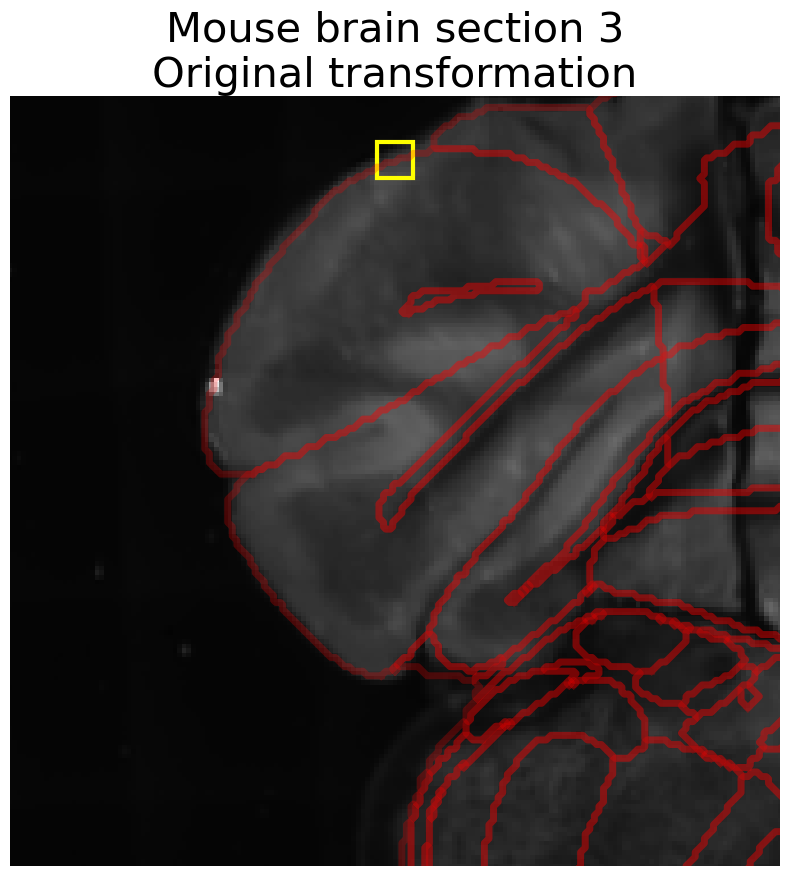

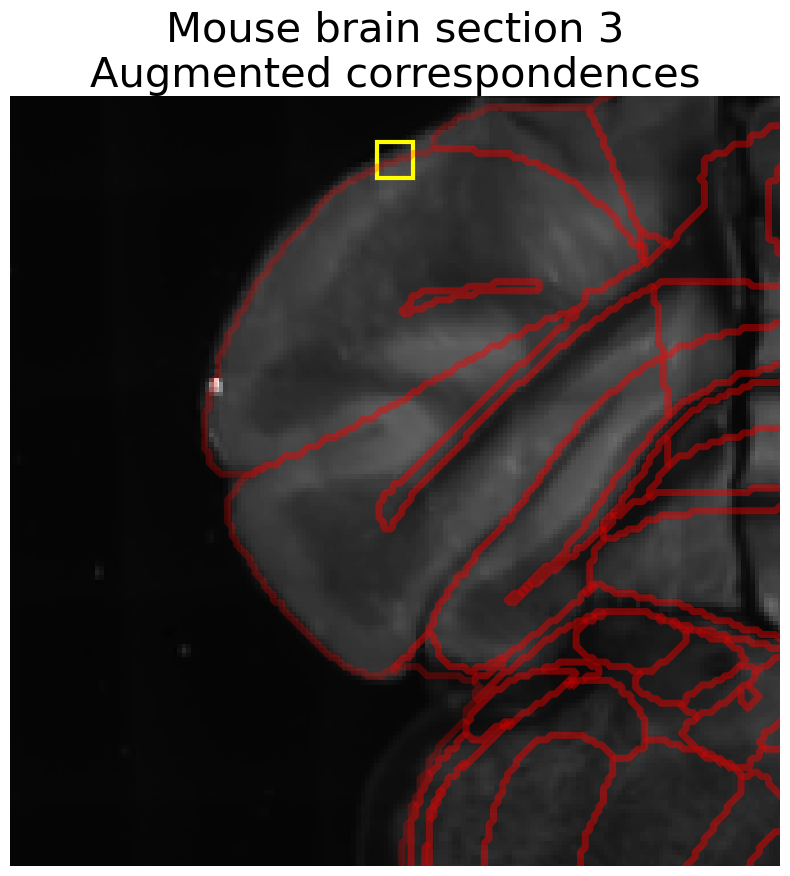

In [19]:
from skimage import measure
import matplotlib.patches as patches

# slice 200, skip 2 window offset 40 offset -15 for y
# ylim = (79, 88)
# xlim = (275, 284)

# For 350: skip 3, window offset 100 (new 50), max dist 10
# (212, 219)
# (197, 204)

# For 500: skip 3, max dist 50, window offset 80, offset 80 (new 70)
# 84 92
# 119 127
ylim = (84, 92)
xlim = (119, 127)
window_offset = 80
y_offset = 70
# Example: coordinates of the box corners (replace with your actual coordinates)
# Jacobian closeup windows
# For 200:
# ylim = (79, 88)
# xlim = (275, 284)

# For 350:
# (235, 242)
# (197, 204)

# For 500:
# 84 92
# 119 127
jylim = (84, 92)
jxlim = (119, 127)

box_coords = [
    (jylim[0], jxlim[0]),  # top-left
    (jylim[0], jxlim[1]),  # top-right
    (jylim[1], jxlim[1]),  # bottom-right
    (jylim[1], jxlim[0])   # bottom-left
]

ylim = (ylim[0] - window_offset + y_offset, ylim[1] + window_offset + y_offset) # -15 for 200
xlim = (xlim[0] - window_offset, xlim[1] + window_offset)

plt.figure(figsize=(10, 10))
plt.imshow(original_transformation, cmap='gray')


# Compute bounding box
ys, xs = zip(*box_coords)
min_x, max_x = min(xs), max(xs)
min_y, max_y = min(ys), max(ys)
width = max_x - min_x
height = max_y - min_y

# Add this after plotting contours, before plt.show()
ax = plt.gca()
rect = patches.Rectangle((min_x, min_y), width, height, linewidth=3, edgecolor='yellow', facecolor='none')
ax.add_patch(rect)

for label in range(1, int(annotation_img.max()) + 1):
    contours = measure.find_contours(annotation_img == label, 0.5)
    for contour in contours:
        plt.plot(contour[:, 1], contour[:, 0], linewidth=5, color='red', alpha=0.25)

plt.axis('off')
plt.title('Mouse brain section 3\nOriginal transformation', fontsize=30)
plt.xlim(xlim)
plt.ylim(ylim)
plt.xticks([])
plt.yticks([])
plt.gca().invert_yaxis()
plt.show()

plt.figure(figsize=(10, 10))
plt.imshow(transformed_img, cmap='gray')
ax = plt.gca()
rect = patches.Rectangle((min_x, min_y), width, height, linewidth=3, edgecolor='yellow', facecolor='none')
ax.add_patch(rect)

for label in range(1, int(annotation_img.max()) + 1):
    contours = measure.find_contours(annotation_img == label, 0.5)
    for contour in contours:
        plt.plot(contour[:, 1], contour[:, 0], linewidth=5, color='red', alpha=0.25)
plt.axis('off')
plt.title('Mouse brain section 3\nAugmented correspondences', fontsize=30)
plt.xlim(xlim)
plt.ylim(ylim)
plt.xticks([])
plt.yticks([])
plt.gca().invert_yaxis()
plt.show()


In [ ]:
import numpy as np

def jacobian_determinant_central(dvf, pt=None):
    """
    Compute the Jacobian determinant of a 2D deformation vector field using central differences.
    dvf: numpy array of shape (3, 1, H, W), where dvf[1, 0, ...] is dy, dvf[2, 0, ...] is dx
    Returns: jdet (H, W) array
    """
    # Extract displacement fields
    dy = dvf[1, 0]  # shape (H, W)
    dx = dvf[2, 0]  # shape (H, W)

    # Compute gradients using central differences
    # For interior points: (f[i+1] - f[i-1]) / 2
    # For borders: use forward/backward difference

    # ∂dx/∂x
    dx_x = np.zeros_like(dx)
    dx_x[:, 1:-1] = (dx[:, 2:] - dx[:, :-2]) / 2
    dx_x[:, 0] = dx[:, 1] - dx[:, 0]
    dx_x[:, -1] = dx[:, -1] - dx[:, -2]

    # ∂dx/∂y
    dx_y = np.zeros_like(dx)
    dx_y[1:-1, :] = (dx[2:, :] - dx[:-2, :]) / 2
    dx_y[0, :] = dx[1, :] - dx[0, :]
    dx_y[-1, :] = dx[-1, :] - dx[-2, :]

    # ∂dy/∂x
    dy_x = np.zeros_like(dy)
    dy_x[:, 1:-1] = (dy[:, 2:] - dy[:, :-2]) / 2
    dy_x[:, 0] = dy[:, 1] - dy[:, 0]
    dy_x[:, -1] = dy[:, -1] - dy[:, -2]

    # ∂dy/∂y
    dy_y = np.zeros_like(dy)
    dy_y[1:-1, :] = (dy[2:, :] - dy[:-2, :]) / 2
    dy_y[0, :] = dy[1, :] - dy[0, :]
    dy_y[-1, :] = dy[-1, :] - dy[-2, :]

    # Show each step
    if pt is not None:
        print("dx_x (∂dx/∂x):\n", dx_x[pt[0], pt[1]])
        print("dx_y (∂dx/∂y):\n", dx_y[pt[0], pt[1]])
        print("dy_x (∂dy/∂x):\n", dy_x[pt[0], pt[1]])
        print("dy_y (∂dy/∂y):\n", dy_y[pt[0], pt[1]])

    # Jacobian determinant formula for 2D deformation:
    # J = | 1 + dy_y   dy_x |
    #     | dx_y     1 + dx_x |
    # det(J) = (1 + dx_x) * (1 + dy_y) - dx_y * dy_x
    jdet = (1 + dx_x) * (1 + dy_y) - dx_y * dy_x

    print("Jacobian determinant:\n", jdet[pt[0], pt[1]])
    return jdet



import numpy as np

def jacobian_determinant_finite(dvf, pt=None):
    """
    Compute the Jacobian determinant of a 2D deformation vector field using forward finite differences.
    dvf: numpy array of shape (3, 1, H, W), where dvf[1, 0, ...] is dy, dvf[2, 0, ...] is dx
    Returns: jdet (H, W) array
    """
    dy = dvf[1, 0]  # (H, W)
    dx = dvf[2, 0]  # (H, W)
    H, W = dx.shape

    # ∂dx/∂x (forward difference)
    dx_x = np.zeros_like(dx)
    dx_x[:, :-1] = dx[:, 1:] - dx[:, :-1]
    dx_x[:, -1] = dx[:, -1] - dx[:, -2]

    # ∂dx/∂y (forward difference)
    dx_y = np.zeros_like(dx)
    dx_y[:-1, :] = dx[1:, :] - dx[:-1, :]
    dx_y[-1, :] = dx[-1, :] - dx[-2, :]

    # ∂dy/∂x (forward difference)
    dy_x = np.zeros_like(dy)
    dy_x[:, :-1] = dy[:, 1:] - dy[:, :-1]
    dy_x[:, -1] = dy[:, -1] - dy[:, -2]

    # ∂dy/∂y (forward difference)
    dy_y = np.zeros_like(dy)
    dy_y[:-1, :] = dy[1:, :] - dy[:-1, :]
    dy_y[-1, :] = dy[-1, :] - dy[-2, :]

    # Show each step
    if pt is not None:
        print("dx_x (∂dx/∂x):\n", dx_x[pt[0], pt[1]])
        print("dx_y (∂dx/∂y):\n", dx_y[pt[0], pt[1]])
        print("dy_x (∂dy/∂x):\n", dy_x[pt[0], pt[1]])
        print("dy_y (∂dy/∂y):\n", dy_y[pt[0], pt[1]])

    # Jacobian determinant formula for 2D deformation:
    # J = | 1 + dy_y   dy_x |
    #     | dx_y     1 + dx_x |
    # det(J) = (1 + dx_x) * (1 + dy_y) - dx_y * dy_x
    jdet = (1 + dx_x) * (1 + dy_y) - dx_y * dy_x

    if pt is not None:
        print("Jacobian determinant:\n", jdet[pt[0], pt[1]])
    return jdet

jacobian_determinant_central(d_expanded.deformation, pt=np.array((135, 101)))


jacobian_determinant_finite(d_expanded.deformation, pt=np.array((135, 101)))

dx_x (∂dx/∂x):
 0.0
dx_y (∂dx/∂y):
 0.0
dy_x (∂dy/∂x):
 -0.05833487756452893
dy_y (∂dy/∂y):
 -0.9899152259037525
Jacobian determinant:
 0.010084774096247529
dx_x (∂dx/∂x):
 0.0
dx_y (∂dx/∂y):
 0.0
dy_x (∂dy/∂x):
 -0.025446637508286685
dy_y (∂dy/∂y):
 -1.0190625494641203
Jacobian determinant:
 -0.019062549464120337


array([[1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.]])

### Jacobian plot

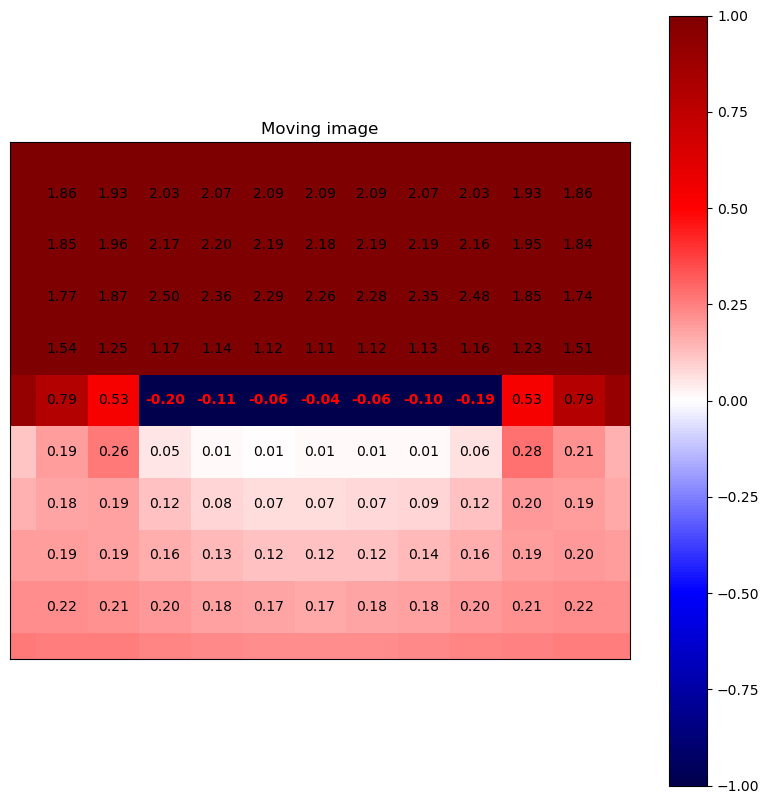

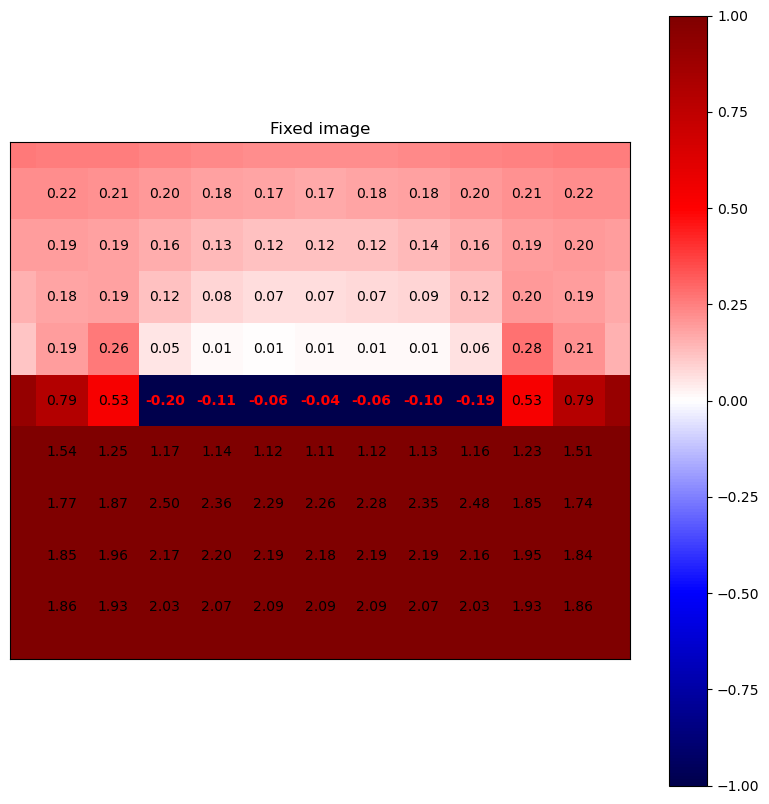

In [56]:
jacobian_plot(d_moving, title="Moving image", figsize=(10, 10),
              #moving_pts=mpoints,
              #fixed_pts=fpoints,
              xlim=(96, 108), 
              ylim=(116, 126), 
              binarize_negatives=True)

jacobian_plot(d_fixed, title="Fixed image", figsize=(10, 10),
              #moving_pts=mpoints,
              #fixed_pts=fpoints,
              xlim=(96, 108), 
              ylim=(130, 140), 
              binarize_negatives=True)

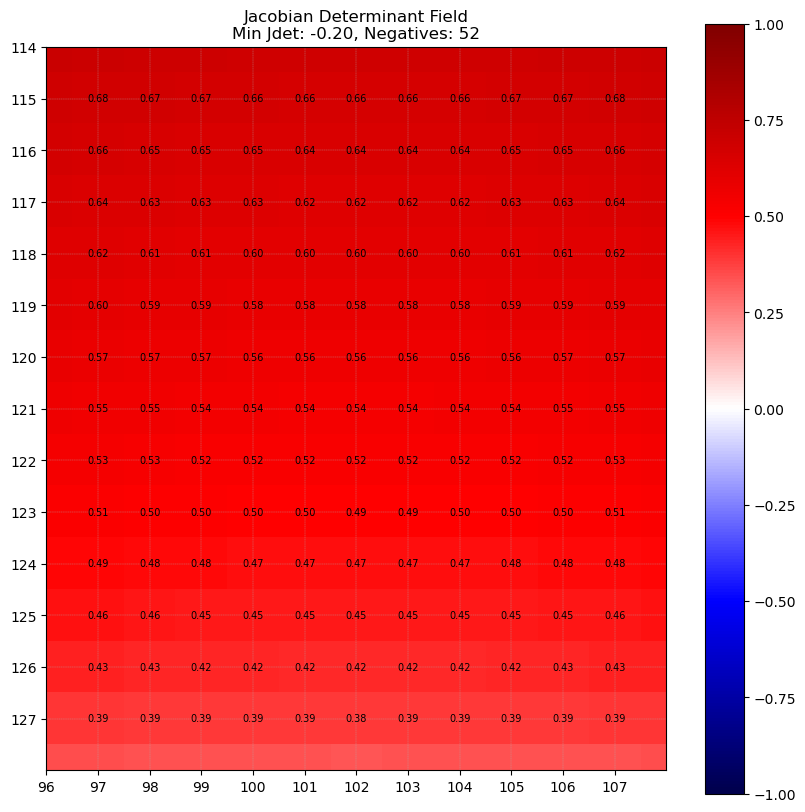

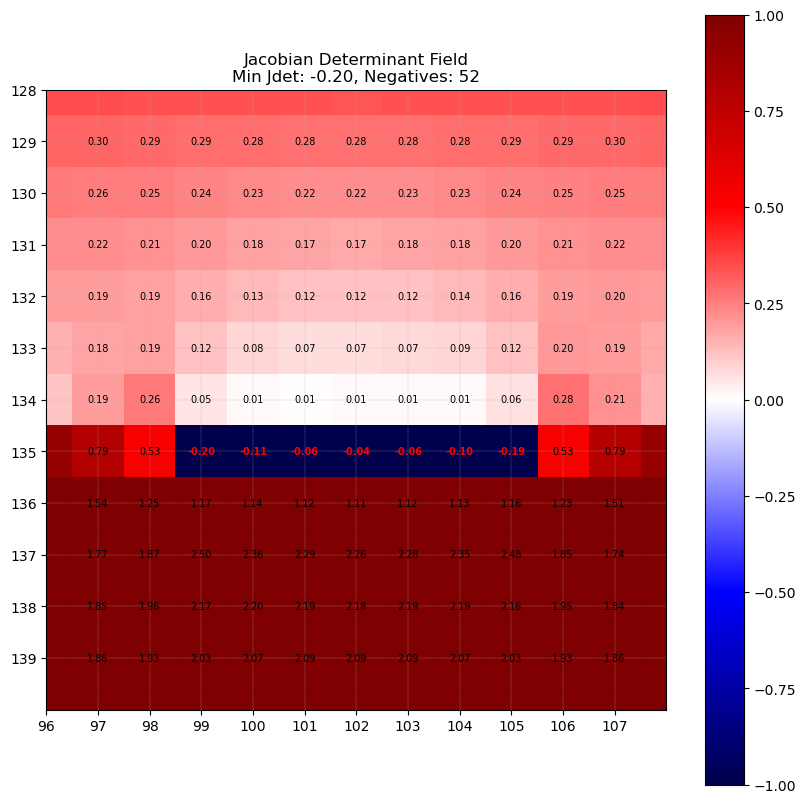

In [ ]:
jacobian_plot(d_moving, 
              #pt=correspondence_pt, 
              figsize=(10, 10), 
              title="Jacobian Determinant Field\nMin Jdet: {:.2f}, Negatives: {}".format(d_original.min(), d_original.count_negatives()),
              #moving_pts=new_mpoints, 
              moving_pts=new_fpoints,
              xlim=(96, 108),
              ylim=(114, 128),
              binarize_negatives=True)


jacobian_plot(d_fixed, 
              #pt=correspondence_pt, 
              figsize=(10, 10), 
              title="Jacobian Determinant Field\nMin Jdet: {:.2f}, Negatives: {}".format(d_original.min(), d_original.count_negatives()),
              moving_pts=new_mpoints + np.array([[0, 20, 0]]),  # Add a dummy point for consistency
              #moving_pts=new_fpoints + np.array([[0, 20, 0]]),  # Add a dummy point for consistency
              xlim=(96, 108),
              ylim=(128, 140),
              binarize_negatives=True)

In [ ]:
print(np.min(np.abs(d_fixed.jdet_field)), np.max(np.abs(d_fixed.jdet_field)))

print(np.min(np.abs(d_moving.jdet_field)), np.max(np.abs(d_moving.jdet_field)))

0.003321199197585223 2.500968138782226
0.0033211991975923283 2.500968138782243


In [ ]:
print(d_expanded.jdet_field[134, 103])
print(d_expanded.jdet_field[120, 103])

0.4629768721990186
1.2082476677790988



=== Creating Double Helix for Point Correspondence ===
Created double helix with 206 points per wave
Grid size: 256x256
Padding: 25 pixels on each side
Number of cycles: 2
Phase offset: 3.142 radians (180.0 degrees)
Wave 1 - X range: [25, 230], Y range: [120, 136]
Wave 2 - X range: [25, 230], Y range: [120, 136]
Number of intersection points: 10


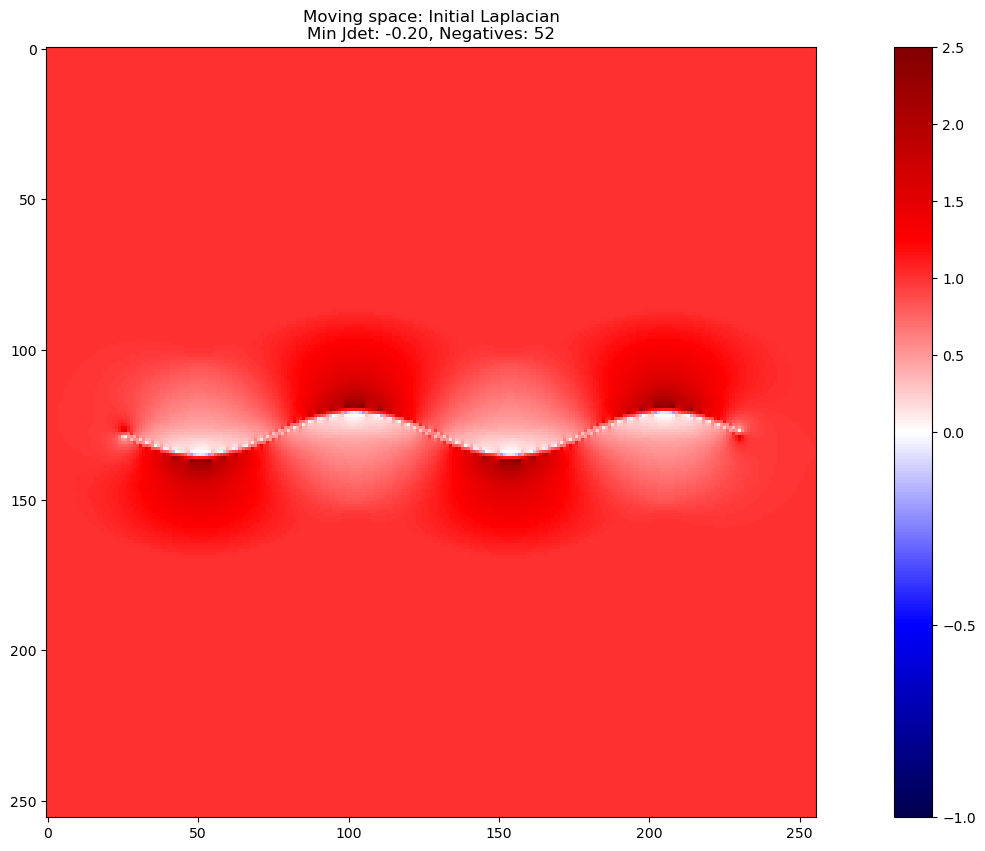

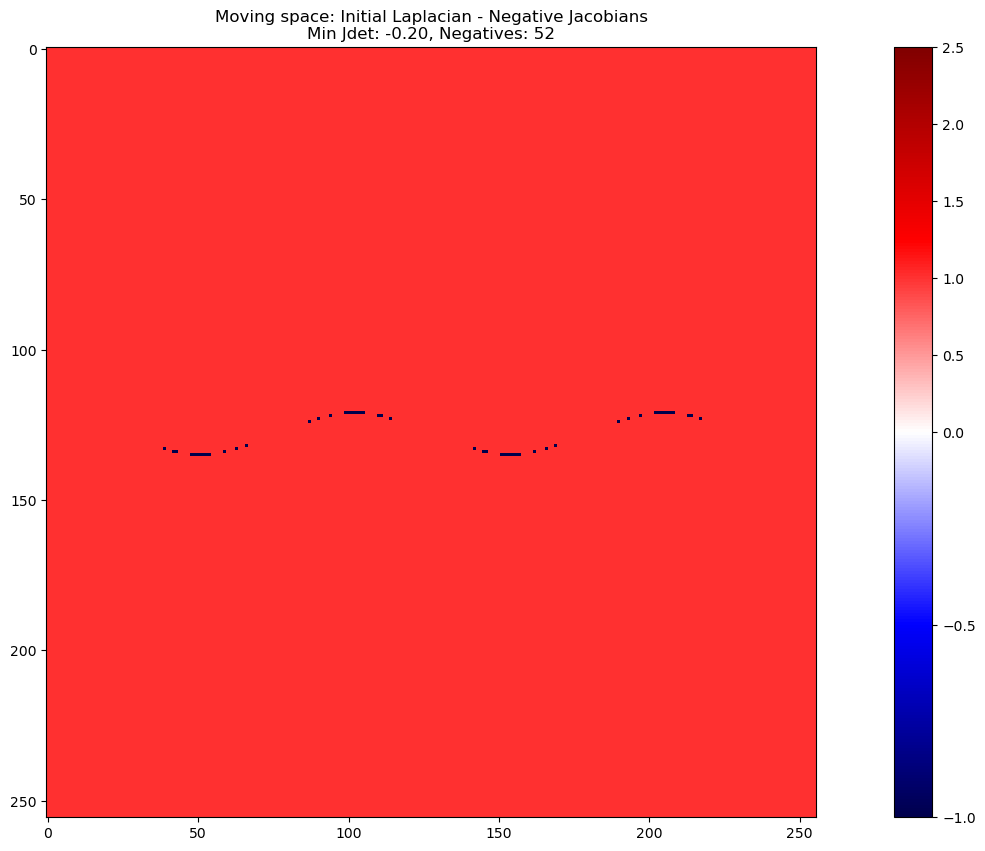

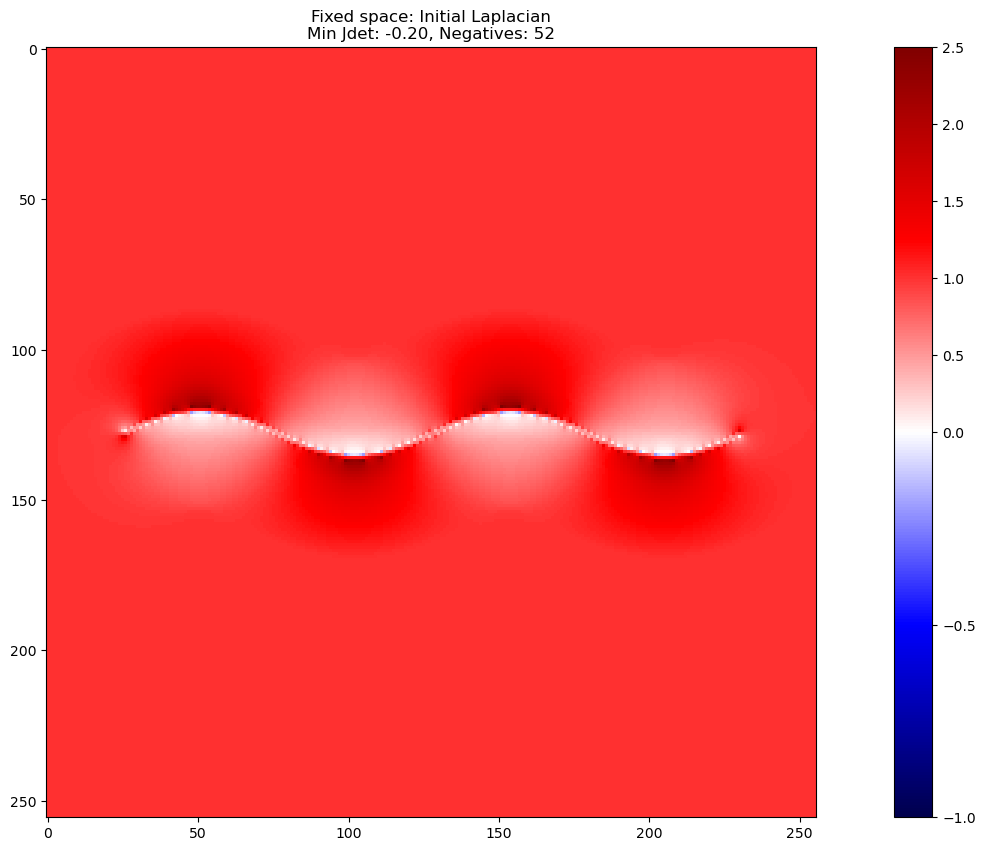

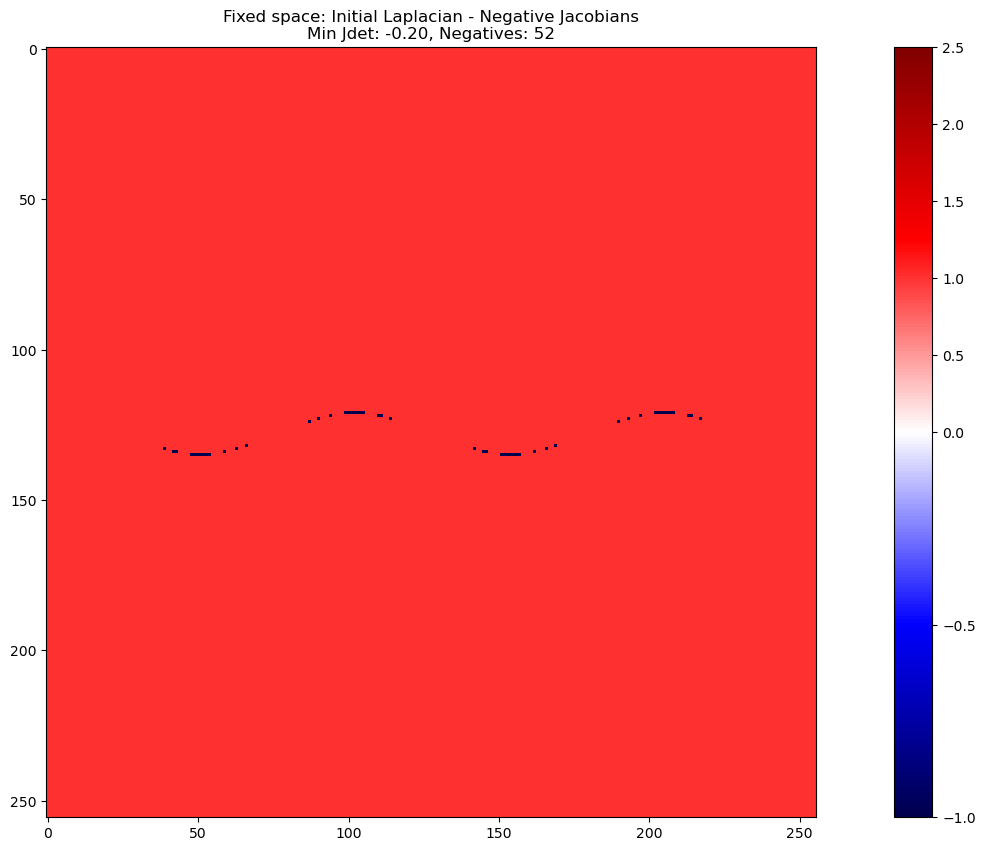

Found 5675 expanding Jacobian determinants with threshold 1.1.



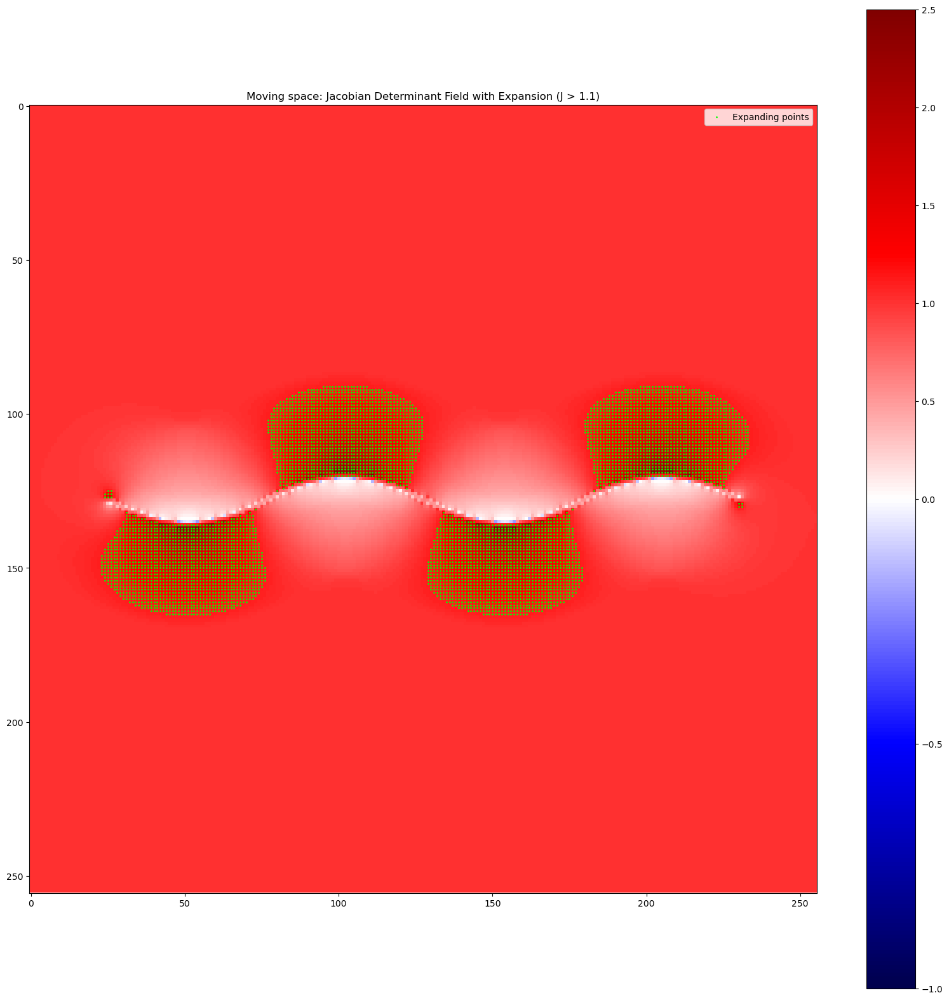

New moving points shape: (5674, 3)
New fixed points shape: (5674, 3)
Cleaned new moving points shape: (5618, 3)
Cleaned new fixed points shape: (5618, 3)


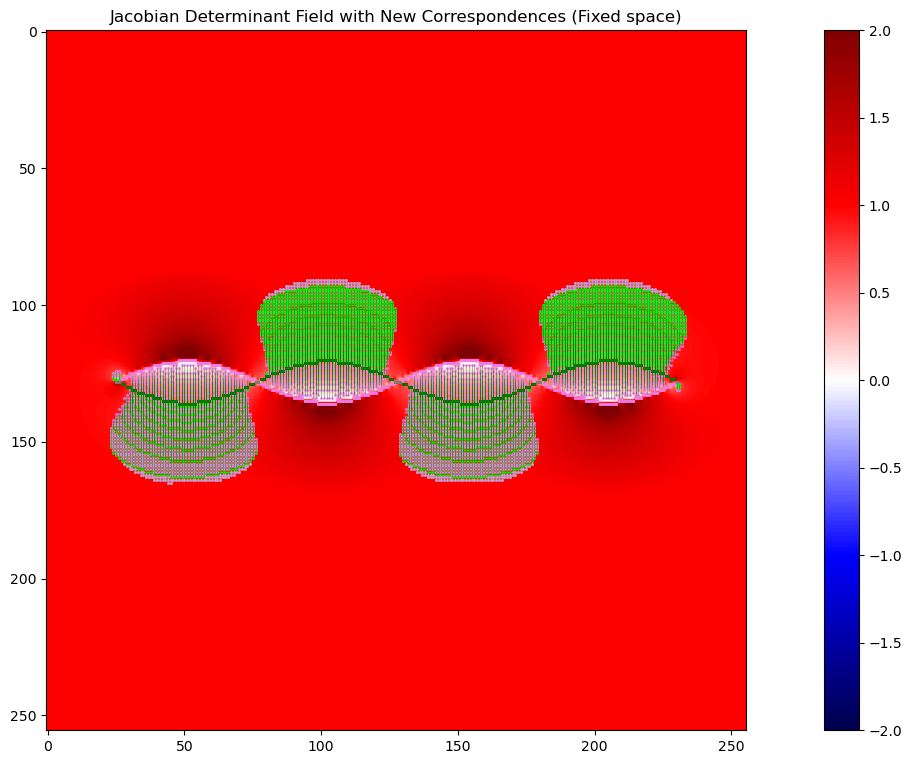

[142.4173923 208.       ]
Cleaned new fixed points shape: (5618, 3)
Cleaned new moving points shape: (5618, 3)


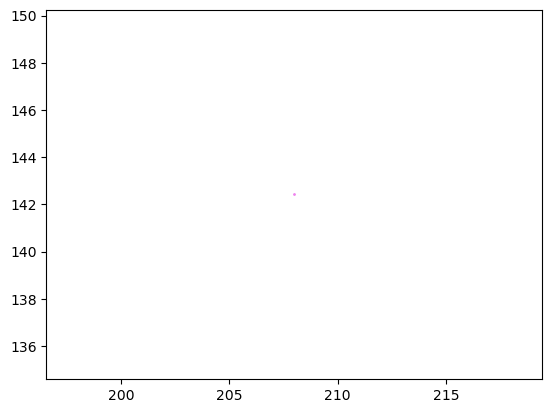

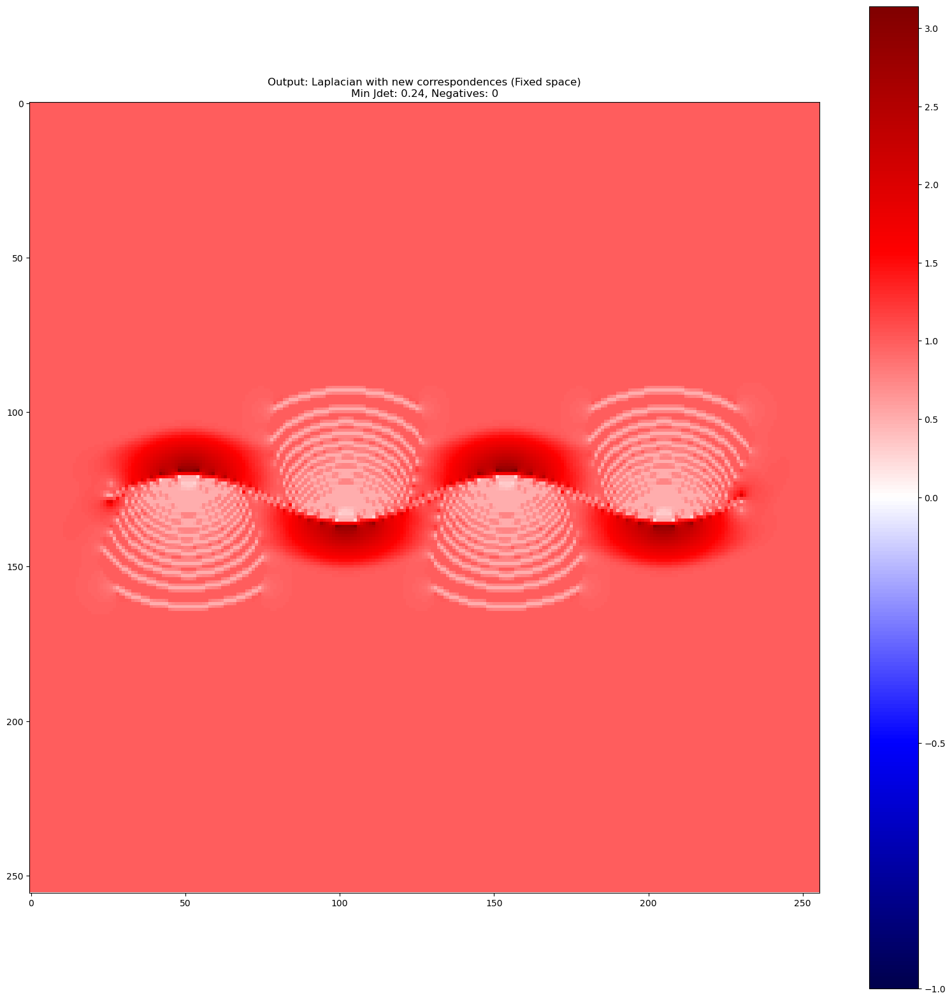

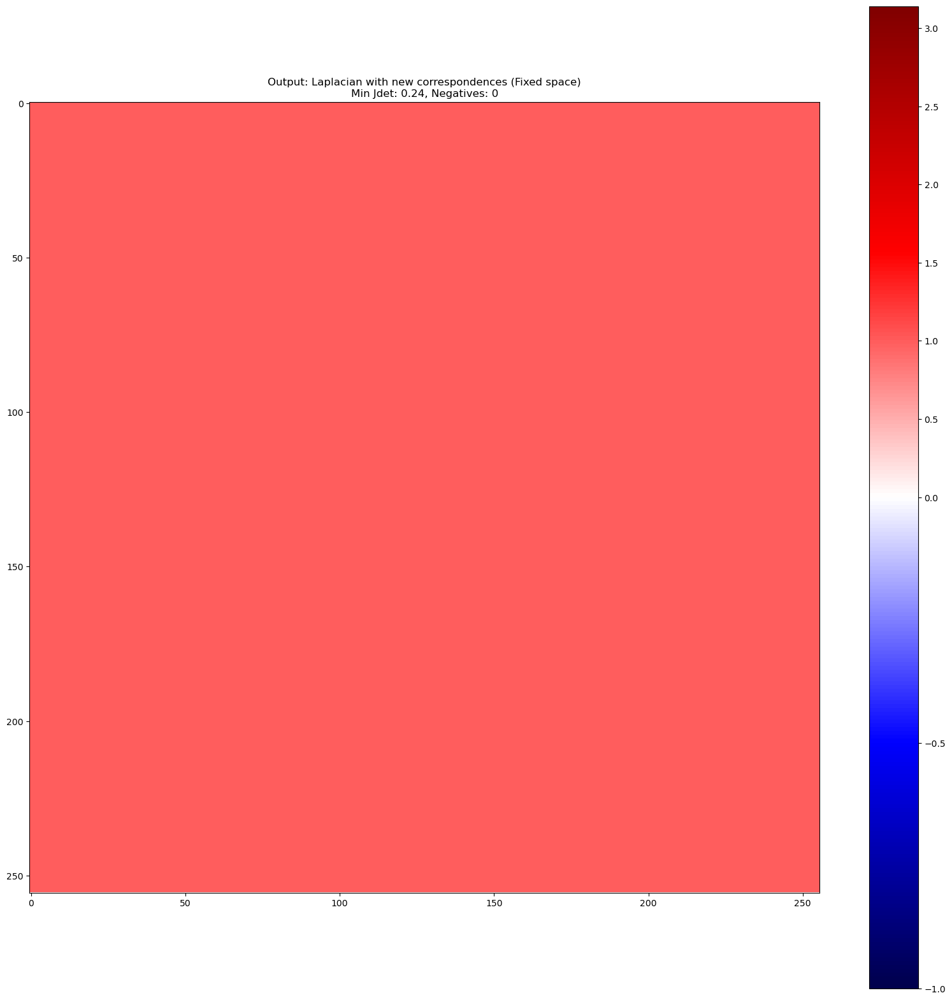

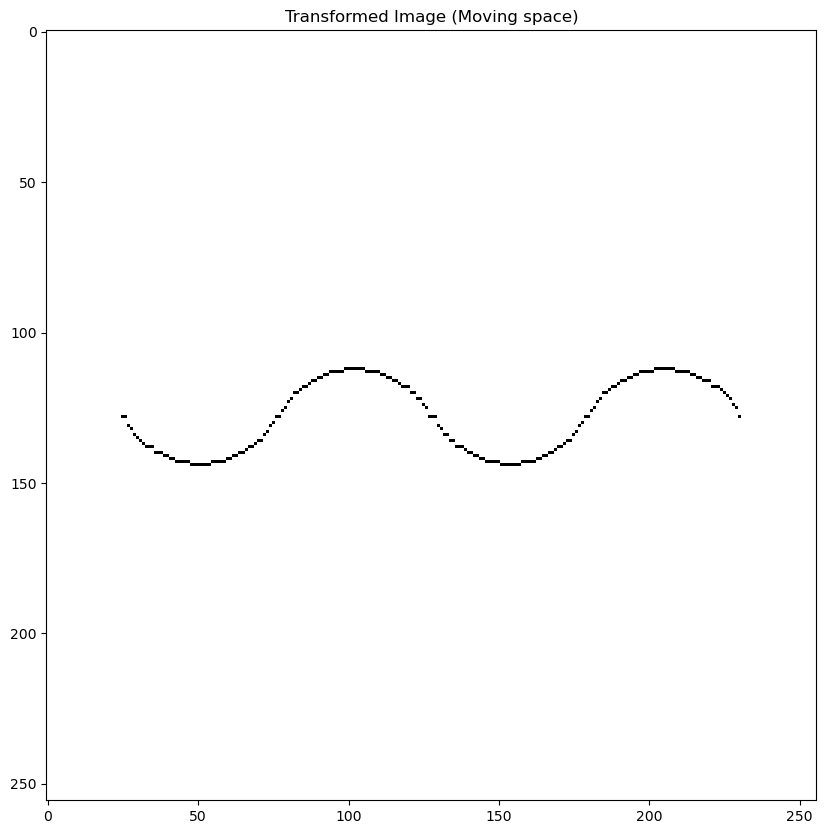

In [70]:
scale = 3
jdet_threshold = 1.1
verbose = False

# Create a specific double helix for correspondence analysis
print("\n=== Creating Double Helix for Point Correspondence ===")
mpoints, fpoints, _ = data_utils.create_double_helix_waves(
    grid_size=256,
    num_cycles=2,
    amplitude_ratio=0.03,
    phase_offset=np.pi,  # 180 degrees for maximum separation
    padding_ratio=0.1,
    plot=False, horizontal=False,  # Set horizontal to False for vertical helix
)

mpoints = mpoints[:, [1, 0]]  # Swap to (y, x) format
fpoints = fpoints[:, [1, 0]]  # Swap to (y, x) format 

# Add 0s on the first axis to format for Data class
mpoints = np.pad(mpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)
fpoints = np.pad(fpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)

# Create data classes
d_fixed = Data(mpoints, fpoints, (256, 256))
d_moving = np.load("d_moving.npy", allow_pickle=True).item()

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 10), binarize_negatives=False,
       title=f"Moving space: Initial Laplacian\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 10), binarize_negatives=True,
       title=f"Moving space: Initial Laplacian - Negative Jacobians\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

d_fixed.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 10), binarize_negatives=False,
       title=f"Fixed space: Initial Laplacian\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 10), binarize_negatives=True,
       title=f"Fixed space: Initial Laplacian - Negative Jacobians\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")


# Upscale the deformation fields
upscaled_fixed = upscale_dvf_preserve(d_fixed.deformation, scale=scale)
upscaled_moving = upscale_dvf_preserve(d_moving.deformation, scale=scale)



########### EDIT:  DO IT IN MOVING SPACE ###########
#d_moving = d_fixed


expanding_coord = get_expanding_coordinates(d_moving.jdet_field, threshold=jdet_threshold, verbose=False)
# Remove points that occur in the fixed points set
expanding_coord = np.array([coord for coord in expanding_coord if tuple(coord) not in set(map(tuple, d_fixed.fpoints[:, 1:]))])




# For each expanding coordinate, get the adjacent coordinates in the upscaled deformation field
print()

new_mpoints = []
new_fpoints = []
for y, x in expanding_coord:
    # Get the corresponding coordinates in the upscaled deformation field (now use upscaled_moving)
    y_curr = y * scale
    x_curr = x * scale
    displacement_curr = upscaled_fixed[:, 0, y_curr, x_curr]
    mapped_point_curr = np.array((y + displacement_curr[1], x + displacement_curr[2]))

    # Left and right coordinates in the upscaled deformation field
    x_left = x_curr - 1
    x_right = x_curr + 1
    y_up = y_curr - 1
    y_down = y_curr + 1

    displacement_left = upscaled_fixed[:, 0, y_curr, x_left]
    displacement_right = upscaled_fixed[:, 0, y_curr, x_right]
    displacement_up = upscaled_fixed[:, 0, y_up, x_curr]
    displacement_down = upscaled_fixed[:, 0, y_down, x_curr]

    mapped_point_left = np.array((y + displacement_left[1], x + displacement_left[2]))
    mapped_point_right = np.array((y + displacement_right[1], x + displacement_right[2]))
    mapped_point_up = np.array((y + displacement_up[1], x + displacement_up[2]))
    mapped_point_down = np.array((y + displacement_down[1], x + displacement_down[2]))

    # Of all of the mapped points, find the mapped point that is closest to an integer coordinate
    mapped_points = [mapped_point_left, mapped_point_right, mapped_point_up, mapped_point_down, mapped_point_curr]
    closest_point = min(mapped_points, key=lambda p: np.linalg.norm(p - np.round(p)))
    closest_point = np.round(closest_point).astype(int)

    # Now, moving point is [0, y, x], fixed point is [0, closest_point[0], closest_point[1]]
    new_mpoints.append([0, y, x])
    #new_fpoints.append([0, closest_point[0], closest_point[1]])
    new_fpoints = [np.round(get_mapped_point(f[1:], d_moving.deformation)).astype(int) for f in new_mpoints]
    # Add zero to the first axis for Data class compatibility
    new_fpoints = [np.concatenate([[0], np.round(get_mapped_point(f[1:], d_moving.deformation)).astype(int)]) for f in new_mpoints]
    #for f in new_fpoints:
    #f = m.copy()
    #m -= np.array([0, 0, 0])  # Adjust to (y, x) format
    #mapped_point = get_mapped_point(m[1:], d_fixed.deformation)
    #print(f"Fixed point: {m[1:]} -> displacement: {get_displacement(m[1:], d_fixed.deformation)[1:]}, \tmapped point: {get_mapped_point(m[1:], d_fixed.deformation)}, \tjacobian: {d_fixed.jdet_field[m[1], m[2]]}")
    #print(mapped_point)
    #plt.scatter(mapped_point[1], mapped_point[0], c='violet', s=1, label='Mapped Points')


# Convert to numpy arrays for consistency
new_mpoints = np.array(new_mpoints)
new_fpoints = np.array(new_fpoints)

###### Visualize the Jacobian determinant field with J > thresh ######
plt.figure(figsize=(20, 20))
jdet_field = d_moving.jdet_field.copy()
norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())

plt.imshow(jdet_field, cmap='seismic', norm=norm)
plt.colorbar()
# Connect moving and fixed points
plt.scatter(new_mpoints[:, 2], new_mpoints[:, 1], c='lime', s=1, label='Expanding points')
plt.title(f"Moving space: Jacobian Determinant Field with Expansion (J > {jdet_threshold})")
plt.legend()
plt.show()


print("New moving points shape:", new_mpoints.shape)
print("New fixed points shape:", new_fpoints.shape)

# Remove duplicates as before
new_fpoints = np.array([fp for fp in new_fpoints if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])
new_mpoints = np.array([mp for mp, fp in zip(new_mpoints, new_fpoints) if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])

new_mpoints = np.array([mp for mp in new_mpoints if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])
new_fpoints = np.array([fp for fp, mp in zip(new_fpoints, new_mpoints) if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])

print("Cleaned new moving points shape:", new_mpoints.shape)
print("Cleaned new fixed points shape:", new_fpoints.shape)

###### Visualize the Jacobian determinant field with new correspondences ######
plt.figure(figsize=(20, 20))
plt.subplot(2, 1, 1)
jdet_field = d_fixed.jdet_field.copy()
plt.imshow(jdet_field, cmap='seismic', vmin=-2, vmax=2)
plt.colorbar()
# Connect moving and fixed points
for mp, fp in zip(new_mpoints, new_fpoints):
    plt.plot([mp[2], fp[2]], [mp[1], fp[1]], c='green', linewidth=0.5, alpha=0.5)
    plt.scatter(mp[2], mp[1], c='lime', s=1, label='Moving Points')
    plt.scatter(fp[2], fp[1], c='violet', s=1, label='Fixed Points')
    plt.scatter(mpoints[:, 2], mpoints[:, 1], c='green', s=1, label='Original Moving Points', alpha=0.15)
    plt.scatter(fpoints[:, 2], fpoints[:, 1], c='violet', s=1, label='Original Fixed Points', alpha=0.15)
    
#plt.grid(True, which='both', linestyle='--', linewidth=0.25)
#plt.gca().invert_yaxis()
plt.title("Jacobian Determinant Field with New Correspondences (Fixed space)")
plt.show()


mapped_point = get_mapped_point(m[1:], d_moving.deformation)
#print(f"Fixed point: {m[1:]} -> displacement: {get_displacement(m[1:], d_fixed.deformation)[1:]}, \tmapped point: {get_mapped_point(m[1:], d_fixed.deformation)}, \tjacobian: {d_fixed.jdet_field[m[1], m[2]]}")
print(mapped_point)
plt.scatter(mapped_point[1], mapped_point[0], c='violet', s=1, label='Mapped Points')

# Add to original set of correspondences
mpoints = np.vstack((mpoints, new_mpoints))
fpoints = np.vstack((fpoints, new_fpoints))

# ...existing code...
print("Cleaned new fixed points shape:", new_fpoints.shape)
print("Cleaned new moving points shape:", new_mpoints.shape)

# Add to original set of correspondences
mpoints = np.vstack((mpoints, new_mpoints))
fpoints = np.vstack((fpoints, new_fpoints))

# Create a new Data object with the updated points
d_expanded = Data(mpoints, fpoints, (256, 256))
d_expanded.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 20), binarize_negatives=False,
       title=f"Output: Laplacian with new correspondences (Fixed space)\nMin Jdet: {d_expanded.min():.2f}, Negatives: {d_expanded.count_negatives()}")
d_expanded.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 20), binarize_negatives=True,
       title=f"Output: Laplacian with new correspondences (Fixed space)\nMin Jdet: {d_expanded.min():.2f}, Negatives: {d_expanded.count_negatives()}")

# Save to raw image
moving_img = data_utils.create_raw_image(d_fixed.mpoints, (256, 256), save_path="wave1.png")
fixed_img = data_utils.create_raw_image(d_fixed.fpoints, (256, 256), save_path="wave2.png")
transformed_img = reg_utils.apply_transformation(d_expanded, moving_img, title="Transformed Image (Moving space)")

## Moving space

In [4]:
mdata_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fdata_path = "data/corrected_correspondences_count_touching/fpoints.npy"
CURR_IDX = 350

mdata = np.load(mdata_path)
fdata = np.load(fdata_path)

# Get only elements that are of the current index
mdata = mdata[mdata[:, 0] == CURR_IDX]
fdata = fdata[fdata[:, 0] == CURR_IDX]
mdata[:, 0] = 0
fdata[:, 0] = 0

# Get every N points
N = 3  # 3 for 350, 2 otherwise
mdata = mdata[::N]
fdata = fdata[::N]
#resolution = np.zeros((1, 320, 456))


=== Creating Double Helix for Point Correspondence ===
Created double helix with 206 points per wave
Grid size: 256x256
Padding: 25 pixels on each side
Number of cycles: 2
Phase offset: 3.142 radians (180.0 degrees)
Wave 1 - X range: [25, 230], Y range: [120, 136]
Wave 2 - X range: [25, 230], Y range: [120, 136]
Number of intersection points: 10


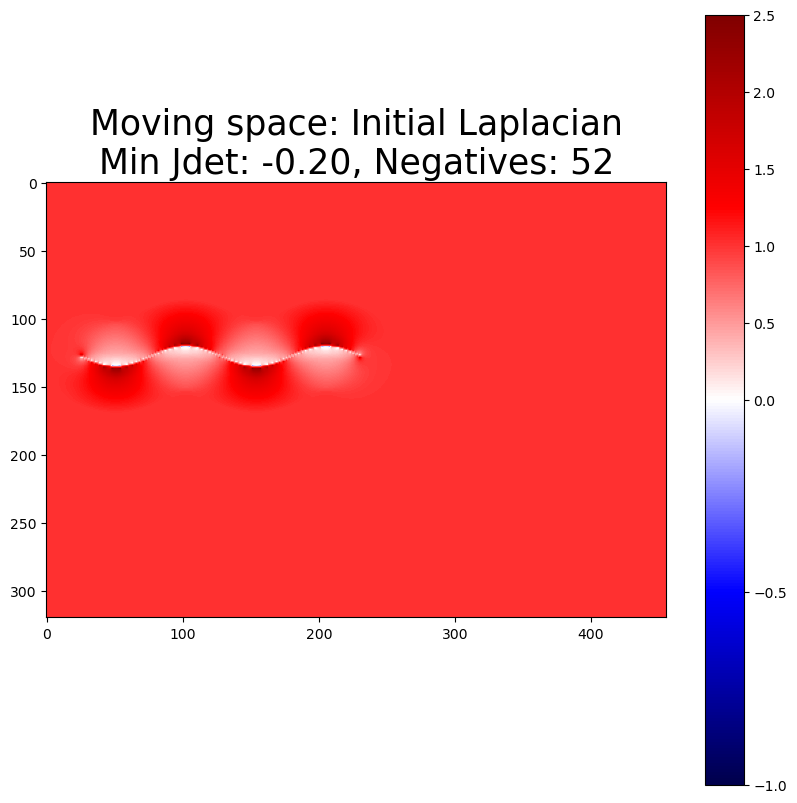

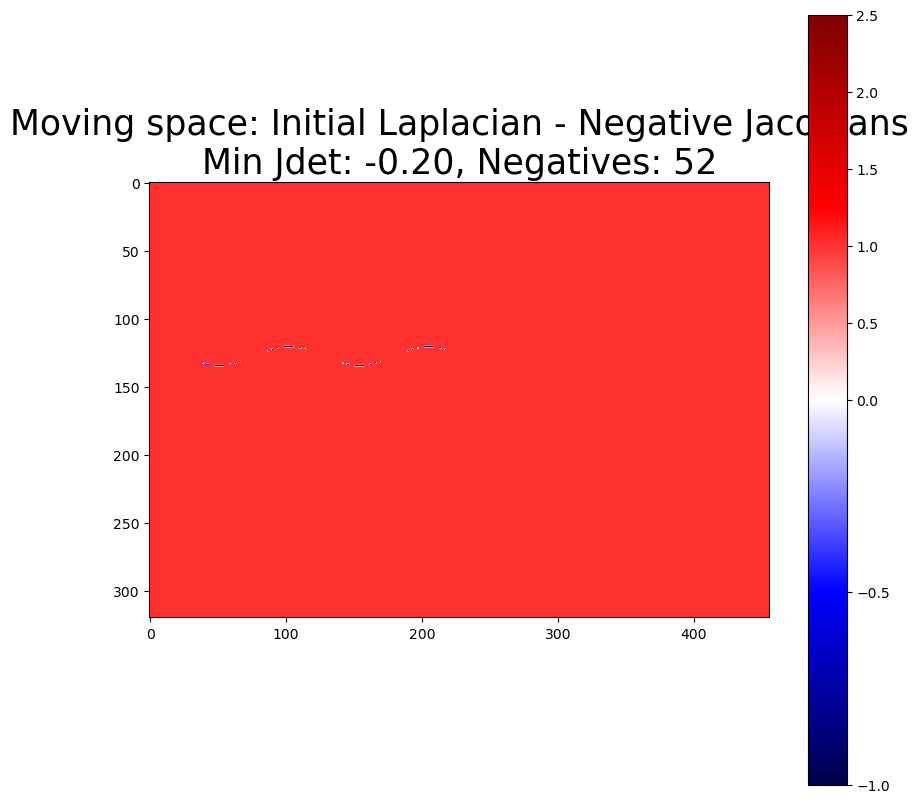

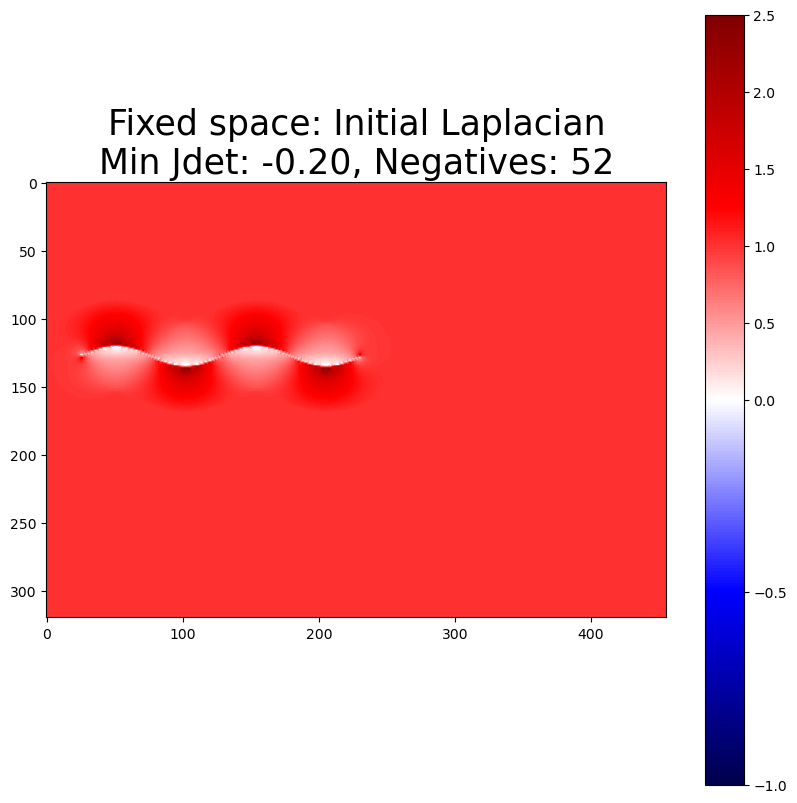

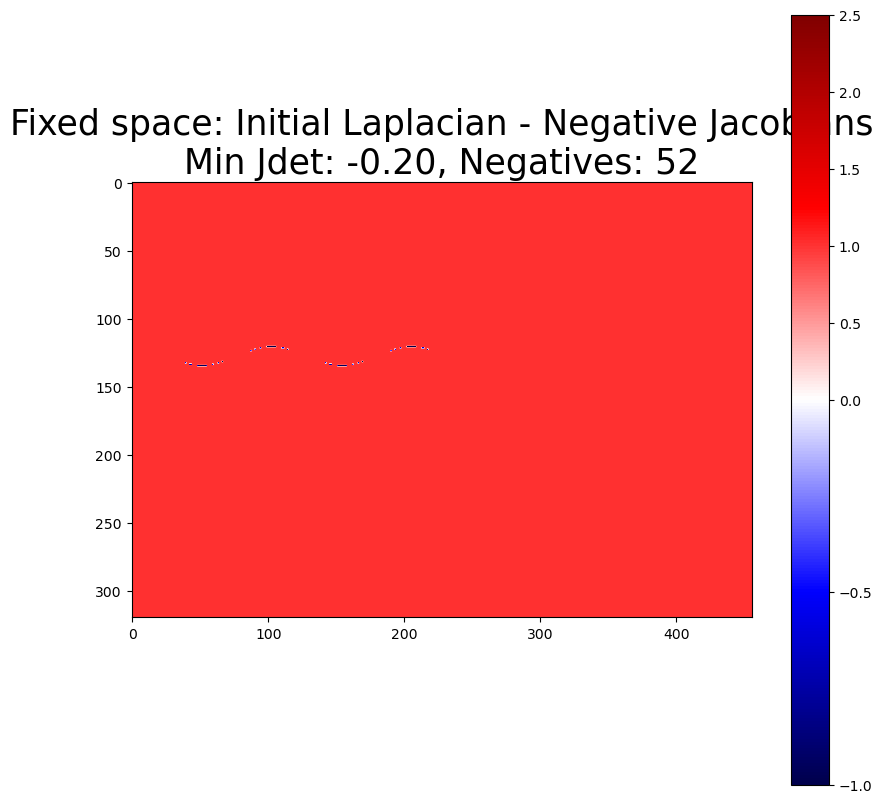

Found 96 expanding Jacobian determinants with threshold 2.0.



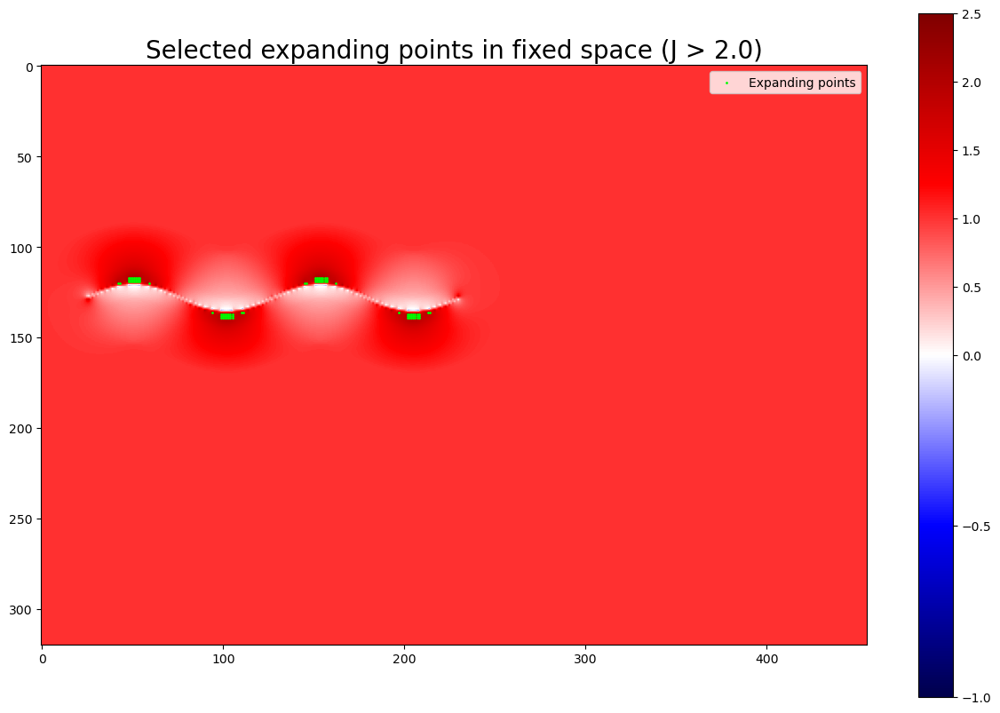

New moving points shape: (96, 3)
New fixed points shape: (96, 3)
Cleaned new moving points shape: (96, 3)
Cleaned new fixed points shape: (96, 3)
Cleaned new fixed points shape: (96, 3)
Cleaned new moving points shape: (96, 3)


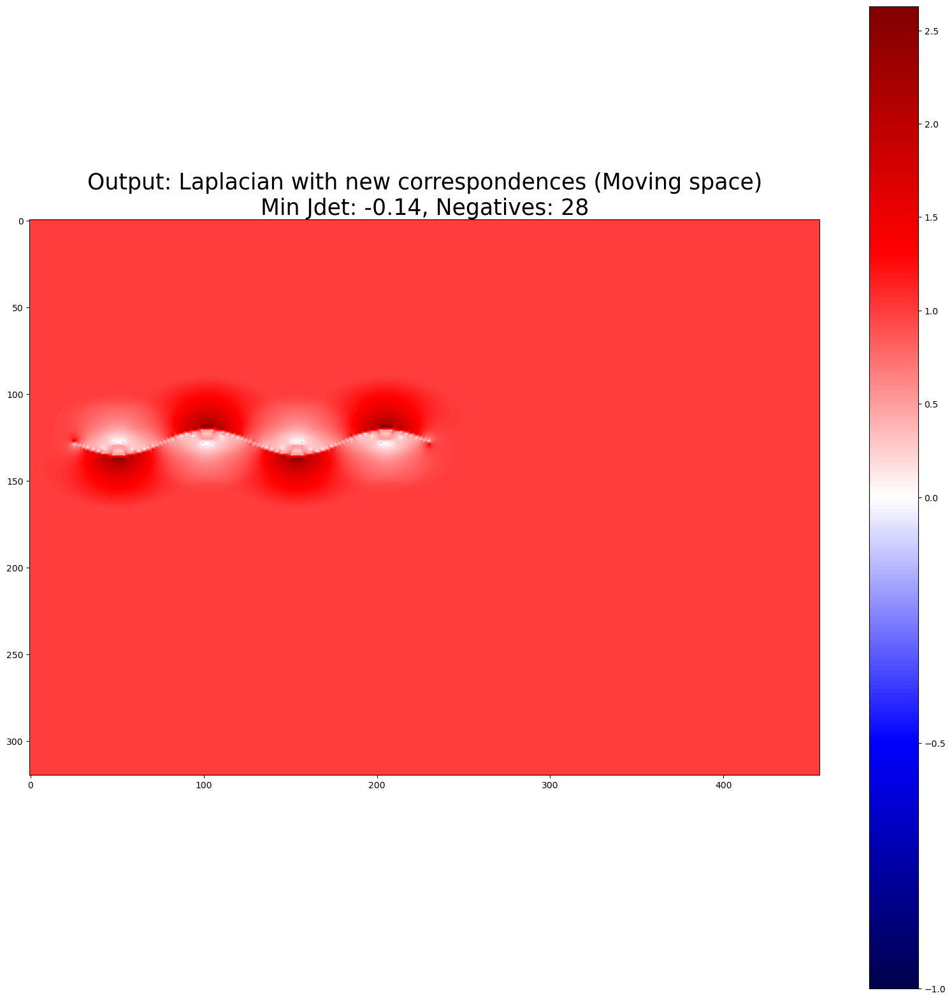

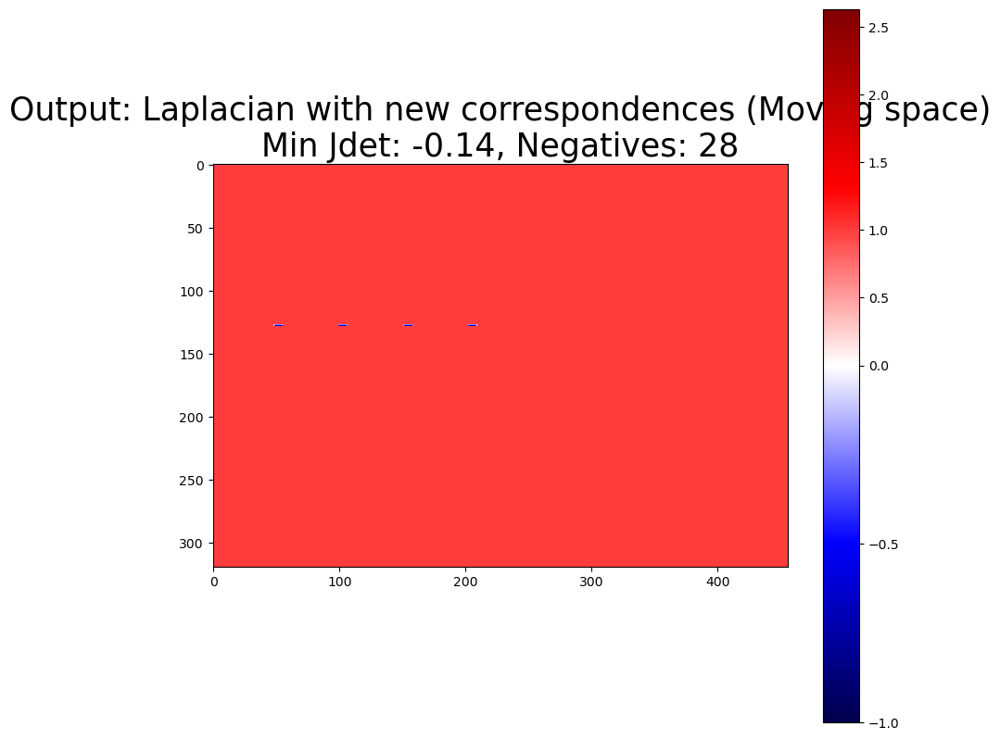

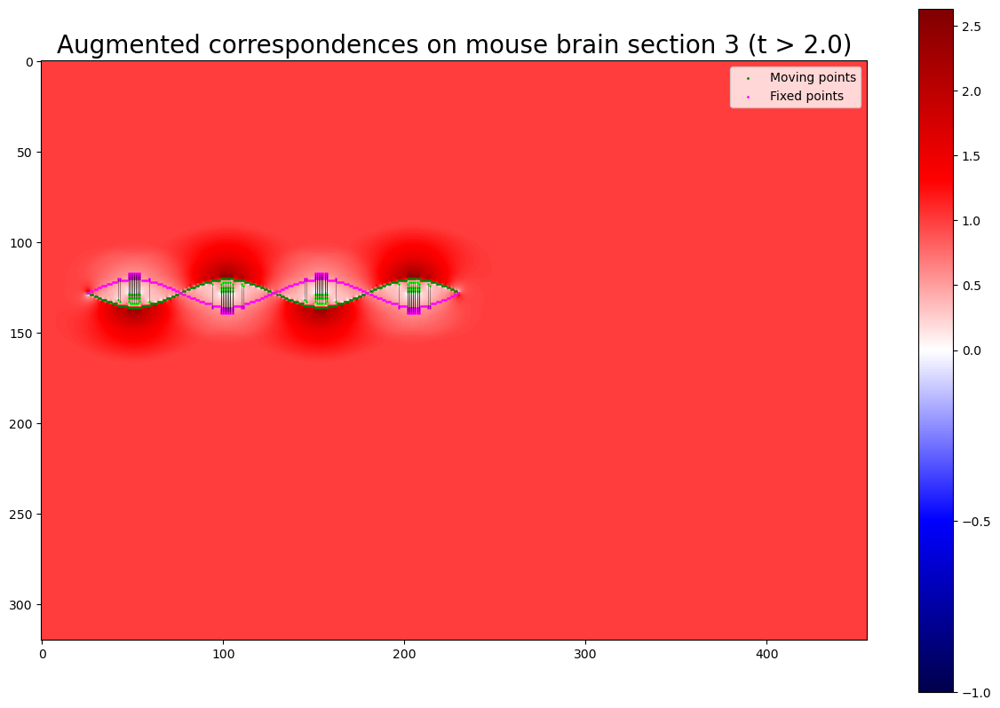

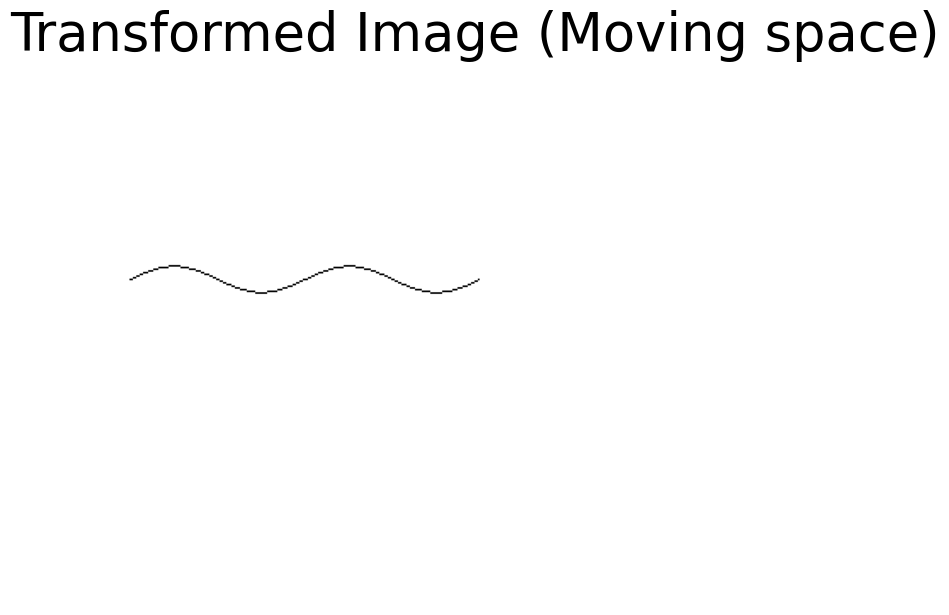

In [6]:
scale = 3
jdet_threshold = 2.0
verbose = False
resolution = (320, 456)
# Remove point pairs where the distance between new_mpoints and new_fpoints is above a threshold
magnitude_thresh = 50  # 100 elsewhere
plot_points = True


# Create a specific double helix for correspondence analysis
print("\n=== Creating Double Helix for Point Correspondence ===")
mpoints, fpoints, _ = data_utils.create_double_helix_waves(
    grid_size=256,
    num_cycles=2,
    amplitude_ratio=0.03,
    phase_offset=np.pi,  # 180 degrees for maximum separation
    padding_ratio=0.1,
    plot=False, horizontal=False,  # Set horizontal to False for vertical helix
)

mpoints = mpoints[:, [1, 0]]  # Swap to (y, x) format
fpoints = fpoints[:, [1, 0]]  # Swap to (y, x) format 

# Add 0s on the first axis to format for Data class
mpoints = np.pad(mpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)
fpoints = np.pad(fpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)


#mpoints = mdata
#fpoints = fdata


# Create data classes
d_fixed = Data(mpoints, fpoints, resolution)  # 256x256 grid (320x456 for the real data)
d_moving = np.load("d_moving.npy", allow_pickle=True).item()
d_moving = Data_Moving(mpoints, fpoints, resolution)

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Moving space: Initial Laplacian\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
       title=f"Moving space: Initial Laplacian - Negative Jacobians\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

d_fixed.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Fixed space: Initial Laplacian\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
       title=f"Fixed space: Initial Laplacian - Negative Jacobians\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")


# Upscale the deformation fields
upscaled_fixed = upscale_dvf_preserve(d_fixed.deformation, scale=scale)
upscaled_moving = upscale_dvf_preserve(d_moving.deformation, scale=scale)



########### EDIT:  DO IT IN MOVING SPACE ###########
#d_moving = d_fixed


expanding_coord = get_expanding_coordinates(d_fixed.jdet_field, threshold=jdet_threshold, verbose=False)
# Remove points that occur in the fixed points set
expanding_coord = np.array([coord for coord in expanding_coord if tuple(coord) not in set(map(tuple, d_moving.fpoints[:, 1:]))])




# For each expanding coordinate, get the adjacent coordinates in the upscaled deformation field
print()

new_mpoints = []
new_fpoints = []
for y, x in expanding_coord:
    # Get the corresponding coordinates in the upscaled deformation field (now use upscaled_moving)
    
    """
    y_curr = y * scale
    x_curr = x * scale
    displacement_curr = upscaled_moving[:, 0, y_curr, x_curr]
    mapped_point_curr = np.array((y + displacement_curr[1], x + displacement_curr[2]))

    # Left and right coordinates in the upscaled deformation field
    x_left = x_curr - 1
    x_right = x_curr + 1
    y_up = y_curr - 1
    y_down = y_curr + 1

    displacement_left = upscaled_moving[:, 0, y_curr, x_left]
    displacement_right = upscaled_moving[:, 0, y_curr, x_right]
    displacement_up = upscaled_moving[:, 0, y_up, x_curr]
    displacement_down = upscaled_moving[:, 0, y_down, x_curr]

    mapped_point_left = np.array((y + displacement_left[1], x + displacement_left[2]))
    mapped_point_right = np.array((y + displacement_right[1], x + displacement_right[2]))
    mapped_point_up = np.array((y + displacement_up[1], x + displacement_up[2]))
    mapped_point_down = np.array((y + displacement_down[1], x + displacement_down[2]))

    # Of all of the mapped points, find the mapped point that is closest to an integer coordinate
    mapped_points = [mapped_point_left, mapped_point_right, mapped_point_up, mapped_point_down, mapped_point_curr]
    closest_point = min(mapped_points, key=lambda p: np.linalg.norm(p - np.round(p)))
    closest_point = np.round(closest_point).astype(int)
    """
    # Now, moving point is [0, y, x], fixed point is [0, closest_point[0], closest_point[1]]
    new_fpoints.append([0, y, x])
    #new_fpoints.append([0, closest_point[0], closest_point[1]])
    #new_mpoints = [np.round(get_mapped_point(f[1:], d_fixed.deformation)).astype(int) for f in new_fpoints]
    # Add zero to the first axis for Data class compatibility
    new_mpoints = [np.concatenate([[0], np.round(get_mapped_point(f[1:], d_fixed.deformation)).astype(int)]) for f in new_fpoints]

    #for f in new_fpoints:
    #f = m.copy()
    #m -= np.array([0, 0, 0])  # Adjust to (y, x) format
    #mapped_point = get_mapped_point(m[1:], d_fixed.deformation)
    #print(f"Fixed point: {m[1:]} -> displacement: {get_displacement(m[1:], d_fixed.deformation)[1:]}, \tmapped point: {get_mapped_point(m[1:], d_fixed.deformation)}, \tjacobian: {d_fixed.jdet_field[m[1], m[2]]}")
    #print(mapped_point)
    #plt.scatter(mapped_point[1], mapped_point[0], c='violet', s=1, label='Mapped Points')


# Convert to numpy arrays for consistency
new_mpoints = np.array(new_mpoints)
new_fpoints = np.array(new_fpoints)

###### Visualize the Jacobian determinant field with J > thresh ######
plt.figure(figsize=(15, 10))
jdet_field = d_fixed.jdet_field.copy()
norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())

plt.imshow(jdet_field, cmap='seismic', norm=norm)
plt.colorbar()
# Connect moving and fixed points
plt.scatter(new_fpoints[:, 2], new_fpoints[:, 1], c='lime', s=1, label='Expanding points')
plt.title(f"Selected expanding points in fixed space (J > {jdet_threshold:.1f})", fontsize=20)
plt.legend()
plt.show()



print("New moving points shape:", new_mpoints.shape)
print("New fixed points shape:", new_fpoints.shape)

# Remove duplicates as before
new_fpoints = np.array([fp for fp in new_fpoints if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])
new_mpoints = np.array([mp for mp, fp in zip(new_mpoints, new_fpoints) if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])

new_mpoints = np.array([mp for mp in new_mpoints if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])
new_fpoints = np.array([fp for fp, mp in zip(new_fpoints, new_mpoints) if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])


# Compute distances for each pair
distances = np.linalg.norm(new_mpoints[:, 1:] - new_fpoints[:, 1:], axis=1)

# Create a mask for pairs within the threshold
mask = distances < magnitude_thresh

# Filter both arrays using the mask
new_mpoints = new_mpoints[mask]
new_fpoints = new_fpoints[mask]

print("Cleaned new moving points shape:", new_mpoints.shape)
print("Cleaned new fixed points shape:", new_fpoints.shape)

old_mpoints = mpoints.copy()
old_fpoints = fpoints.copy()


# Add to original set of correspondences
mpoints = np.vstack((mpoints, new_mpoints))
fpoints = np.vstack((fpoints, new_fpoints))

# ...existing code...
print("Cleaned new fixed points shape:", new_fpoints.shape)
print("Cleaned new moving points shape:", new_mpoints.shape)

# Add to original set of correspondences
mpoints = np.vstack((mpoints, new_mpoints))
fpoints = np.vstack((fpoints, new_fpoints))

# Create a new Data object with the updated points
d_expanded = Data_Moving(mpoints, fpoints, resolution)  # 256x256 grid (320x456 for the real data)
d_expanded.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 20), binarize_negatives=False,
       title=f"Output: Laplacian with new correspondences (Moving space)\nMin Jdet: {d_expanded.min():.2f}, Negatives: {d_expanded.count_negatives()}")
d_expanded.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
       title=f"Output: Laplacian with new correspondences (Moving space)\nMin Jdet: {d_expanded.min():.2f}, Negatives: {d_expanded.count_negatives()}")

###### Visualize the Jacobian determinant field with new correspondences ######
plt.figure(figsize=(15, 10))
jdet_field = d_expanded.jdet_field.copy()
norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())
plt.imshow(jdet_field, cmap='seismic', norm=norm)
plt.colorbar()
# Vectorized plotting for all correspondences
# Draw lines between new_mpoints and new_fpoints
if plot_points:
       plt.plot(
       np.stack([new_mpoints[:, 2], new_fpoints[:, 2]]),
       np.stack([new_mpoints[:, 1], new_fpoints[:, 1]]),
       c='black', linewidth=0.5, alpha=0.5
       )

       # Scatter all points at once
       plt.scatter(new_mpoints[:, 2], new_mpoints[:, 1], c='lime', s=1)
       plt.scatter(new_fpoints[:, 2], new_fpoints[:, 1], c='magenta', s=1)
       plt.scatter(old_mpoints[:, 2], old_mpoints[:, 1], c='green', s=1, label='Moving points', alpha=1)  # 0.15
       plt.scatter(old_fpoints[:, 2], old_fpoints[:, 1], c='magenta', s=1, label='Fixed points', alpha=1)
       
#plt.grid(True, which='both', linestyle='--', linewidth=0.25)
#plt.gca().invert_yaxis()
plt.title(f"Augmented correspondences on mouse brain section 3 (t > {jdet_threshold:.1f})", fontsize=20)
plt.legend()
plt.show()


# Save to raw image
moving_img = data_utils.create_raw_image(d_fixed.mpoints, resolution, save_path="wave1.png")
fixed_img = data_utils.create_raw_image(d_fixed.fpoints, resolution, save_path="wave2.png")
transformed_img = reg_utils.apply_transformation(d_expanded, moving_img, title="Transformed Image (Moving space)")

### Generate jacobian close up

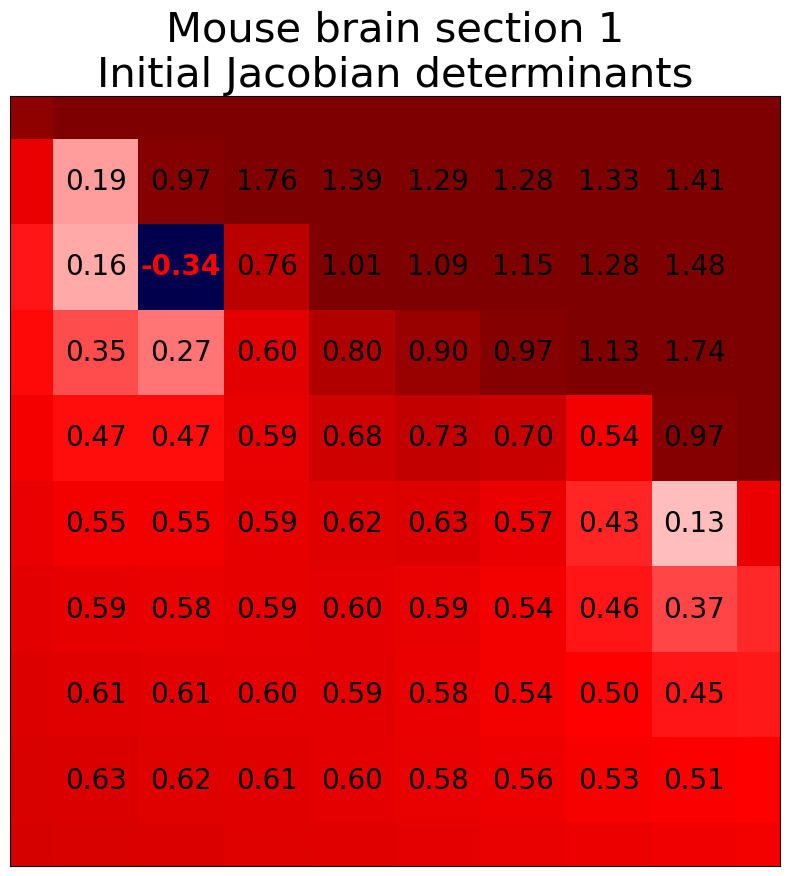

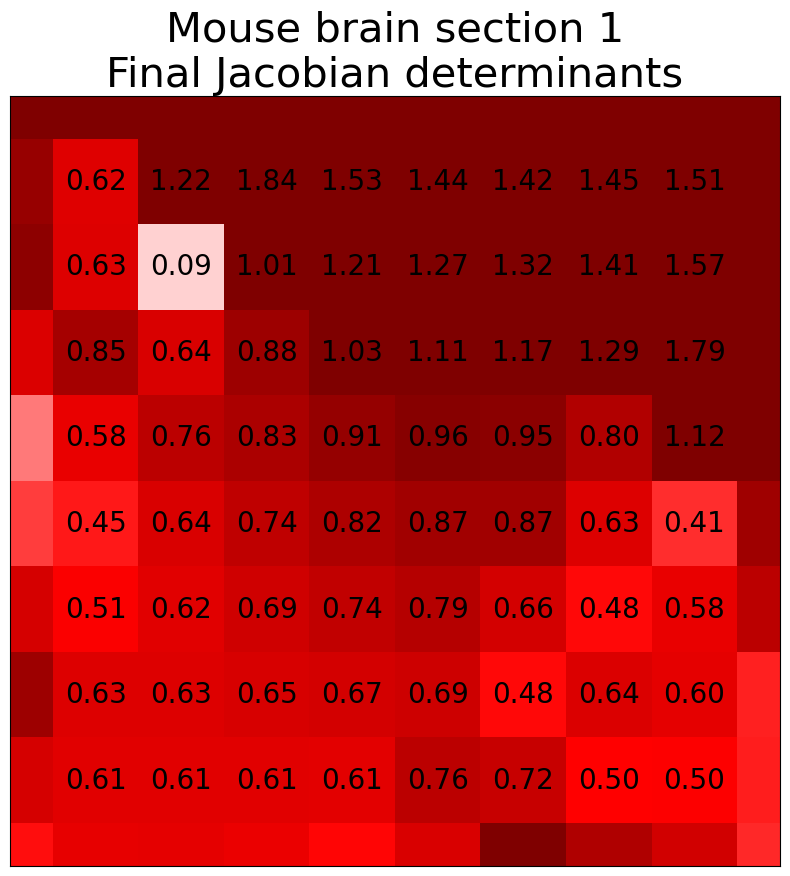

In [ ]:
# For 200:
# ylim = (79, 88)
# xlim = (275, 284)

# For 350:
# (235, 242)
# (197, 204)

# For 500:
# 84 92
# 119 127

ylim = (79, 88)
xlim = (275, 284)

jacobian_plot(d_moving, figsize=(10, 10), 
              title="Mouse brain section 1\nInitial Jacobian determinants",
              ylim=ylim, 
              xlim=xlim, 
              binarize_negatives=True)

jacobian_plot(d_expanded, figsize=(10, 10), 
              title="Mouse brain section 1\nFinal Jacobian determinants",
              ylim=ylim, 
              xlim=xlim, 
              binarize_negatives=True)

[128.9535277  48.       ]
[129.17436679  49.        ]
[129.29865094  50.        ]
[129.3350037  51.       ]
[129.28736784  52.        ]
[129.14947294  53.        ]
[128.91267271  54.        ]
[128.95240683 151.        ]
[129.1737329 152.       ]
[129.29831179 153.        ]
[129.33484044 154.        ]
[129.28729902 155.        ]
[129.14944713 156.        ]
[128.91266519 157.        ]
[131.02890368  48.        ]
[131.29692796  49.        ]
[131.4325478  50.       ]
[131.47084831  51.        ]
[131.42336078  52.        ]
[131.2771472  53.       ]
[130.99448885  54.        ]
[131.02799229 151.        ]
[131.29642269 152.        ]
[131.43228395 153.        ]
[131.47071894 154.        ]
[131.42330401 155.        ]
[131.27712646 156.        ]
[130.9944822 157.       ]
[133.27881428  48.        ]
[133.55938654  49.        ]
[133.67052441  50.        ]
[133.69933597  51.        ]
[133.66542056  52.        ]
[133.54759786  53.        ]
[133.25694227  54.        ]
[133.2782622 151.       ]
[133.5

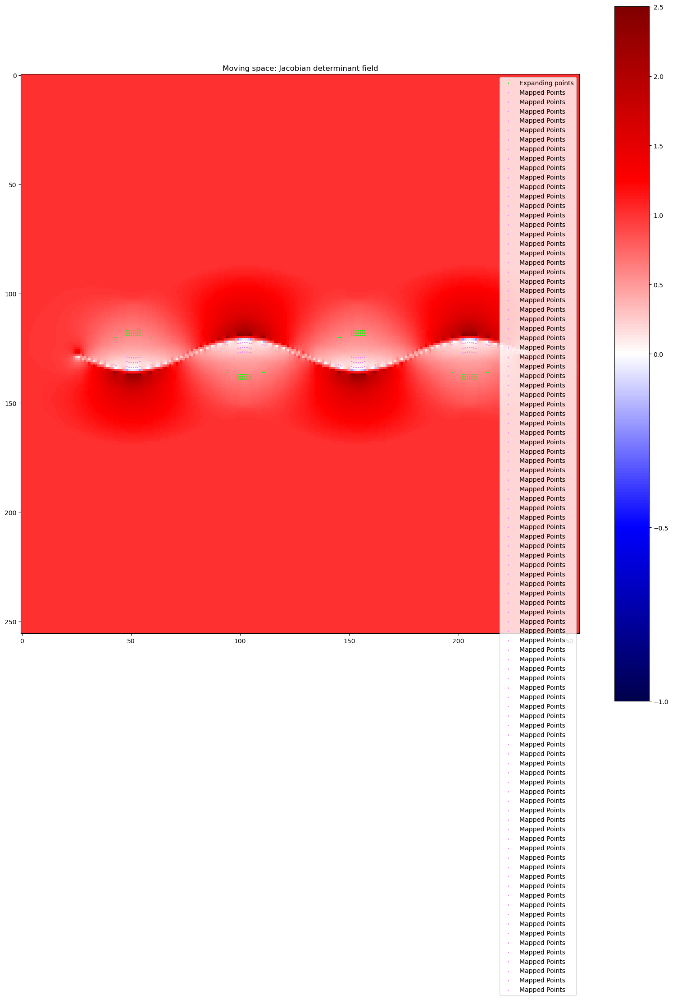

In [ ]:
###### Visualize the Jacobian determinant field with J > thresh ######
plt.figure(figsize=(20, 20))
jdet_field = d_moving.jdet_field.copy()
norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())

plt.imshow(jdet_field, cmap='seismic', norm=norm)
plt.colorbar()
# Connect moving and fixed points
plt.scatter(new_mpoints[:, 2], new_mpoints[:, 1], c='lime', s=1, label='Expanding points')

for m in new_mpoints[:]:
    m = m.copy()
    m -= np.array([0, 0, 0])  # Adjust to (y, x) format
    mapped_point = get_mapped_point(m[1:], d_fixed.deformation)
    #print(f"Fixed point: {m[1:]} -> displacement: {get_displacement(m[1:], d_fixed.deformation)[1:]}, \tmapped point: {get_mapped_point(m[1:], d_fixed.deformation)}, \tjacobian: {d_fixed.jdet_field[m[1], m[2]]}")
    #print(mapped_point)
    plt.scatter(mapped_point[1], mapped_point[0], c='violet', s=1, label='Mapped Points')

plt.title(f"Moving space: Jacobian determinant field")
#plt.legend()
plt.show()

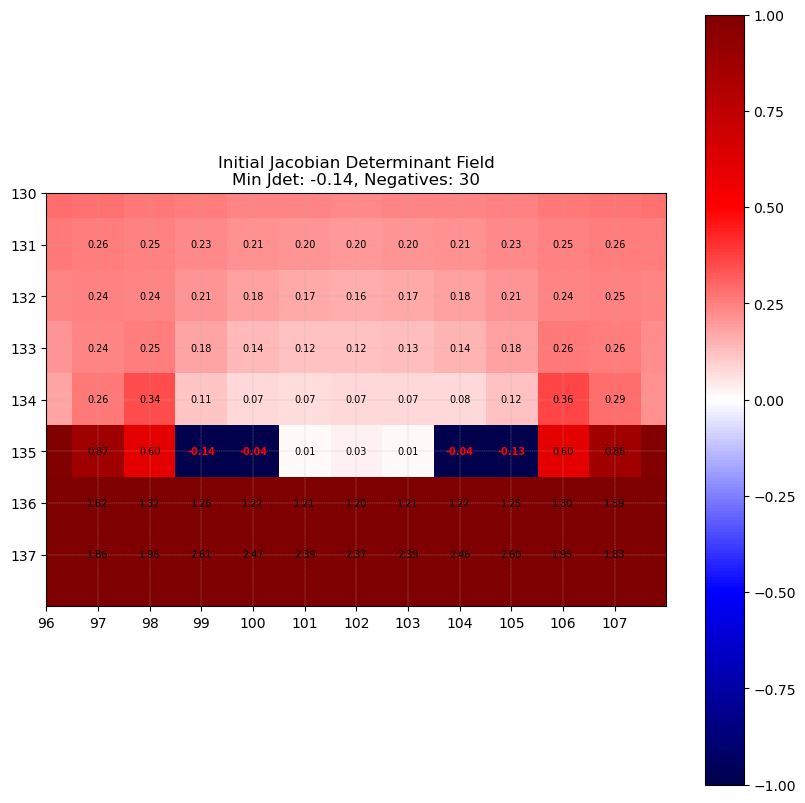

Point [135  98]
Displacement: [-14.00178662   0.        ]
Mapped point: [120.99821338  98.        ].

Point [135  99]
Displacement: [-14.65564734   0.        ]
Mapped point: [120.34435266  99.        ].

Point [135 100]
Displacement: [-14.89165503   0.        ]
Mapped point: [120.10834497 100.        ].

Point [135 101]
Displacement: [-14.98287846   0.        ]
Mapped point: [120.01712154 101.        ].

Point [135 102]
Displacement: [-15.00833411   0.        ]
Mapped point: [119.99166589 102.        ].

Point [135 103]
Displacement: [-14.98533487   0.        ]
Mapped point: [120.01466513 103.        ].

Point [135 104]
Displacement: [-14.89575819   0.        ]
Mapped point: [120.10424181 104.        ].

Point [135 105]
Displacement: [-14.66028857   0.        ]
Mapped point: [120.33971143 105.        ].

Point [135 106]
Displacement: [-14.00178662   0.        ]
Mapped point: [120.99821338 106.        ].



In [72]:
correspondence_pt = (136, 206)  # Point of interest for correspondence

jacobian_plot(d_expanded, pt=correspondence_pt, figsize=(10, 10), 
              title="Initial Jacobian Determinant Field\nMin Jdet: {:.2f}, Negatives: {}".format(d_expanded.min(), d_expanded.count_negatives()),
              xlim=(96, 108), 
              ylim=(130, 138), 
              binarize_negatives=True)

pts = np.array([
    [135, 98],
    [135, 99],
    [135, 100],
    [135, 101],
    [135, 102],
    [135, 103],
    [135, 104],
    [135, 105],
    [135, 106],
])

pts[:, 0] += 0

for pt in pts:
    print(f"Point {pt}")
    print(f"Displacement: {get_displacement(pt, d_expanded.deformation)[1:]}")
    print(f"Mapped point: {get_mapped_point(pt, d_expanded.deformation)}.")
    print()

In [5]:
pt = (136, 206)

pt = np.array(pt)
print("Current point:\t\t", pt)
print("Mapped point:\t\t", get_mapped_point(pt, d_fixed.deformation))

print("\nDisplacement:\t\t", get_displacement(pt, d_fixed.deformation)[1:])

upscaled_displacement = get_displacement(pt * 3, upscaled_fixed[1:])
upscaled_displacement_1 = get_displacement((pt[0] * 3 + 1, pt[1] * scale), upscaled_fixed[1:])
upscaled_displacement_2 = get_displacement((pt[0] * 3 + 2, pt[1] * scale), upscaled_fixed[1:])
upscaled_displacement_3 = get_displacement((pt[0] * 3 + 3, pt[1] * scale), upscaled_fixed[1:])

print("Upscaled displacement:\t", get_displacement(pt * 3, upscaled_fixed[1:]))
print("Upscaled displacement + 1:\t", get_displacement((pt[0] * 3 + 1, pt[1] * scale), upscaled_fixed[1:]))
print("Upscaled displacement + 2:\t", get_displacement((pt[0] * 3 + 2, pt[1] * scale), upscaled_fixed[1:]))
print("Upscaled displacement + 3:\t", get_displacement((pt[0] * 3 + 3, pt[1] * scale), upscaled_fixed[1:]))


# Verify the differences
upscaled_displacement_diff = upscaled_displacement_1 - upscaled_displacement
upscaled_displacement_diff2 = upscaled_displacement_2 - upscaled_displacement_1
upscaled_displacement_diff3 = upscaled_displacement_3 - upscaled_displacement_2

print("\nDifferences in upscaled displacements:")
print("Difference + 1:\t", upscaled_displacement_diff)
print("Difference + 2:\t", upscaled_displacement_diff2)
print("Difference + 3:\t", upscaled_displacement_diff3)


pt = (137, 206)

pt = np.array(pt)
print("\n\nCurrent point:\t\t", pt)
print("Mapped point:\t\t", get_mapped_point(pt, d_fixed.deformation))

print("\nDisplacement:\t\t", get_displacement(pt, d_fixed.deformation)[1:])
print("Upscaled displacement:\t", get_displacement(pt * 3, upscaled_fixed[1:]))

Current point:		 [136 206]
Mapped point:		 [120.00358152 206.        ]

Displacement:		 [-15.99641848   0.        ]
Upscaled displacement:	 [-15.99641848   0.        ]
Upscaled displacement + 1:	 [-15.97254359   0.        ]
Upscaled displacement + 2:	 [-15.58979985   0.        ]
Upscaled displacement + 3:	 [-14.6705409   0.       ]

Differences in upscaled displacements:
Difference + 1:	 [0.02387489 0.        ]
Difference + 2:	 [0.38274374 0.        ]
Difference + 3:	 [0.91925894 0.        ]


Current point:		 [137 206]
Mapped point:		 [122.3294591 206.       ]

Displacement:		 [-14.6705409   0.       ]
Upscaled displacement:	 [-14.6705409   0.       ]


Setup the original 256x256 points


=== Creating Double Helix for Point Correspondence ===
Created double helix with 206 points per wave
Grid size: 256x256
Padding: 25 pixels on each side
Number of cycles: 2
Phase offset: 3.142 radians (180.0 degrees)
Wave 1 - X range: [25, 230], Y range: [120, 136]
Wave 2 - X range: [25, 230], Y range: [120, 136]
Number of intersection points: 10
(206, 3) (206, 3)


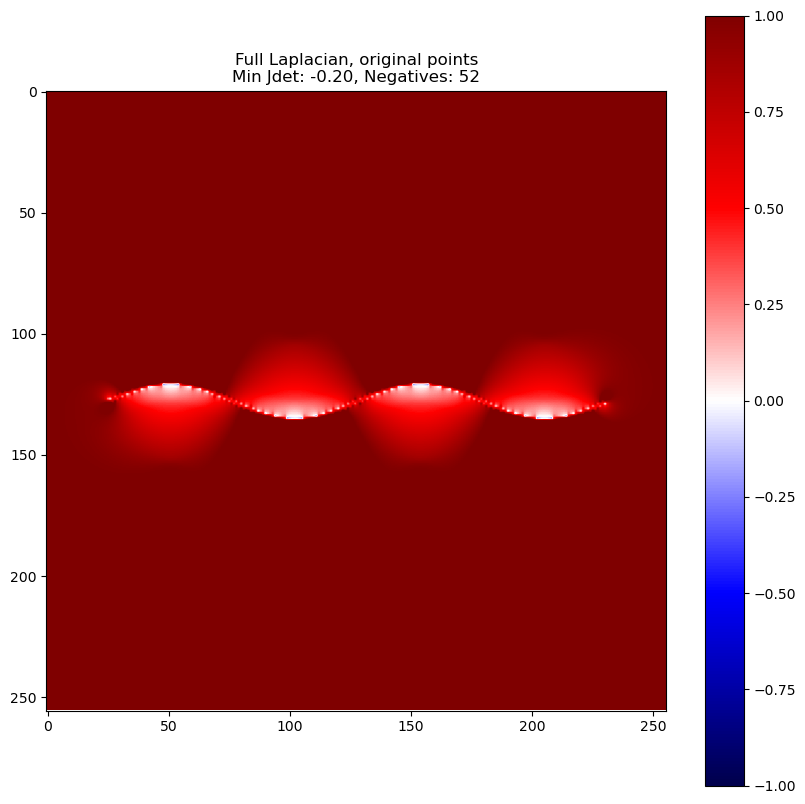

Plotted 206 point correspondences
Set 1 - X range: [75.0, 690.0], Y range: [360.0, 408.0]
Set 2 - X range: [75.0, 690.0], Y range: [360.0, 408.0]
Correspondence distances - Mean: 29.36, Std: 14.50, Max: 48.00


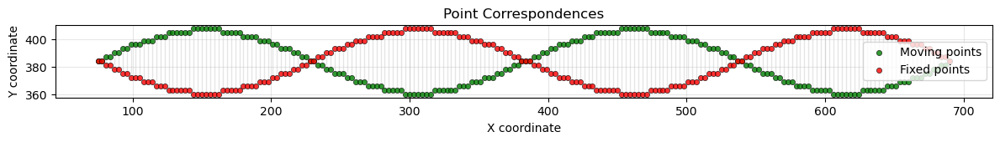

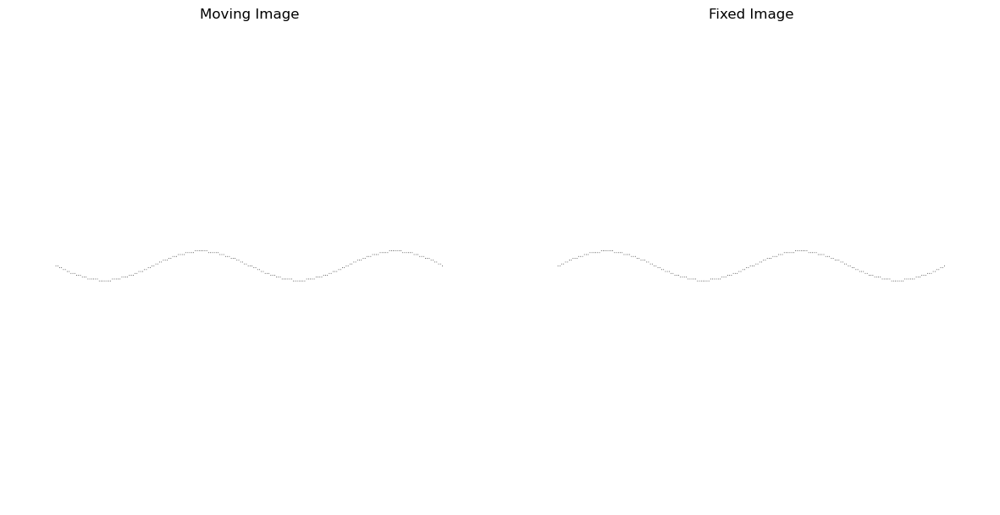

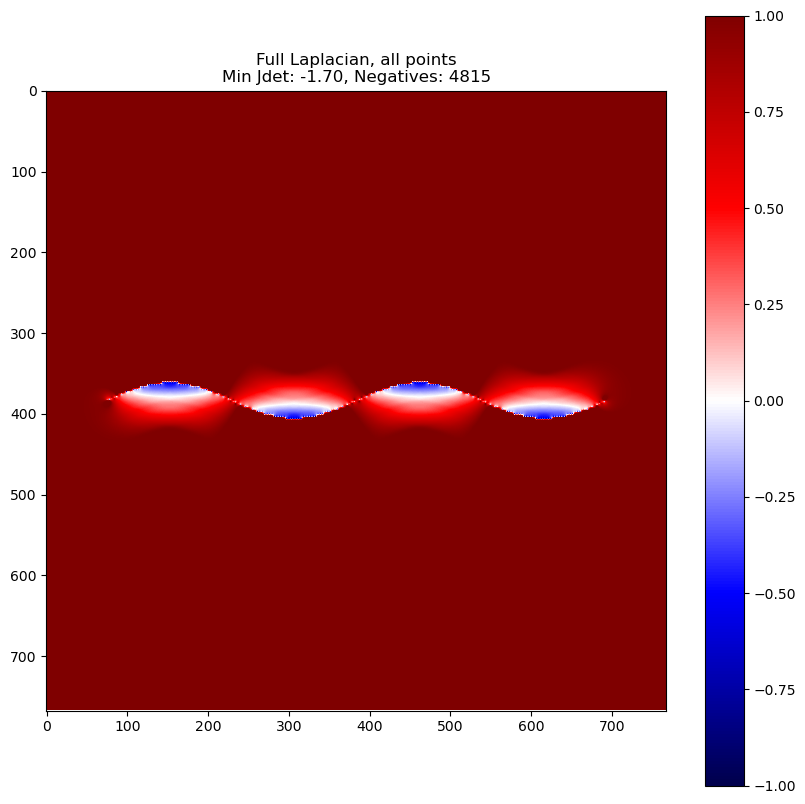

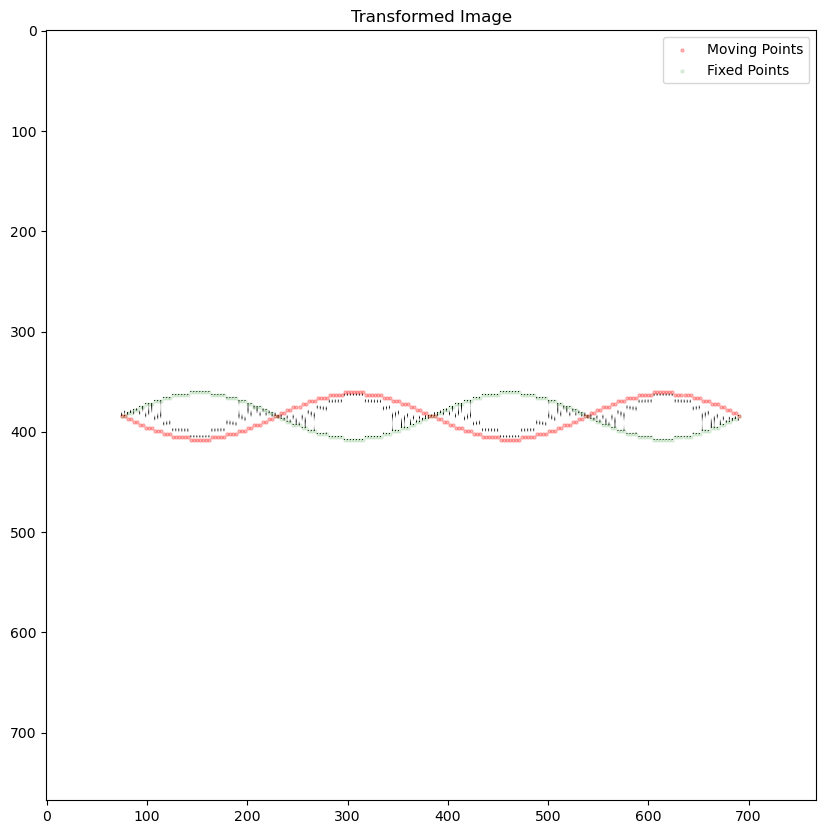

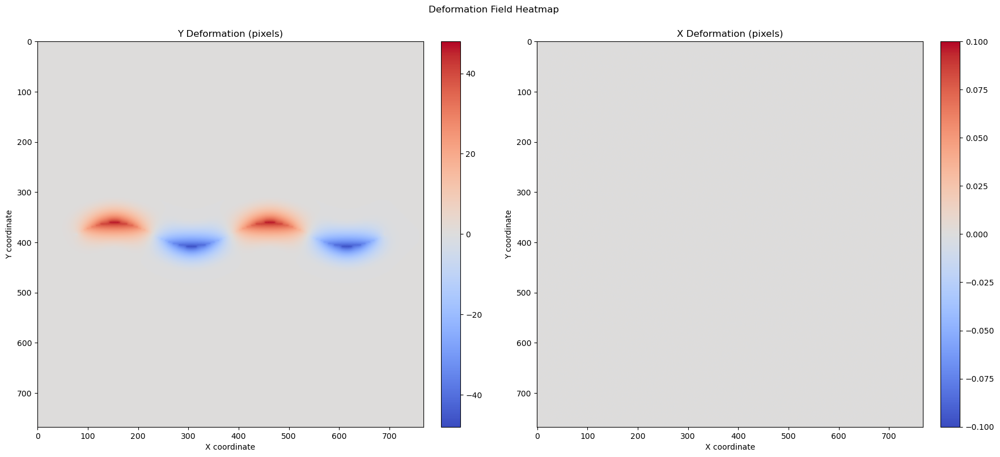

fdata.shape (1, 768, 768)
Time taken to create A:  0.13652276992797852
||Ax - b||: 4.63
Mean error at correspondences: 33.50464576697938


In [6]:
resolution = (256 * 3, 256 * 3)  # resolution for the data

#####################################################################################################
# SETUP 
#####################################################################################################

# Create a specific double helix for correspondence analysis
print("\n=== Creating Double Helix for Point Correspondence ===")
original_mpoints, original_fpoints, _ = data_utils.create_double_helix_waves(
    grid_size=256,
    num_cycles=2,
    amplitude_ratio=0.03,
    phase_offset=np.pi,  # 180 degrees for maximum separation
    padding_ratio=0.1,
    plot=False, horizontal=False,  # Set horizontal to False for vertical helix
)

# Scale the points up by a factor of 3 to fit a larger image resolution
mpoints = original_mpoints.copy() * 3
fpoints = original_fpoints.copy() * 3

# Swap columns to match expected format (x, y)
original_mpoints = original_mpoints[:, [1, 0]]  # Swap to (y, x) format
original_fpoints = original_fpoints[:, [1, 0]]  # Swap to (y, x) format 

# Add 0s on the first axis to format for Data class
original_mpoints = np.pad(original_mpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)
original_fpoints = np.pad(original_fpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)

#original_mpoints = np.vstack([original_mpoints, np.array([0, 119, 206])])
#original_fpoints = np.vstack([original_fpoints, np.array([0, 134, 206])])

print(original_mpoints.shape, original_fpoints.shape)

d_original = Data(original_mpoints, original_fpoints, (256, 256))
d_original.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10),
       title=f"Full Laplacian, original points\nMin Jdet: {d_original.min():.2f}, Negatives: {d_original.count_negatives()}")

# Plot the correspondences between the two helical waves
data_utils.plot_point_correspondences(mpoints, fpoints,
                          labels=('Moving points', 'Fixed points'),
                          colors=('green', 'red'),
                          title='Point Correspondences',
                          show_indices=False,
                          line_alpha=0.2,  # More transparent lines to show the pattern better
                          point_size=20)

# Swap columns to match expected format (x, y)
mpoints = mpoints[:, [1, 0]]  # Swap to (y, x) format
fpoints = fpoints[:, [1, 0]]  # Swap to (y, x) format 

# Add 0s on the first axis to format for Data class
mpoints = np.pad(mpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)
fpoints = np.pad(fpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)

# Save to raw image
moving_img = data_utils.create_raw_image(mpoints, resolution, save_path="mpoints.png")
fixed_img = data_utils.create_raw_image(fpoints, resolution, save_path="fpoints.png")
data_utils.show_2_pngs(moving_img, fixed_img, title1="Moving Image", title2="Fixed Image")

#####################################################################################################
# Run Laplacian
#####################################################################################################

d = Data(mpoints, fpoints, resolution)  # Use larger resolution to fit the scaled points

d.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10),
       title=f"Full Laplacian, all points\nMin Jdet: {d.min():.2f}, Negatives: {d.count_negatives()}")
transformed_img = reg_utils.apply_transformation_fixed(d, moving_img, mpoints=d.mpoints, fpoints=d.fpoints, title="Transformed Image")
reg_utils.deformation_heatmap(d, title="Deformation Field Heatmap")

_, _, _, total_err = reg_utils.compute_error_fixed(d.resolution, mpoints, fpoints, d.deformation)
print(f"||Ax - b||: {total_err:.2f}")
errors = reg_utils.correspondence_error(d.deformation, mpoints, fpoints)
print("Mean error at correspondences:", np.mean(errors))
#rint("Max error at correspondences:", np.max(errors))


In [43]:
d_original.mpoints[181]

array([  0, 120, 206])

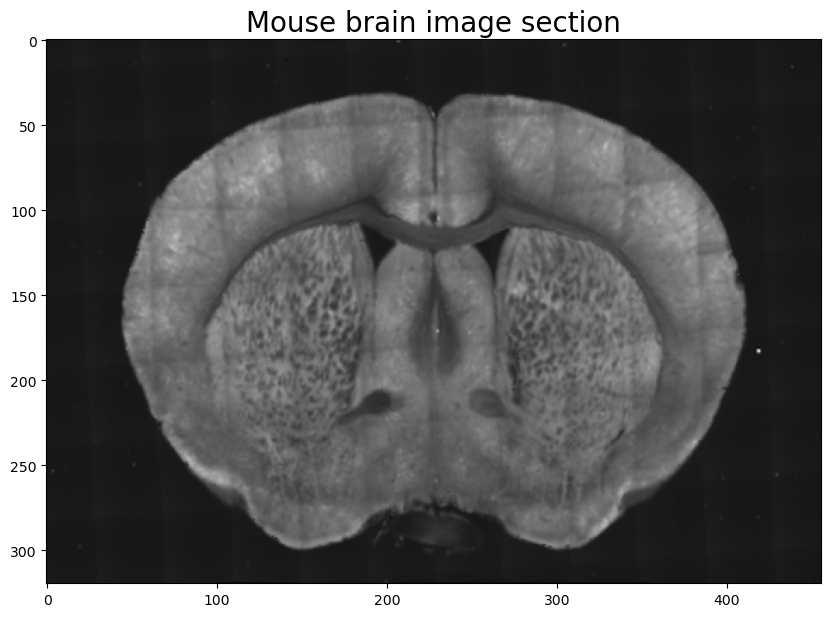

In [204]:
import nibabel as nib
mouse_brain_img = nib.load("data/corrected_correspondences_count_touching/registered_output/elastixRefined.nii.gz").get_fdata()
plt.figure(figsize=(10, 10))
plt.imshow(mouse_brain_img[200, :, :], cmap='gray')
plt.title("Mouse brain image section", fontsize=20)
plt.show()

## Grid interpolation

In [3]:
import numpy as np
from scipy.interpolate import griddata
import matplotlib.pyplot as plt

def interpolate_coordinates(moving_points, fixed_points, jdet_field=None, grid_shape=(10, 10)):
    """
    Interpolates fixed point coordinates over a full grid from sparse moving-to-fixed correspondences.

    Args:
        moving_points: (N, 2) array of [y, x] source positions.
        fixed_points: (N, 2) array of [y', x'] target positions.
        grid_shape: (Y, X) shape of the output grid.

    Returns:
        interpolated_coords: (Y, X, 2) array of interpolated [y', x'] at each grid coordinate.
    """
    Y, X = grid_shape
    grid_y, grid_x = np.meshgrid(np.arange(Y), np.arange(X), indexing='ij')
    grid_coords = np.stack([grid_y.ravel(), grid_x.ravel()], axis=-1)

    interpolated_coords = np.zeros((Y * X, 2), dtype=np.float32)

    for i in range(2):  # y', x'
        interp = griddata(
            moving_points, fixed_points[:, i],
            grid_coords, method='linear', fill_value=np.nan
        )
        # Fallback to grid coordinate if interpolation failed
        fallback = grid_coords[:, i]
        interpolated_coords[:, i] = np.where(np.isnan(interp), fallback, interp)

    interp_coords = interpolated_coords.reshape(Y, X, 2)
    # Move last axis to first
    return np.moveaxis(interp_coords, -1, 0)  # (2, Y, X) shape for [y', x'] coordinates


def print_coord_list(label, coords, grid_shape, precision=1):
    """
    Print a list of sparse coordinates (either moving or fixed) in grid format.

    Args:
        label: string to label the print (e.g., "Moving Points")
        coords: (N, 2) array of coordinates [y, x]
        grid_shape: (Y, X) dimensions of the grid
        precision: number of decimal digits
    """
    Y, X = grid_shape
    coord_map = {tuple(p): i for i, p in enumerate(coords)}
    print(f"\n{label}:\n")
    for y in range(Y):
        row = []
        for x in range(X):
            key = (y, x)
            if key in coord_map:
                i = coord_map[key]
                val = coords[i]
                entry = f"({val[0]:.{precision}f},{val[1]:.{precision}f})"
            else:
                entry = " " * (7 + 2 * precision)
            row.append(entry)
        print("  ".join(row))


def print_interpolated_coords_grid(mapped_coords, precision=1):
    """
    Print the interpolated coordinate grid in [y', x'] format.

    Args:
        mapped_coords: (Y, X, 2) interpolated coordinates
        precision: decimal digits to show
    """
    Y, X, _ = mapped_coords.shape
    print("\nInterpolated Coordinates Grid [y', x']:\n")
    for y in range(Y):
        row = []
        for x in range(X):
            yv, xv = mapped_coords[y, x]
            entry = f"({yv:.{precision}f},{xv:.{precision}f})"
            row.append(entry)
        print("  ".join(row))
        

def print_fixed_at_moving(label, moving_points, fixed_points, grid_shape, precision=1):
    """
    Print a grid where the positions of moving_points are filled with the corresponding fixed_points.
    All other grid cells are blank.

    Args:
        label: string to label the printout
        moving_points: (N, 2) array of [y, x]
        fixed_points: (N, 2) array of [y', x']
        grid_shape: (Y, X)
        precision: decimal digits to display
    """
    Y, X = grid_shape
    print(f"\n{label}:\n")
    move_to_fixed = {tuple(m): fixed_points[i] for i, m in enumerate(moving_points)}
    for y in range(Y):
        row = []
        for x in range(X):
            key = (y, x)
            if key in move_to_fixed:
                val = move_to_fixed[key]
                entry = f"({val[0]:.{precision}f},{val[1]:.{precision}f})"
            else:
                entry = " " * (7 + 2 * precision)
            row.append(entry)
        print("  ".join(row))

### Small test

In [4]:
import csv
import numpy as np

def interpolate_coordinates(moving_points, fixed_points, grid_shape=(10, 10), scale=1):
    """
    Interpolates fixed point coordinates over a full grid from sparse moving-to-fixed correspondences.
    Optionally upscales the grid and points by an integer scale factor before interpolation.

    Args:
        moving_points: (N, 2) array of [y, x] source positions.
        fixed_points: (N, 2) array of [y', x'] target positions.
        grid_shape: (Y, X) shape of the output grid.
        scale: int, optional. If >1, upscales the grid and points by this factor before interpolation.

    Returns:
        interp_coords: (2, Y*scale, X*scale) array of interpolated [y', x'] at each grid coordinate.
    """
    Y, X = grid_shape
    if scale > 1:
        # Upscale grid shape
        Y_up, X_up = Y * scale, X * scale
        # Upscale points
        moving_points_up = moving_points * scale
        fixed_points_up = fixed_points * scale
        # New grid
        grid_y, grid_x = np.meshgrid(np.arange(Y_up), np.arange(X_up), indexing='ij')
        grid_coords = np.stack([grid_y.ravel(), grid_x.ravel()], axis=-1)
    else:
        Y_up, X_up = Y, X
        moving_points_up = moving_points
        fixed_points_up = fixed_points
        grid_y, grid_x = np.meshgrid(np.arange(Y), np.arange(X), indexing='ij')
        grid_coords = np.stack([grid_y.ravel(), grid_x.ravel()], axis=-1)

    interpolated_coords = np.zeros((Y_up * X_up, 2), dtype=np.float32)

    for i in range(2):  # y', x'
        interp = griddata(
            moving_points_up, fixed_points_up[:, i],
            grid_coords, method='linear', fill_value=np.nan
        )
        fallback = np.nan
        interpolated_coords[:, i] = np.where(np.isnan(interp), fallback, interp)

    interp_coords = interpolated_coords.reshape(Y_up, X_up, 2)
    # Move last axis to first: (2, Y_up, X_up)
    return np.moveaxis(interp_coords, -1, 0)  # (2, Y_up, X_up) shape for [y', x'] coordinates

def export_interpolated_grid_to_csv(interp_coords, scale, filename="interpolated_grid.csv"):
    """
    Export the interpolated coordinates grid to a CSV file.

    Args:
        interp_coords: np.ndarray, shape (2, Y, X), interpolated coordinates.
        scale: int or float, scaling factor used for the grid.
        filename: str, output CSV file name.
    """
    Y, X = interp_coords.shape[1], interp_coords.shape[2]
    with open(filename, "w", newline="") as csvfile:
        writer = csv.writer(csvfile)
        # Write column headers (x-axis)
        header = ["y/x"] + [f"{x/scale:.2f}" for x in range(X)]
        writer.writerow(header)
        # Write each row
        for y in range(Y):
            row = [f"{y/scale:.2f}"]
            for x in range(X):
                yv = interp_coords[1, y, x] / scale
                xv = interp_coords[0, y, x] / scale
                if np.isnan(yv) or np.isnan(xv):
                    entry = ""
                else:
                    entry = f"({yv:.1f},{xv:.1f})"
                row.append(entry)
            writer.writerow(row)
    print(f"Exported interpolated grid to {filename}")
    
    
def plot_point_correspondences(points1, points2, 
                              points3=None, points4=None,
                              labels=None, colors=None, 
                              line_alpha=0.3, point_size=30, figsize=(12, 8),
                              title="Point Correspondences", show_indices=False):
    """
    Plot two sets of points with lines connecting corresponding points by index.
    
    Parameters:
    -----------
    points1 : numpy.ndarray
        First set of points, shape (N, 2) with (x, y) coordinates
    points2 : numpy.ndarray  
        Second set of points, shape (N, 2) with (x, y) coordinates
    labels : tuple, optional
        Labels for the two point sets, e.g., ('Set A', 'Set B')
    colors : tuple, optional
        Colors for the two point sets, e.g., ('red', 'blue')
    line_alpha : float, default=0.3
        Transparency of correspondence lines
    point_size : int, default=30
        Size of the plotted points
    figsize : tuple, default=(12, 8)
        Figure size
    title : str, default="Point Correspondences"
        Plot title
    show_indices : bool, default=False
        Whether to show point indices as text annotations
        
    Returns:
    --------
    fig, ax : matplotlib figure and axes objects
    """
    
    # Ensure points are numpy arrays
    points1 = np.array(points1)
    points2 = np.array(points2)
    
    # Check that both sets have the same number of points
    if len(points1) != len(points2):
        print(f"Warning: Point sets have different lengths ({len(points1)} vs {len(points2)})")
        min_len = min(len(points1), len(points2))
        points1 = points1[:min_len]
        points2 = points2[:min_len]
        print(f"Using first {min_len} points from each set")
    
    # Set default labels and colors
    if labels is None:
        labels = ('Points Set 1', 'Points Set 2', 'Points Set 3', 'Points Set 4')
    if colors is None:
        colors = ('red', 'blue', 'green', 'orange')
    
    # Create the plot
    fig = plt.figure(figsize=figsize)
    
    # Draw correspondence lines first (so they appear behind points)
    for i in range(len(points1)):
        plt.plot([points1[i, 0], points2[i, 0]], 
                [points1[i, 1], points2[i, 1]], 
                'gray', alpha=line_alpha, linewidth=1, zorder=1)
        
    # Draw expansion lines first (so they appear behind points)
    if points3 is not None and points4 is not None:
        for i in range(len(points3)):
            plt.plot([points3[i, 0], points4[i, 0]], 
                    [points3[i, 1], points4[i, 1]], 
                    'red', alpha=line_alpha, linewidth=1, zorder=1)
    
    # Plot the points
    scatter1 = plt.scatter(points1[:, 0], points1[:, 1], 
                         c=colors[0], s=point_size, alpha=0.8, 
                         label=labels[0], zorder=3, edgecolors='black', linewidth=0.5)
    scatter2 = plt.scatter(points2[:, 0], points2[:, 1], 
                         c=colors[1], s=point_size, alpha=0.8, 
                         label=labels[1], zorder=3, edgecolors='black', linewidth=0.5)
    if points3 is not None:
        scatter3 = plt.scatter(points3[:, 0], points3[:, 1], 
                             c=colors[2], s=point_size, alpha=0.8, 
                             label=labels[2], zorder=3, edgecolors='black', linewidth=0.5)
    if points4 is not None:
        scatter4 = plt.scatter(points4[:, 0], points4[:, 1], 
                             c=colors[3], s=point_size, alpha=0.8, 
                             label=labels[3], zorder=3, edgecolors='black', linewidth=0.5)
    
    # Add point indices if requested
    if show_indices:
        for i in range(len(points1)):
            plt.annotate(f'{i}', (points1[i, 0], points1[i, 1]), 
                       xytext=(5, 5), textcoords='offset points', 
                       fontsize=8, alpha=0.7, color=colors[0])
            plt.annotate(f'{i}', (points2[i, 0], points2[i, 1]), 
                       xytext=(5, 5), textcoords='offset points', 
                       fontsize=8, alpha=0.7, color=colors[1])
    
    # Formatting
    plt.title(title, fontsize=20)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.gca().invert_yaxis()  # Invert y-axis to match image coordinates
    plt.show()
    
    return fig


import numpy as np
from scipy.ndimage import zoom

def upscale_grid_values(grid, scale=3, order=1):
    """
    Upscale a 2D grid of values by a given scale factor using interpolation.

    Args:
        grid: (H, W) array of values (e.g., image or field).
        scale: int, upscaling factor.
        order: int, interpolation order (1=linear, 3=cubic, etc.).

    Returns:
        upscaled_grid: (H*scale, W*scale) array of interpolated values.
    """
    H, W = grid.shape
    upscaled = zoom(grid, zoom=scale, order=order)
    for y in range(H):
        for x in range(W):
            upscaled[y*scale, x*scale] = grid[y, x]
    return upscaled


def upscale_grid_with_priors(grid, scale=3):
    H, W = grid.shape
    H2, W2 = H * scale, W * scale
    upscaled = np.zeros((H2, W2), dtype=grid.dtype)

    # Copy original values to upscaled grid
    for y in range(H):
        for x in range(W):
            upscaled[y*scale, x*scale] = grid[y, x]

    # Interpolate missing values (bilinear)
    for y2 in range(H2):
        for x2 in range(W2):
            if (y2 % scale == 0) and (x2 % scale == 0):
                continue  # already filled
            # Map to original grid coordinates
            y = y2 / scale
            x = x2 / scale
            y0 = int(np.floor(y))
            x0 = int(np.floor(x))
            y1 = min(y0 + 1, H - 1)
            x1 = min(x0 + 1, W - 1)
            wy = y - y0
            wx = x - x0
            v00 = grid[y0, x0]
            v01 = grid[y0, x1]
            v10 = grid[y1, x0]
            v11 = grid[y1, x1]
            upscaled[y2, x2] = (
                (1 - wy) * (1 - wx) * v00 +
                (1 - wy) * wx * v01 +
                wy * (1 - wx) * v10 +
                wy * wx * v11
            )
    return upscaled[:-scale + 1, :-scale + 1]  # Crop to original grid size


def boundary_points_on_grid(shape):
    """
    Generate (y, x) points on the boundary of a grid of given shape.
    Returns an (N, 2) array of (y, x) coordinates.
    """
    Y, X = shape
    points = []
    # Top and bottom rows
    for x in range(X):
        points.append((0, 0, x))
        points.append((0, Y - 1, x))
    # Left and right columns (excluding corners already added)
    for y in range(1, Y - 1):
        points.append((0, y, 0))
        points.append((0, y, X - 1))
    return np.array(points)

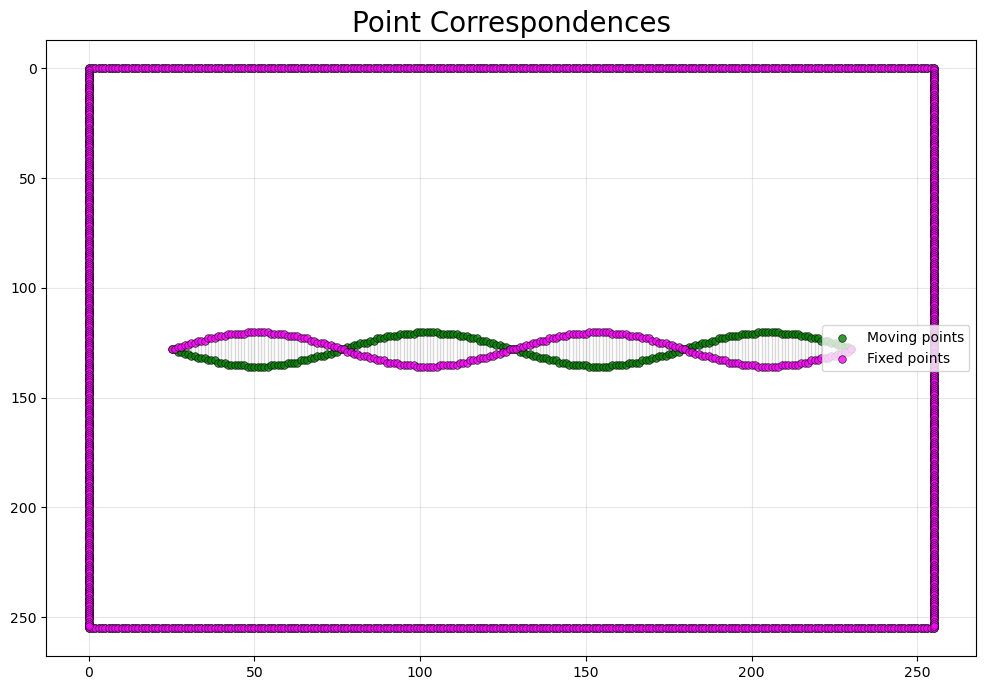

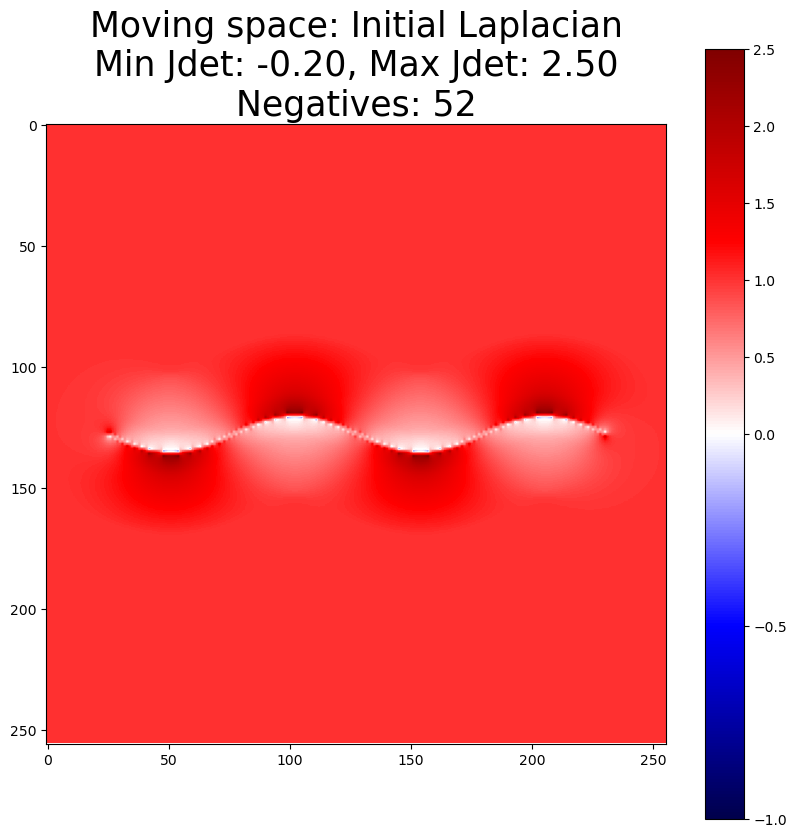

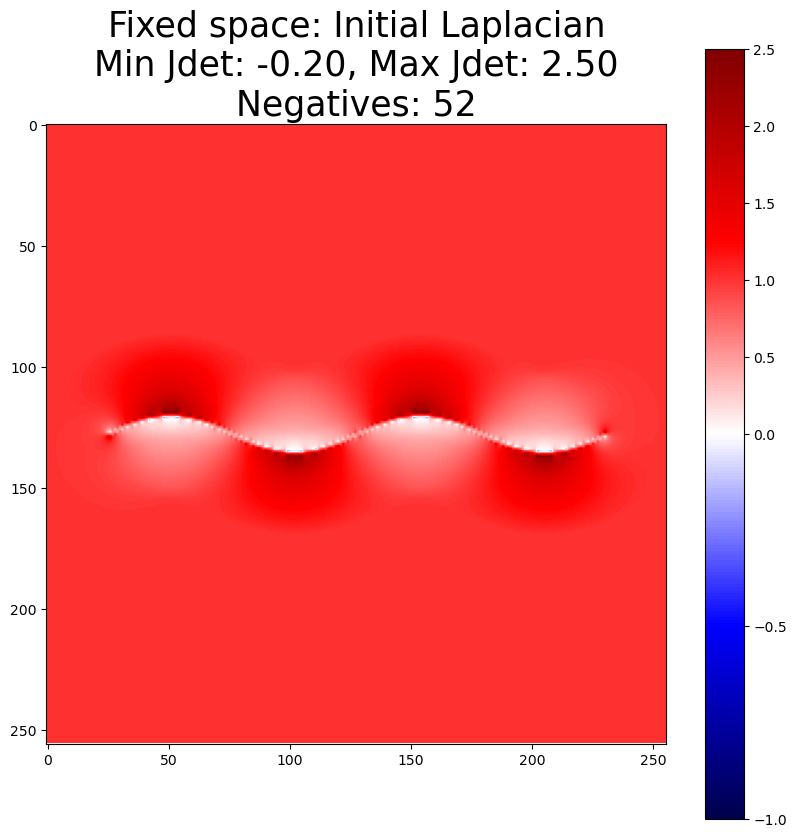

Found 2587 expanding Jacobian determinants with threshold 1.3.


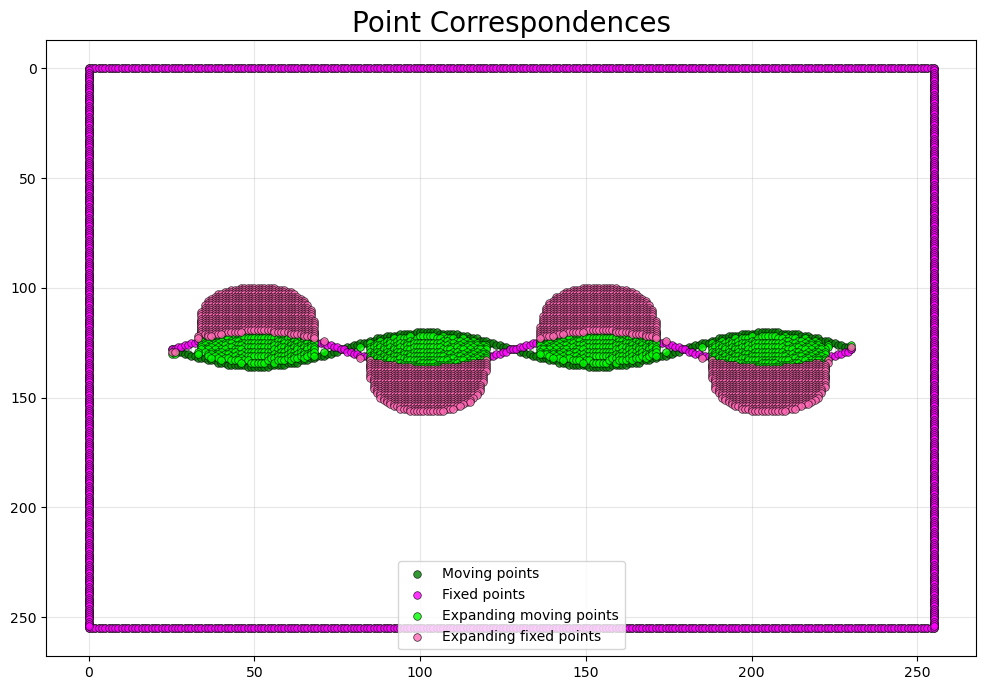


Interpolated coordinates throughout the grid:
y - ↓, x ->
	  0.00				  0.33				  0.67				  1.00				  1.33				  1.67				  2.00				  2.33				  2.67				  3.00				  3.33				  3.67				  4.00				  4.33				  4.67				  5.00				  5.33				  5.67				  6.00				  6.33				  6.67				  7.00				  7.33				  7.67				  8.00				  8.33				  8.67				  9.00				  9.33				  9.67				  10.00				  10.33				  10.67				  11.00				  11.33				  11.67				  12.00				  12.33				  12.67				  13.00				  13.33				  13.67				  14.00				  14.33				  14.67				  15.00				  15.33				  15.67				  16.00				  16.33				  16.67				  17.00				  17.33				  17.67				  18.00				  18.33				  18.67				  19.00				  19.33				  19.67				  20.00				  20.33				  20.67				  21.00				  21.33				  21.67				  22.00				  22.33				  22.67				  23.00				  23.33				  23.67				  24.00				  24.33				  24.67				  25.00				  25.33				  25.67				  26.00				  26.33				  26.67				  27.00				  27.33				  27.67				  28.00				  28.33				  28.67				  29.00				  

In [ ]:
scale = 3
jdet_threshold = 1.3
sanity_check = 9999
resolution = (256, 256)

################################################################################################

"""
mpoints, fpoints, _ = data_utils.create_double_helix_waves(
    grid_size=20,
    num_cycles=1,
    amplitude_ratio=0.2,
    phase_offset=np.pi,  # 180 degrees for maximum separation
    padding_ratio=0.1,
    plot=False, horizontal=False,  # Set horizontal to False for vertical helix
)
"""

mpoints, fpoints, _ = data_utils.create_double_helix_waves(
    grid_size=min(resolution),
    num_cycles=2,
    amplitude_ratio=0.03,
    phase_offset=np.pi,  # 180 degrees for maximum separation
    padding_ratio=0.1,
    plot=False, horizontal=False,  # Set horizontal to False for vertical helix
)

interp_coords = interpolate_coordinates(fpoints, mpoints, grid_shape=resolution, scale=scale)

mpoints = mpoints[:, [1, 0]]  # Swap to (y, x) format
fpoints = fpoints[:, [1, 0]]  # Swap to (y, x) format 


# Add 0s on the first axis to format for Data class
mpoints = np.pad(mpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)
fpoints = np.pad(fpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)


# Make moving and fixed points on the image boundaries
boundary_points = boundary_points_on_grid(resolution)
mpoints = np.vstack([mpoints, boundary_points])
fpoints = np.vstack([fpoints, boundary_points])

_ = plot_point_correspondences(mpoints[:, [2, 1]], fpoints[:, [2, 1]], labels=('Moving points', 'Fixed points'), colors=('green', 'magenta'))

# Create data classes
d_fixed = Data(mpoints, fpoints, resolution)  # 256x256 grid (320x456 for the real data)
d_moving = Data_Moving(mpoints, fpoints, resolution)
d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Moving space: Initial Laplacian\nMin Jdet: {d_moving.min():.2f}, Max Jdet: {np.max(d_moving.jdet_field):.2f}\nNegatives: {d_moving.count_negatives()}")
d_fixed.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
         title=f"Fixed space: Initial Laplacian\nMin Jdet: {d_fixed.min():.2f}, Max Jdet: {np.max(d_fixed.jdet_field):.2f}\nNegatives: {d_fixed.count_negatives()}")

expanding_fcoord = get_expanding_coordinates(d_fixed.jdet_field, threshold=jdet_threshold, verbose=False)

# Remove points that occur in the fixed points set
expanding_fcoord = np.array([coord for coord in expanding_fcoord if tuple(coord) not in set(map(tuple, d_moving.fpoints[:, 1:]))])
expanding_mcoord = []
for i in range(len(expanding_fcoord)):
    mapped_point = get_mapped_point(expanding_fcoord[i], d_fixed.deformation)
    expanding_mcoord.append(mapped_point)
expanding_mcoord = np.array(expanding_mcoord)

# Append 0 to the first axis to format for Data class
expanding_mcoord = np.pad(expanding_mcoord, ((0, 0), (1, 0)), mode='constant', constant_values=0)
expanding_fcoord = np.pad(expanding_fcoord, ((0, 0), (1, 0)), mode='constant', constant_values=0)

# Round all expanding_mcoords to the nearest integer
expanding_mcoord = np.round(expanding_mcoord).astype(int)

#print("Mpoints -> Fpoints:")
#for i in range(len(mpoints)):
#    print(f"{mpoints[i]} -> {fpoints[i]}")

#print(f"Expanding coordinates in fixed space (Jdet > {jdet_threshold}): {expanding_fcoord.shape[0]} points")
#print("Expanding mpoints -> Expanding fpoints:")
#for i in range(len(expanding_fcoord)):
#    print(f"{expanding_mcoord[i]} -> {expanding_fcoord[i]}")
    
_ = plot_point_correspondences(mpoints[:, [2, 1]], fpoints[:, [2, 1]], 
                               expanding_mcoord[:, [2, 1]], expanding_fcoord[:, [2, 1]], 
                               labels=('Moving points', 'Fixed points', 'Expanding moving points', 'Expanding fixed points'), colors=('green', 'magenta', 'lime', 'hotpink'),)

    
    
# Add the expanding points to the moving points
mpoints = np.vstack([mpoints, expanding_mcoord])
fpoints = np.vstack([fpoints, expanding_fcoord])

# Convert mpoints and fpoints to (y, x) format
impoints = mpoints[:, [2, 1]]  # Swap to (y, x) format
ifpoints = fpoints[:, [2, 1]]  # Swap to (y, x) format

ifpoints = []
impoints = []
for y in range(resolution[0]):
    for x in range(resolution[1]):
        #print(f"Current point: ({y}, {x})")
        curr_fpoint = (y, x)
        curr_mpoint = get_mapped_point(curr_fpoint, d_fixed.deformation)
        #print(f"Mapped point: {curr_mpoint}")
        ifpoints.append(curr_fpoint)
        impoints.append(curr_mpoint)
ifpoints = np.array(ifpoints)
impoints = np.array(impoints)

interp_coords = interpolate_coordinates(ifpoints, impoints, grid_shape=resolution, scale=scale)

# Print the interpolated coordinates throughout the grid, including axis numbers
print("\nInterpolated coordinates throughout the grid:\ny - ↓, x ->")

# Print column headers (x-axis)
header = ["\t"] + [f"  {x/scale:.2f}\t\t\t\t" for x in range(interp_coords.shape[2] - scale + 1)]
print("".join(header))

for y in range(interp_coords.shape[1] - scale + 1):
    row = [f"{y/scale:.2f}|"]  # Row header (y-axis)
    for x in range(interp_coords.shape[2] - scale + 1):
        entry = f"\t({abs(interp_coords[0, y, x])/scale:.1f}, {interp_coords[1, y, x]/scale:.1f})"
        if entry == "(nan, nan)\t":
            entry = "    nan\t\t"
        row.append(f"{entry}\t\t")
    print("".join(row))
    
export_interpolated_grid_to_csv(interp_coords, scale=scale, filename="interpolated_grid.csv")

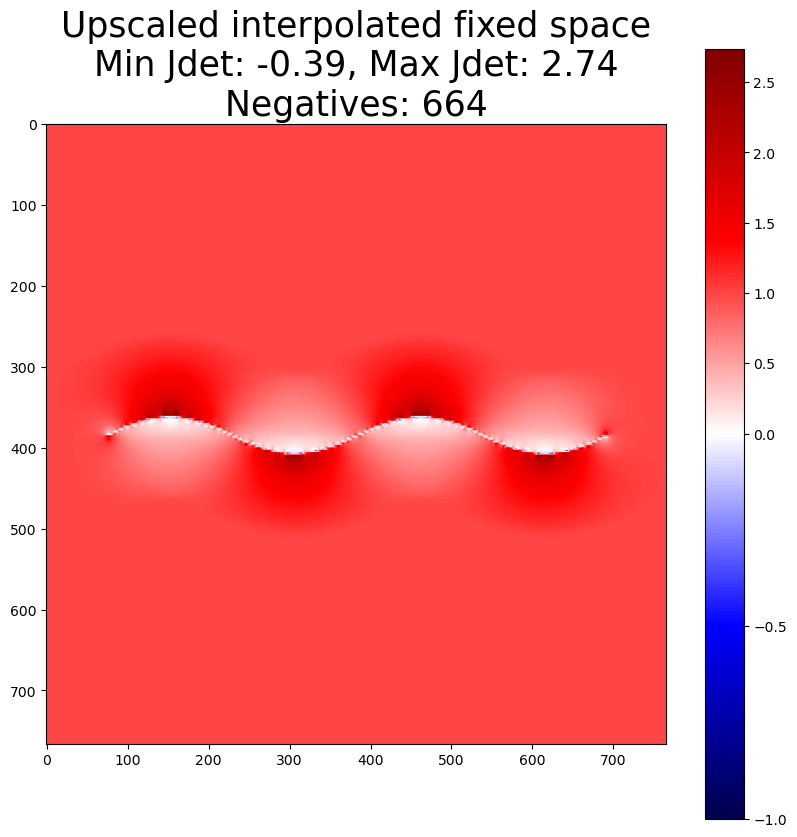

Upscaled fixed Jacobian determinant field shape: (766, 766)
Upscaled fixed deformation shape: (3, 1, 766, 766)


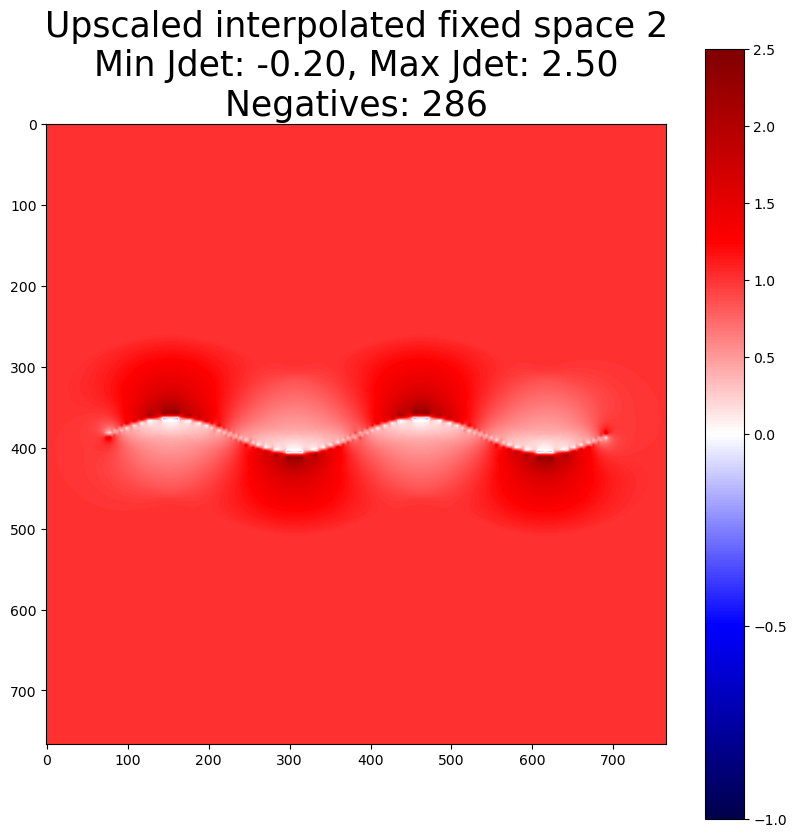

Found 23271 expanding Jacobian determinants with threshold 1.3.
Max jdet attempted to replace: 0.9846623768982955


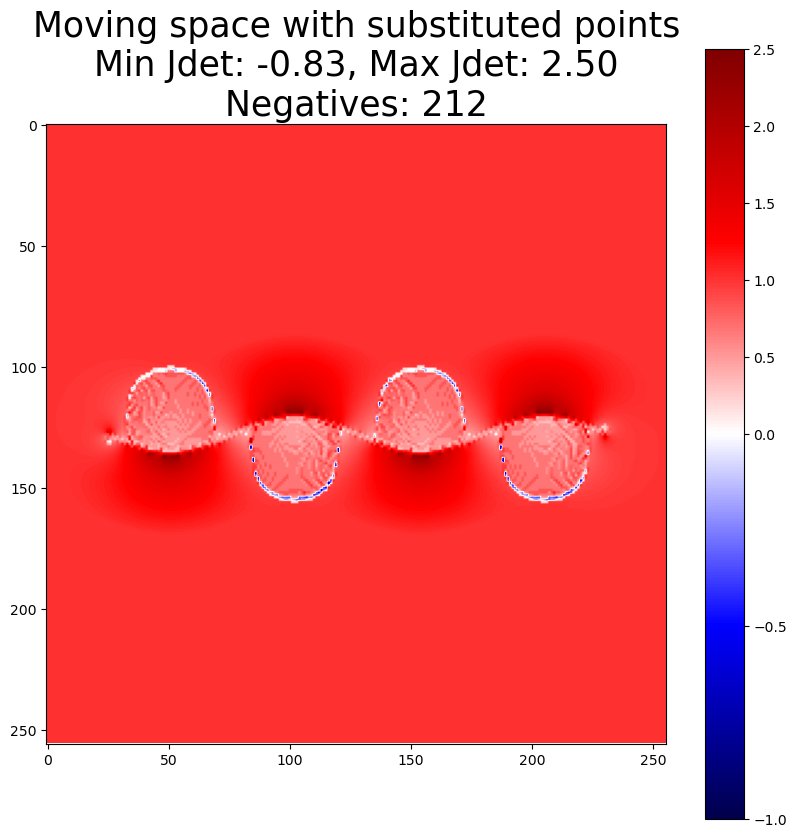

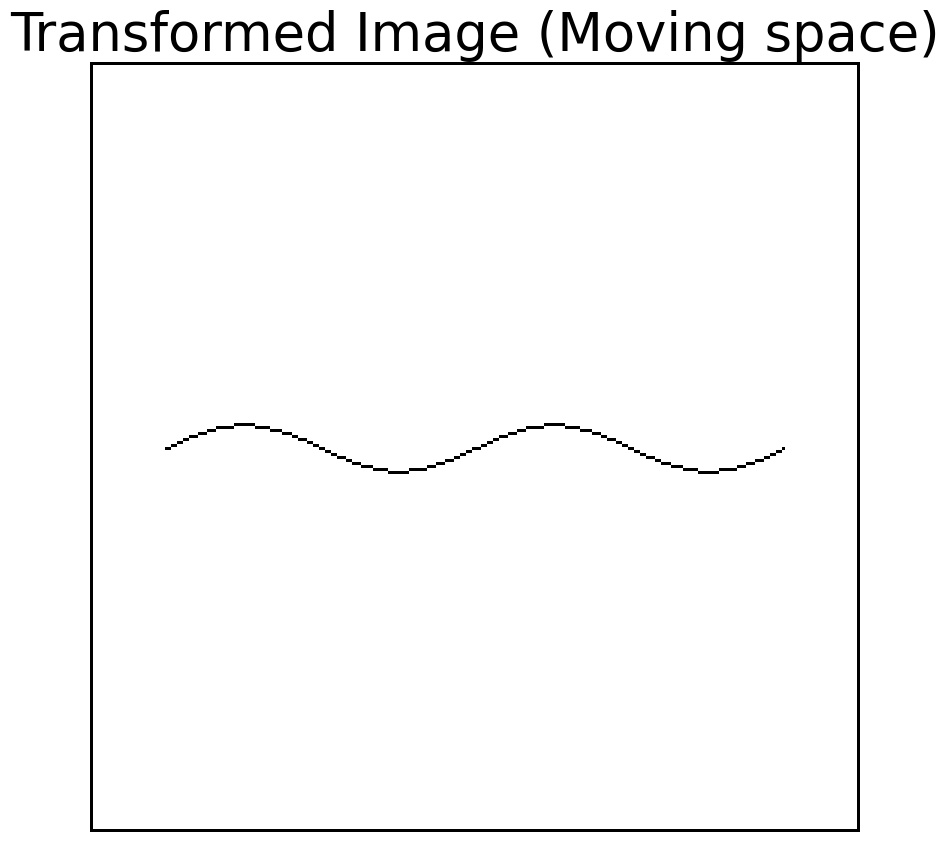

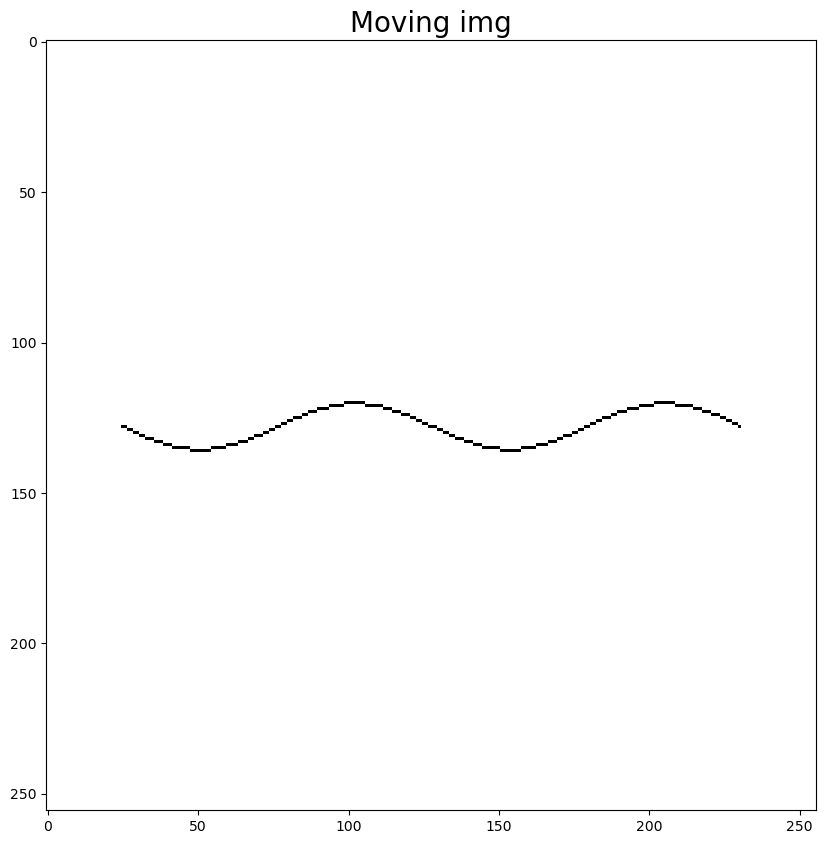

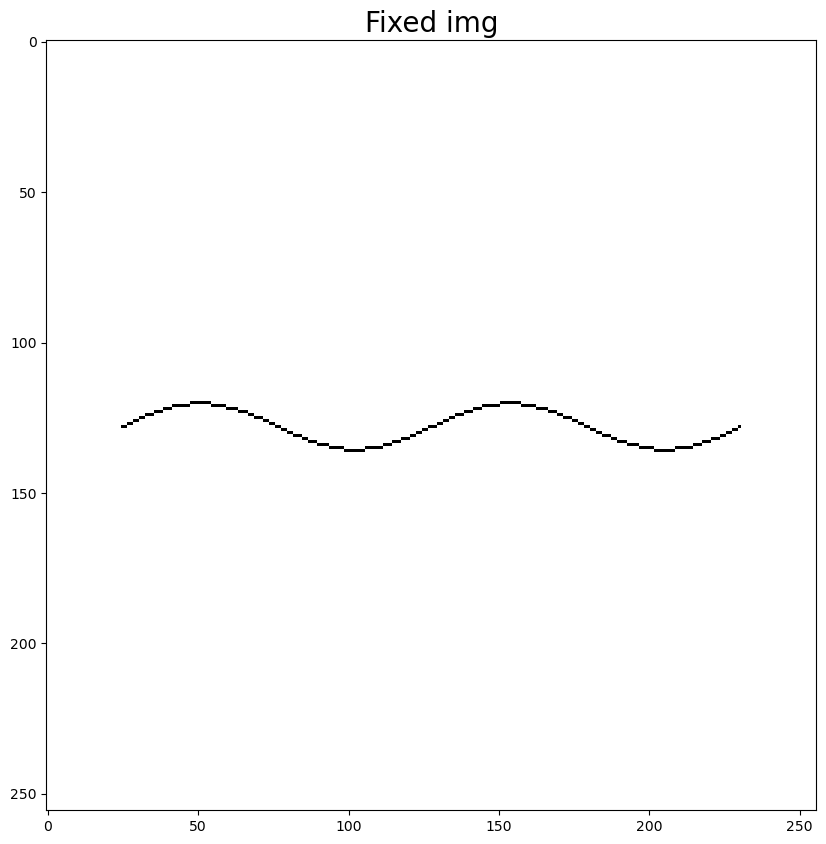

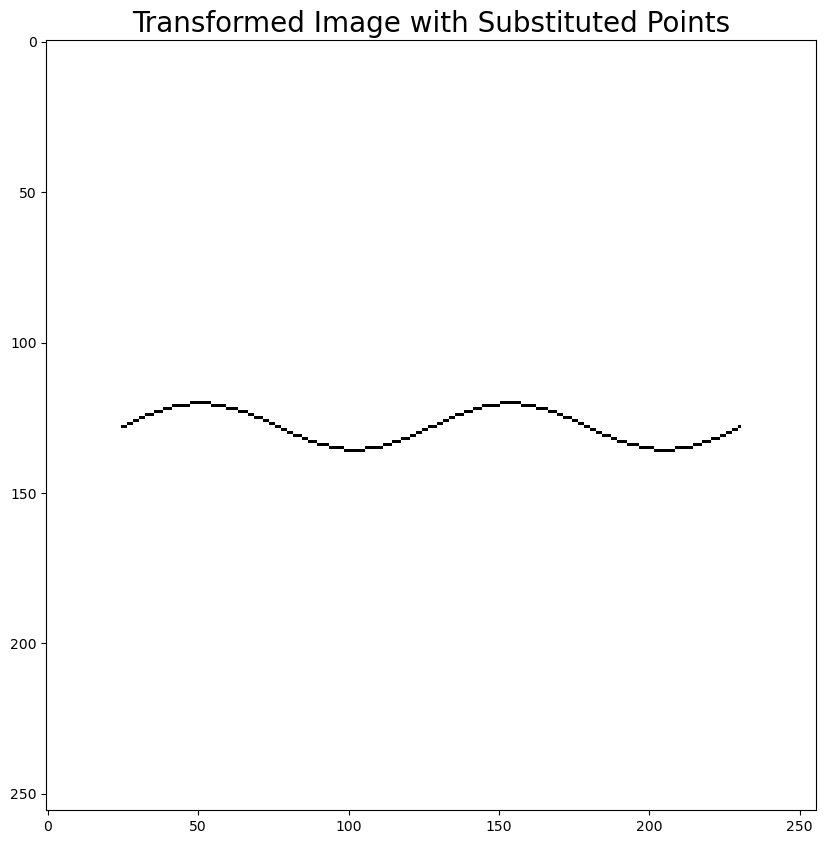

In [31]:
d_upscaled = Data(mpoints, fpoints, (resolution[0] * scale - scale + 1, resolution[1] * scale - scale + 1))  # Use larger resolution to fit the scaled points

# Create displacements to check for Jacobian
interp_displacements = np.zeros((3, 1, resolution[0] * scale - scale + 1, resolution[1] * scale - scale + 1), dtype=np.float32)
for y in range(resolution[0] * scale - scale + 1):
    for x in range(resolution[1] * scale - scale + 1):
        # Moving - fixed
        curr_mpoint = interp_coords[:, y, x]
        interp_displacements[1:, 0, y, x] =  (curr_mpoint - np.array([y, x]))
        
d_upscaled.mpoints = d_upscaled.mpoints.copy() * 3
d_upscaled.fpoints = d_upscaled.fpoints.copy() * 3
d_upscaled.deformation = interp_displacements
d_upscaled.jdet_field = jacobian.sitk_jacobian_determinant(d_upscaled.deformation)[0]
d_upscaled.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Upscaled interpolated fixed space\nMin Jdet: {d_upscaled.min():.2f}, Max Jdet: {np.max(d_upscaled.jdet_field):.2f}\nNegatives: {d_upscaled.count_negatives()}")




upscaled_fixed = upscale_grid_with_priors(d_fixed.jdet_field, scale=3)
print("Upscaled fixed Jacobian determinant field shape:", upscaled_fixed.shape)
print("Upscaled fixed deformation shape:", d_upscaled.deformation.shape)
#norm = mcolors.TwoSlopeNorm(vmin=min(upscaled_fixed.min(), -1), vcenter=0, vmax=upscaled_fixed.max())
#plt.figure(figsize=(10, 10))
#plt.imshow(upscaled_fixed, cmap='seismic')
#plt.title("Upscaled Jacobian Determinant Field", fontsize=20)
#plt.colorbar()
#plt.show()
d_upscaled.jdet_field = upscaled_fixed
d_upscaled.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Upscaled interpolated fixed space 2\nMin Jdet: {d_upscaled.min():.2f}, Max Jdet: {np.max(d_upscaled.jdet_field):.2f}\nNegatives: {d_upscaled.count_negatives()}")


upscaled_jdet = d_upscaled.jdet_field.copy()

# Get coordinates with Jdet > jdet_thresh
upscaled_fpts = get_expanding_coordinates(upscaled_jdet, threshold=jdet_thresh, verbose=False)
upscaled_mpts = np.array([get_mapped_point(pt, d_upscaled.deformation) for pt in upscaled_fpts if pt[0] < upscaled_jdet.shape[0] and pt[1] < upscaled_jdet.shape[1]])

# Print out the upscaled points
#print(f"Upscaled points with Jdet > {jdet_thresh}: {len(upscaled_fpts)} points")
#for i in range(len(upscaled_fpts)):
#    print(f"{np.round(upscaled_mpts[i] / scale).astype(int)} -> {upscaled_fpts[i]/3}")
    
d_sub = deepcopy(d_moving)


#d_sub.jdet_field = np.zeros((resolution[0] * scale - scale + 1, resolution[1] * scale - scale + 1), dtype=np.float32)
max_jdet = -np.inf
#max_px = None
#max_idx = None

for i in range(len(upscaled_mpts)):
    pt = upscaled_fpts[i]
    curr_mpt = np.round(upscaled_mpts[i] / scale).astype(int)
    curr_fpt = upscaled_fpts[i] / scale
    new_displacement = curr_fpt - curr_mpt
    # Append 0 to the first element to match the expected format
    new_displacement = np.pad(new_displacement, (1, 0), mode='constant', constant_values=0)
    
    # Only replace if the point is not in the moving points and if the Jacobian determinant is below 1 
    if not tuple(curr_mpt) in set(map(tuple, d_sub.mpoints[:, 1:])) and d_sub.jdet_field[curr_mpt[0], curr_mpt[1]] < sanity_check:
        d_sub.deformation[:, 0, curr_mpt[0], curr_mpt[1]] = new_displacement
        if max_jdet < d_moving.jdet_field[curr_mpt[0], curr_mpt[1]]:
            max_jdet = d_moving.jdet_field[curr_mpt[0], curr_mpt[1]]
        #z    max_px = upscaled_mpts[i]
        #    max_idx = i
    #if not tuple(curr_mpt) in set(map(tuple, d_sub.mpoints[:, 1:])) and d_sub.jdet_field[curr_mpt[0], curr_mpt[1]] > 1:
    #    d_sub.jdet_field[curr_mpt[0], curr_mpt[1]] = 999
    #else:
    #    d_sub.jdet_field[curr_mpt[0], curr_mpt[1]] = 0
        
# If anything is not 999, set it to 0
#d_sub.jdet_field[d_sub.jdet_field != 999] = 0
print("Max jdet attempted to replace:", max_jdet)
#print("Max px attempted to replace:", max_px)
#print("Max index attempted to replace:", max_idx)
#print("Max index attempted to replace:", upscaled_fpts[max_idx] / 3)
#print("Jdet at max index in fixed space:", upscaled_jdet[max_px[0], max_px[1]])
#print("Jdet at max index in fixed space:", d_fixed.jdet_field[16, 7])
#print("Jdet at max index in fixed space:", upscaled_jdet[16*3, 7*3])


d_sub.jdet_field = jacobian.sitk_jacobian_determinant(d_sub.deformation)[0]
d_sub.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
           title=f"Moving space with substituted points\nMin Jdet: {d_sub.min():.2f}, Max Jdet: {np.max(d_sub.jdet_field):.2f}\nNegatives: {d_sub.count_negatives()}")


# Save to raw image
moving_img = data_utils.create_raw_image(d_fixed.mpoints, resolution, save_path="wave1.png")
fixed_img = data_utils.create_raw_image(d_fixed.fpoints, resolution, save_path="wave2.png")
transformed_img = reg_utils.apply_transformation(d_sub, moving_img, title="Transformed Image (Moving space)")

# Make all values in boundary of transformed_img white
transformed_img[0, :] = 1  # Top boundary
transformed_img[-1, :] = 1  # Bottom boundary
transformed_img[:, 0] = 1  # Left boundary
transformed_img[:, -1] = 1  # Right boundary

moving_img[0, :] = 1  # Top boundary
moving_img[-1, :] = 1  # Bottom boundary
moving_img[:, 0] = 1  # Left boundary
moving_img[:, -1] = 1  # Right boundary

fixed_img[0, :] = 1  # Top boundary
fixed_img[-1, :] = 1  # Bottom boundary
fixed_img[:, 0] = 1  # Left boundary
fixed_img[:, -1] = 1  # Right boundary

plt.figure(figsize=(10, 10))
plt.imshow(moving_img, cmap='gray')
plt.title("Moving img", fontsize=20)
plt.show()

plt.figure(figsize=(10, 10))
plt.imshow(fixed_img, cmap='gray')
plt.title("Fixed img", fontsize=20)
plt.show()

plt.figure(figsize=(10, 10))
plt.imshow(transformed_img, cmap='gray')
plt.title("Transformed Image with Substituted Points", fontsize=20)
plt.show()


(60, 60)


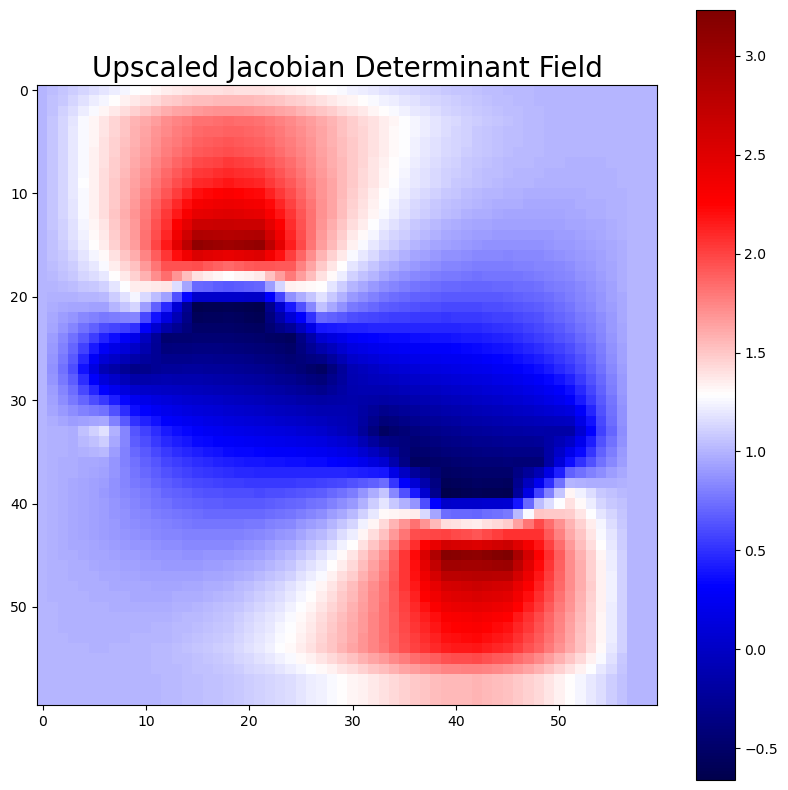

In [ ]:
import numpy as np
from scipy.ndimage import zoom

def upscale_grid_values(grid, scale=3, order=1):
    """
    Upscale a 2D grid of values by a given scale factor using interpolation.

    Args:
        grid: (H, W) array of values (e.g., image or field).
        scale: int, upscaling factor.
        order: int, interpolation order (1=linear, 3=cubic, etc.).

    Returns:
        upscaled_grid: (H*scale, W*scale) array of interpolated values.
    """
    H, W = grid.shape
    upscaled = zoom(grid, zoom=scale, order=order)
    for y in range(H):
        for x in range(W):
            upscaled[y*scale, x*scale] = grid[y, x]
    return upscaled

import numpy as np



upscaled_fixed = upscale_grid_with_priors(d_fixed.jdet_field, scale=3)
print(upscaled_fixed.shape)
norm = mcolors.TwoSlopeNorm(vmin=min(upscaled_fixed.min(), -1), vcenter=0, vmax=upscaled_fixed.max())
plt.figure(figsize=(10, 10))
plt.imshow(upscaled_fixed, cmap='seismic')
plt.title("Upscaled Jacobian Determinant Field", fontsize=20)
plt.colorbar()
plt.show()

In [424]:
d_fixed.jdet_field[10, 10]

-0.1327340636287262

In [425]:
d_upscaled.jdet_field[30, 30]

-0.1792384966461679

In [353]:
print(interp_coords[:, 9, 3]/scale)

[3.5901403 1.       ]


In [344]:
print(d_fixed.deformation[:, 0, 3, 1])

[0.         0.59014024 0.        ]


In [90]:
idx = 120
print(f"Mpoint:", mpoints[idx])
print(f"Fpoint:", fpoints[idx])
print(f"Current deformation:", d_moving.deformation[:, 0, mpoints[idx][1], mpoints[idx][2]])
print(f"Interpolated deformation m:", d_new.deformation[:, 0, mpoints[idx][1], mpoints[idx][2]])
print(f"Interpolated deformation f:", d_new.deformation[:, 0, fpoints[idx][1], fpoints[idx][2]])

Y, X = 256, 256
grid_y, grid_x = np.meshgrid(np.arange(Y), np.arange(X), indexing='ij')
grid_coords = np.stack([grid_y.ravel(), grid_x.ravel()], axis=-1)

interpolated_coords = np.zeros((Y * X, 2), dtype=np.float32)
for i in range(2):
    interp = griddata(
        moving_points, fixed_points[:, i],
        grid_coords, method='linear', fill_value=np.nan
    )
    print(np.max(interp))

Mpoint: [  0 135 145]
Fpoint: [  0 121 145]
Current deformation: [  0.         -13.99686617   0.        ]
Interpolated deformation m: [0. 0. 0.]
Interpolated deformation f: [0. 0. 0.]
nan
nan



=== Creating Double Helix for Point Correspondence ===
Created double helix with 206 points per wave
Grid size: 256x256
Padding: 25 pixels on each side
Number of cycles: 2
Phase offset: 3.142 radians (180.0 degrees)
Wave 1 - X range: [25, 230], Y range: [120, 136]
Wave 2 - X range: [25, 230], Y range: [120, 136]
Number of intersection points: 10
16.0


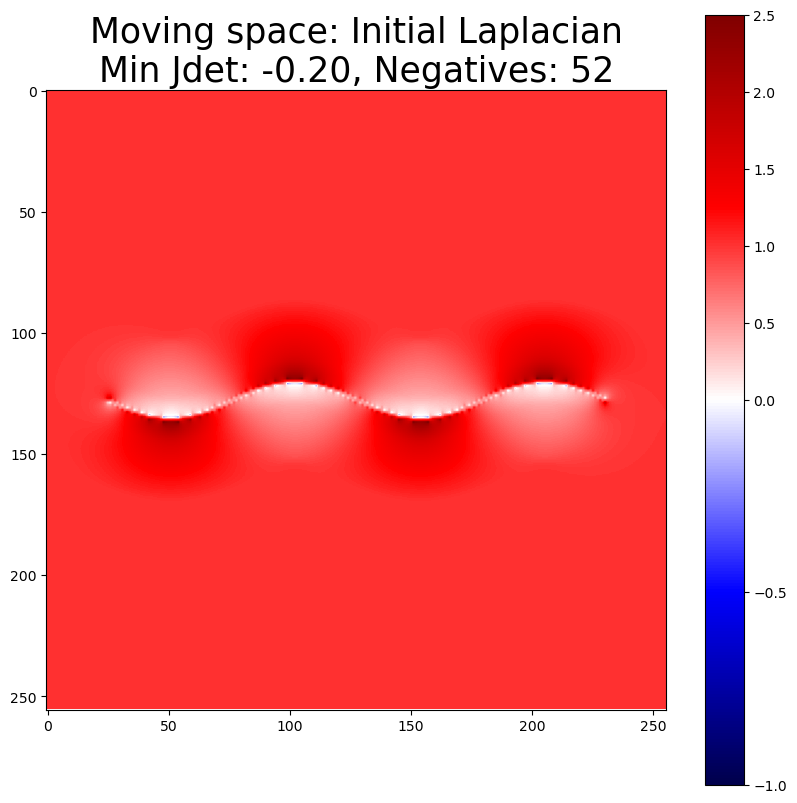

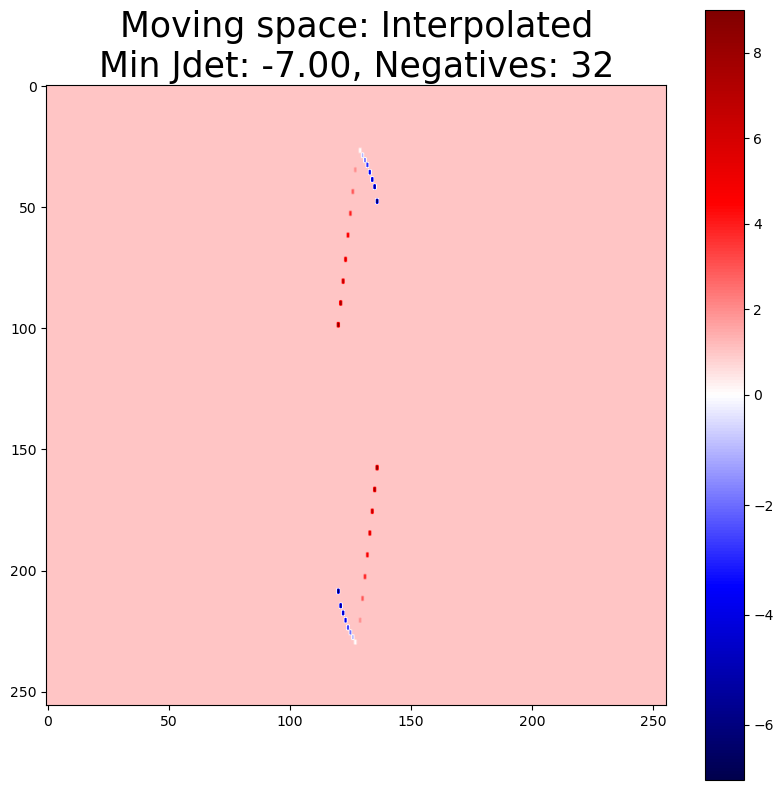

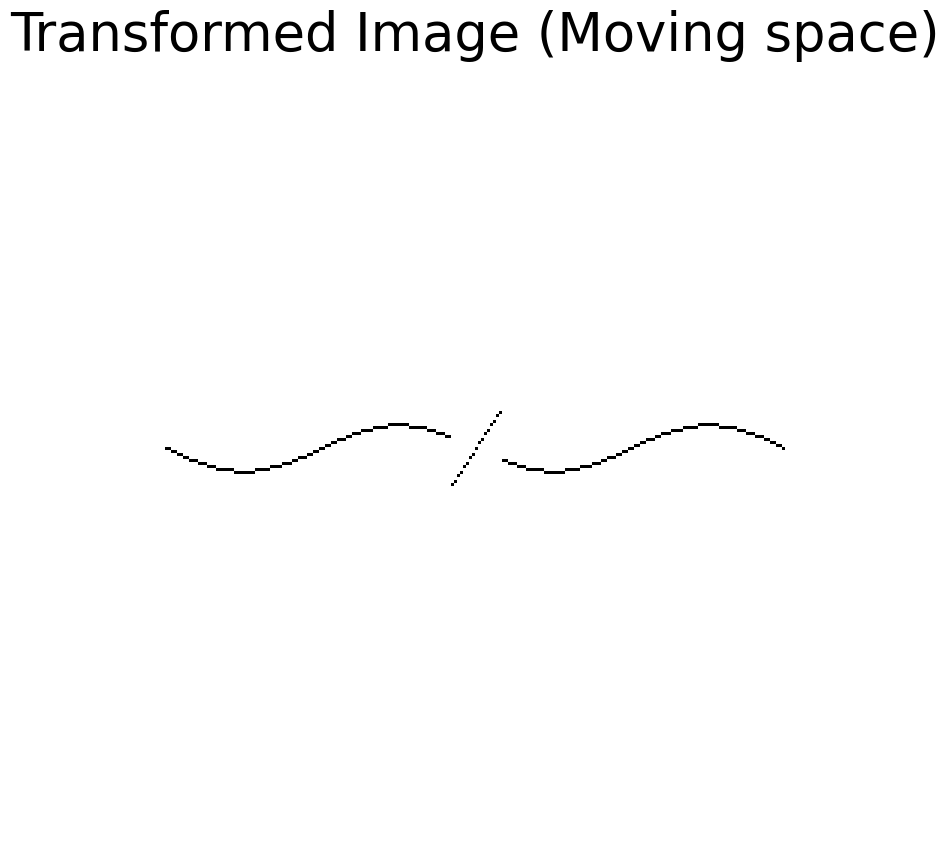

In [91]:
resolution = (256, 256)  # resolution for the data

# Create a specific double helix for correspondence analysis
print("\n=== Creating Double Helix for Point Correspondence ===")
mpoints, fpoints, _ = data_utils.create_double_helix_waves(
    grid_size=256,
    num_cycles=2,
    amplitude_ratio=0.03,
    phase_offset=np.pi,  # 180 degrees for maximum separation
    padding_ratio=0.1,
    plot=False, horizontal=False,  # Set horizontal to False for vertical helix
)

dfield = interpolate_displacements(mpoints, fpoints, grid_shape=resolution)
print(np.max(dfield))

mpoints = mpoints[:, [1, 0]]  # Swap to (y, x) format
fpoints = fpoints[:, [1, 0]]  # Swap to (y, x) format 

# Add 0s on the first axis to format for Data class
mpoints = np.pad(mpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)
fpoints = np.pad(fpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)

# Create data classes
d_fixed = Data(mpoints, fpoints, resolution)  # 256x256 grid (320x456 for the real data)
d_moving = Data_Moving(mpoints, fpoints, resolution)
d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Moving space: Initial Laplacian\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

d_new = deepcopy(d_moving)  # Create a new Data_Moving object to avoid modifying the original
d_new.deformation = dfield  # Assign the interpolated deformation field to the Data_Moving object
d_new.jdet_field = jacobian.sitk_jacobian_determinant(d_new.deformation)[0]
d_new.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Moving space: Interpolated\nMin Jdet: {d_new.min():.2f}, Negatives: {d_new.count_negatives()}")


moving_img = data_utils.create_raw_image(d_moving.mpoints, resolution, save_path="wave1.png")
fixed_img = data_utils.create_raw_image(d_moving.fpoints, resolution, save_path="wave2.png")
transformed_img = reg_utils.apply_transformation(d_new, moving_img, title="Transformed Image (Moving space)")

## Alternative method

I have an optimization problem where I have a discrete grid of pixels, and I am applying a registration problem to it. 

Given correspondence points, which is a set of moving points that map to a set of fixed points, a displacement vector field is computed that gives the displacement of which moving point maps to each fixed point. 

One problem is that some moving points will map to the same fixed point due to floating point displacements and discretization of coordinates into integers. 
This causes issues of folding which is represented by negative Jacobian determinants.

To fix this and reduce the number of negative Jacobian determinants, I want to take the original set of correspondences and upscale them 3x and optimize that grid for displacements. As I go through the upscaled grid, I want to look at the intermediary pixels added by the upscaling and use those displacement values to approximate more correspondences in the original resolution by assigning these points to an approximate pixel correspondence and adding them to the set of correspondences so we can recompute them in the original space with less negative Jacobian determinant values so the displacements of non correspondence pixels won't map to the same points as others or illogical positions. 

We have noticed pixels with higher (greater than 1 Jacobian determinant values) are good candidates to compute this from. 

How would I go about doing this and how would I code this in Python?

___

You're trying to reduce folding (negative Jacobian determinants) in a registration problem on a discrete pixel grid by:

Upscaling the grid (e.g. 3× resolution).

Interpolating new displacement vectors at intermediate pixels in the upscaled space.

Selecting valid interpolated displacements (e.g. from regions with high Jacobian determinants).

Downsampling these new points as additional correspondences.

Recomputing the displacement field in the original resolution with the enriched set of correspondences.



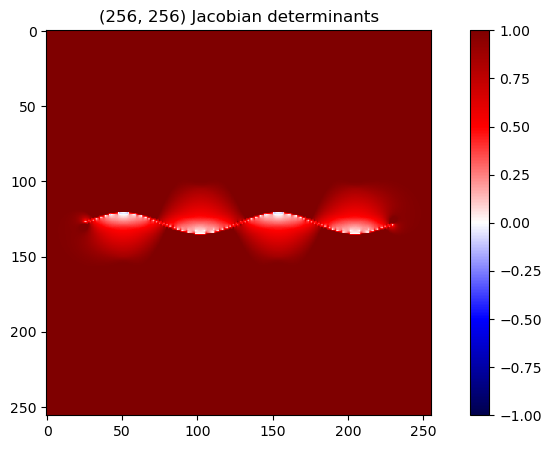

Min Jdet: -0.21, Negatives: 38


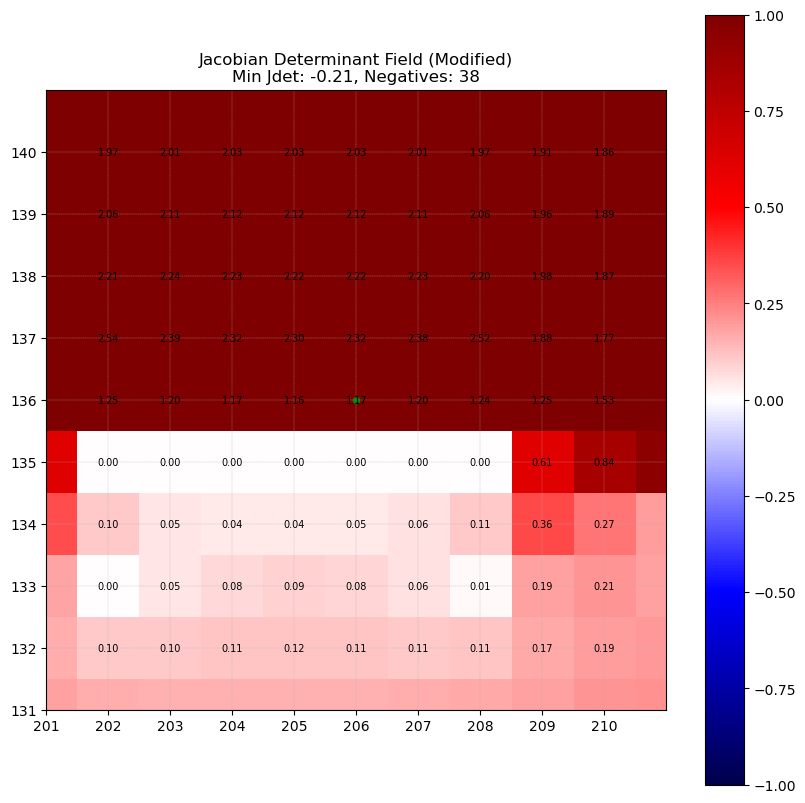

In [282]:
import numpy as np

def get_adjacent_coords(y, x, shape, connectivity=4):
    """Return list of valid adjacent (y, x) coordinates."""
    neighbors = []
    for dy in [-1, 0, 1]:
        for dx in [-1, 0, 1]:
            if dy == 0 and dx == 0:
                continue
            if connectivity == 4 and abs(dy) + abs(dx) != 1:
                continue
            ny, nx = y + dy, x + dx
            if 0 <= ny < shape[0] and 0 <= nx < shape[1]:
                neighbors.append((0, ny, nx))
    return neighbors

def get_adjacent_coords(y, x, shape):
    """
    Return a list of valid adjacent (y, x) coordinates: only above and below.
    """
    neighbors = []
    if y - 1 >= 0:
        neighbors.append((0, y - 1, x))
    if y + 1 < shape[0]:
        neighbors.append((0, y + 1, x))
    return neighbors

# 1. Get negative Jacobian coordinates in original resolution
neg_jac_coords = np.argwhere(d_original.jdet_field < 0)

# 2. Get set of fixed points (as (y, x) tuples)
fixed_coords = set(tuple(pt[1:]) for pt in d_original.fpoints.astype(int))

# 3. For each negative Jdet pixel, add correspondences for all adjacent pixels (not fixed points)
new_mpoints = []
new_fpoints = []
for y, x in neg_jac_coords:
    for nz, ny, nx in get_adjacent_coords(y, x, d_original.jdet_field.shape):
        if (nz, ny, nx) in fixed_coords:
            continue
        # Build new correspondence: moving = (0, ny, nx), fixed = (0, ny + disp_y, nx + disp_x)
        disp = d_original.deformation[:, nz, ny, nx]
        fpt = np.array([nz, ny, nx])
        mpt = np.array([nz, int(round(ny + disp[1])), int(round(nx + disp[2]))])
        new_mpoints.append(mpt)
        new_fpoints.append(fpt)

if new_mpoints:
    new_mpoints = np.vstack(new_mpoints)
    new_fpoints = np.vstack(new_fpoints)
    # Optionally, remove duplicates
    _, idx = np.unique(new_mpoints, axis=0, return_index=True)
    new_mpoints = new_mpoints[idx]
    new_fpoints = new_fpoints[idx]
    # Concatenate with original correspondences
    all_mpoints = np.vstack([d_original.mpoints, new_mpoints])
    all_fpoints = np.vstack([d_original.fpoints, new_fpoints])
else:
    all_mpoints = d_original.mpoints
    all_fpoints = d_original.fpoints

# 4. Recompute the deformation field
d_refined = Data(all_mpoints, all_fpoints, d_original.resolution)
d_refined.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False)
print(f"Min Jdet: {d_refined.min():.2f}, Negatives: {d_refined.count_negatives()}")
#print(new_mpoints)
#print(new_fpoints)

jacobian_plot(d_refined, pt=correspondence_pt, figsize=(10, 10), title="Jacobian Determinant Field (Modified)\nMin Jdet: {:.2f}, Negatives: {}".format(d_refined.min(), d_refined.count_negatives()),
              xlim=(correspondence_pt[1] - 5, correspondence_pt[1] + 5), 
              ylim=(correspondence_pt[0] - 5, correspondence_pt[0] + 5), 
              binarize_negatives=True)

In [49]:
import numpy as np
from scipy.optimize import linear_sum_assignment

def assign_unique_correspondences(fixed_coords, displacements, moving_coords):
    """
    Assign each fixed pixel to a unique moving pixel based on closest displaced location.
    Args:
        fixed_coords: (N, 2) array of (y, x) for fixed pixels
        displacements: (N, 2) array of (dy, dx) for each fixed pixel
        moving_coords: (M, 2) array of (y, x) for moving pixels (candidates)
    Returns:
        assignment: (N,) array, assignment[i] = index in moving_coords assigned to fixed_coords[i]
    """
    # Compute displaced locations for each fixed pixel
    displaced = fixed_coords + displacements

    # Compute cost matrix: distance from each displaced fixed pixel to each moving pixel
    cost_matrix = np.linalg.norm(displaced[:, None, :] - moving_coords[None, :, :], axis=2)

    # Solve the assignment problem (minimize total distance, unique assignments)
    row_ind, col_ind = linear_sum_assignment(cost_matrix)
    # row_ind: indices in fixed_coords, col_ind: assigned indices in moving_coords

    # For each fixed pixel, get the assigned moving pixel index
    assignment = np.full(len(fixed_coords), -1, dtype=int)
    assignment[row_ind] = col_ind
    return assignment

# Example usage:
# fixed_coords: (N, 2) array of (y, x)
# displacements: (N, 2) array of (dy, dx)
# moving_coords: (M, 2) array of (y, x)
# assignment = assign_unique_correspondences(fixed_coords, displacements, moving_coords)
# Now, fixed_coords[i] is assigned to moving_coords[assignment[i]]

In [50]:
col_x = 206
H, W = d_original.jdet_field.shape

# 1. Fixed pixel coordinates in column
fixed_coords = np.array([[y, col_x] for y in range(H)])

# 2. Displacements for each pixel in the column
displacements = np.stack([
    d_original.deformation[1, 0, :, col_x],  # dy
    d_original.deformation[2, 0, :, col_x],  # dx
], axis=1)

# 3. Moving points (all possible y in column)
moving_coords = np.array([[y, col_x] for y in range(H)])

# 4. Assign unique correspondences
assignment = assign_unique_correspondences(fixed_coords, displacements, moving_coords)

# Now, fixed_coords[i] is assigned to moving_coords[assignment[i]]

In [51]:
assignment

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  94,  95,  97,  98,  99, 100, 102, 103, 104, 106, 107, 109, 110, 112, 113, 115, 116, 118, 119, 121, 123, 125, 127, 129, 131, 133, 130, 134, 135, 132, 136, 128, 126, 124, 122, 137, 120, 138, 117, 139, 114, 140, 111, 141, 108, 142, 143, 105, 144, 145, 101, 146, 147, 148,  96, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197,
   

In [ ]:

dvf_up = upscale_dvf_preserve(d_original.deformation, scale=3)

In [53]:
print(dvf_up[:, 0, 120 * 3 + 2, 206 * 3])
print(d_original.deformation[:, 0, 120, 206])

[ 0.         15.61722904  0.        ]
[ 0.         15.99641848  0.        ]


Fixed image mapping: increase resolution 3x bigger

For all the known original pixels assign the backward mapping, the corresponding points

Interpolate these correspondences throughout the images to include all the new pixels that we introduced because of upscaling. 

Wherever we upscale the interpolation, wherever we have a group of > 1 jacobians in the original pixels, find the round-off interpolated value, then go back to the corresponding pixel in the other space. (if increasing by 3, then 0.33, 0.66 in that other resolution). 

136, 137 is above jacobian, we look for 4 adjacent pixels above 1 jacobian

When interpolating we see that interpolating corresponding

136 -> 120

137 -> 122.4

Interpolating between 120 122,4 and assigning to 136.3 and 136.66

In the original image, we see which interpolated value is closest, see what is its value, 

120.8 -> 121, 136.33 -> 136

Do the same thing for moving image. 

Make sure two pixels do not map to the same point.

In [54]:
def compute_jacobian_det(dvf):
    dy = dvf[1, 0]
    dx = dvf[2, 0]
    dx_x = np.gradient(dx, axis=1)
    dx_y = np.gradient(dx, axis=0)
    dy_x = np.gradient(dy, axis=1)
    dy_y = np.gradient(dy, axis=0)
    return (1 + dx_x) * (1 + dy_y) - dx_y * dy_x

def generate_additional_correspondences_from_upscaled_dvf(
    dvf_up, jacobian_up, scale=3, assigned_fixed_points=None,
    existing_moving_pts=None, y_only=True, jacobian_thresh=0.0
):
    H_up, W_up = jacobian_up.shape
    H_orig, W_orig = H_up // scale, W_up // scale

    if assigned_fixed_points is None:
        assigned_fixed_points = set()
    if existing_moving_pts is not None:
        existing_moving_coords = set(map(tuple, existing_moving_pts[:, 1:].astype(int)))
    else:
        existing_moving_coords = set()

    new_pairs = []

    for y_up in range(1, H_up - 1):
        for x_up in range(1, W_up - 1):
            if jacobian_up[y_up, x_up] <= jacobian_thresh:
                continue

            neighbors = [(y_up + dy, x_up + dx) for dy in [-1, 0, 1] for dx in [-1, 0, 1]
                         if 0 <= y_up + dy < H_up and 0 <= x_up + dx < W_up and (dy != 0 or dx != 0)]

            for ny, nx in neighbors:
                y_orig = ny / scale
                x_orig = nx / scale
                y_int = int(np.round(y_orig))
                x_int = int(np.round(x_orig))

                if not (0 <= y_int < H_orig and 0 <= x_int < W_orig):
                    continue

                moving_coord = (y_int, x_int)
                if moving_coord in existing_moving_coords:
                    continue

                disp_y = dvf_up[1, 0, ny, nx]
                disp_x = dvf_up[2, 0, ny, nx]
                if y_only:
                    disp_x = 0

                fixed_y = int(np.round(y_orig + disp_y / scale))
                fixed_x = int(np.round(x_orig + disp_x / scale))
                fixed_coord = (fixed_y, fixed_x)

                if not (0 <= fixed_y < H_orig and 0 <= fixed_x < W_orig):
                    continue

                if fixed_coord in assigned_fixed_points:
                    continue

                new_pairs.append((moving_coord, fixed_coord))
                assigned_fixed_points.add(fixed_coord)
                existing_moving_coords.add(moving_coord)

    return new_pairs

In [55]:
# dvf: (3, 1, H, W) original deformation field
dvf_up = upscale_dvf_preserve(d_original.deformation, scale=3)
jacobian_up = jacobian.sitk_jacobian_determinant(dvf_up)[0]

# If you already have assigned fixed coordinates and moving points
assigned_fixed_set = set(map(tuple, d_original.fpoints[:, 1:].astype(int)))  # (y, x)
existing_moving_pts = d_original.mpoints  # shape (N, 3)

new_pairs = generate_additional_correspondences_from_upscaled_dvf(
    dvf_up, jacobian_up, scale=3,
    assigned_fixed_points=assigned_fixed_set,
    existing_moving_pts=existing_moving_pts,
    y_only=True,
    jacobian_thresh=1.2
)


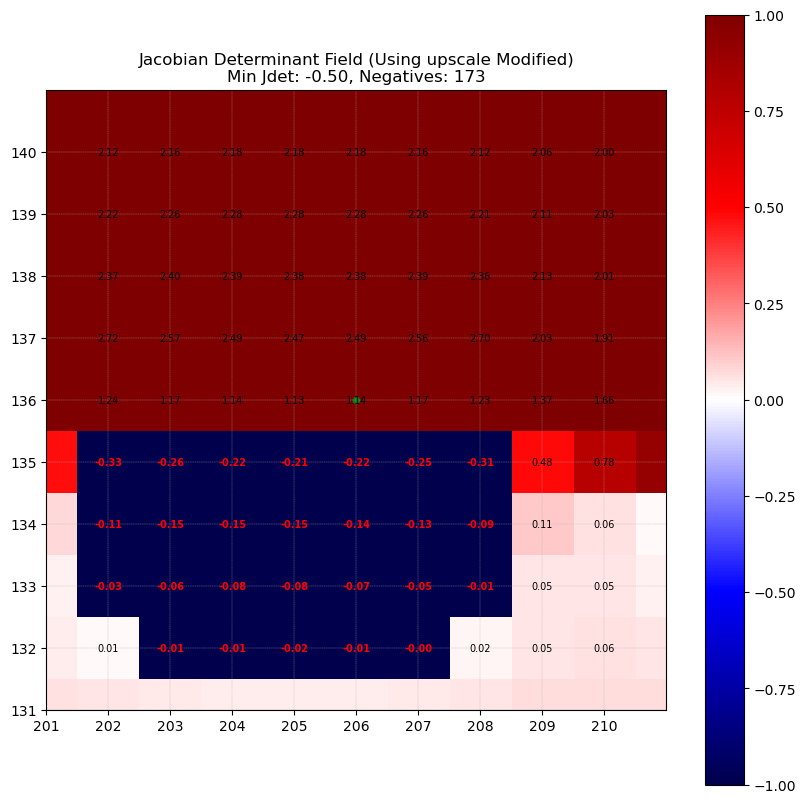

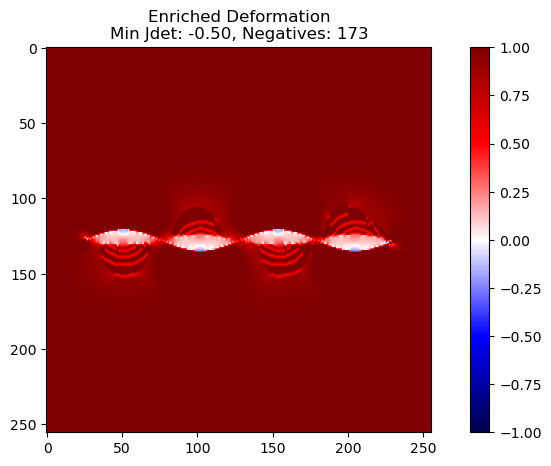

In [57]:
# Assume d_copy is your Data object with original correspondences
# and new_pairs is a list of (moving_coord, fixed_coord) tuples, where each coord is (y, x)

from copy import deepcopy
import numpy as np

# 1. Convert new_pairs to arrays with shape (N, 3) (add z=0 for 2D)
if len(new_pairs) > 0:
    new_mpoints = np.array([[0, y, x] for (y, x), _ in new_pairs])
    new_fpoints = np.array([[0, fy, fx] for _, (fy, fx) in new_pairs])

    # 2. Concatenate with d_copy's existing points
    all_mpoints = np.vstack([d_original.mpoints, new_mpoints])
    all_fpoints = np.vstack([d_original.fpoints, new_fpoints])

    # 3. Create a new Data object with the enriched correspondences
    d_copy = Data(all_mpoints, all_fpoints, d_original.resolution)
    
    
    jacobian_plot(d_copy, pt=correspondence_pt, figsize=(10, 10), title="Jacobian Determinant Field (Using upscale Modified)\nMin Jdet: {:.2f}, Negatives: {}".format(d_copy.min(), d_copy.count_negatives()),
              xlim=(correspondence_pt[1] - 5, correspondence_pt[1] + 5), 
              ylim=(correspondence_pt[0] - 5, correspondence_pt[0] + 5), 
              binarize_negatives=True)
    d_copy.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False,
                        title=f"Enriched Deformation\nMin Jdet: {d_copy.min():.2f}, Negatives: {d_copy.count_negatives()}")
else:
    print("No new pairs to add.")

# Now d_copy includes the new

# Test substitution


=== Creating Double Helix for Point Correspondence ===
Created double helix with 206 points per wave
Grid size: 256x256
Padding: 25 pixels on each side
Number of cycles: 2
Phase offset: 3.142 radians (180.0 degrees)
Wave 1 - X range: [25, 230], Y range: [120, 136]
Wave 2 - X range: [25, 230], Y range: [120, 136]
Number of intersection points: 10


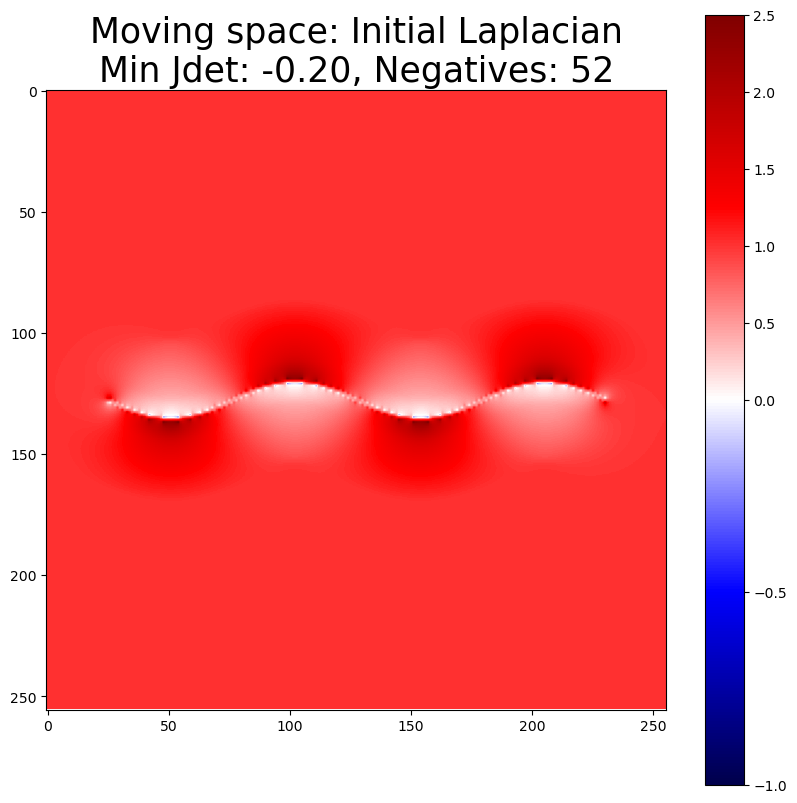

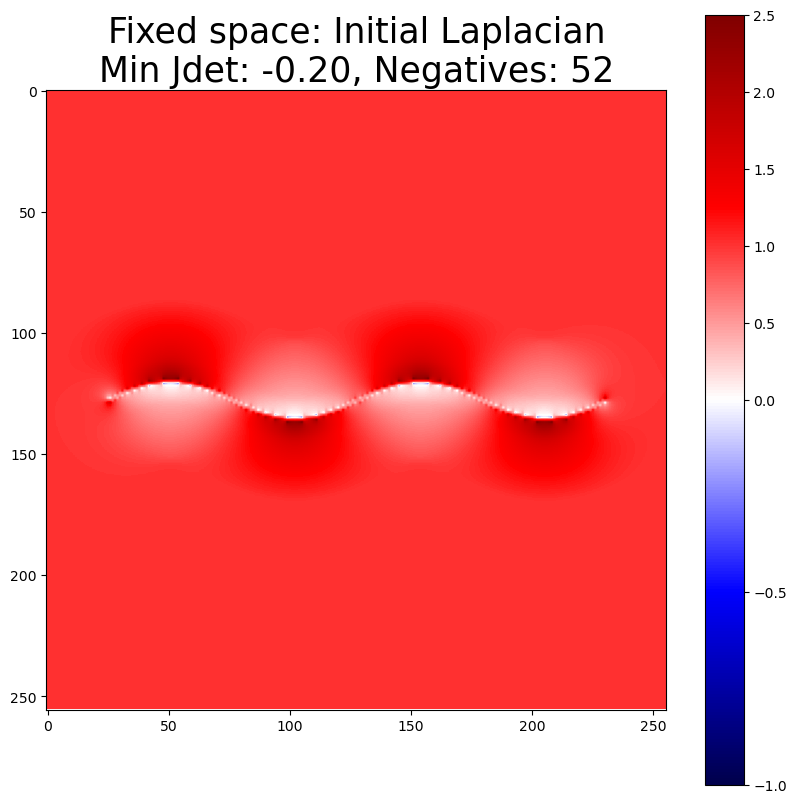

Found 96 expanding Jacobian determinants with threshold 2.0.



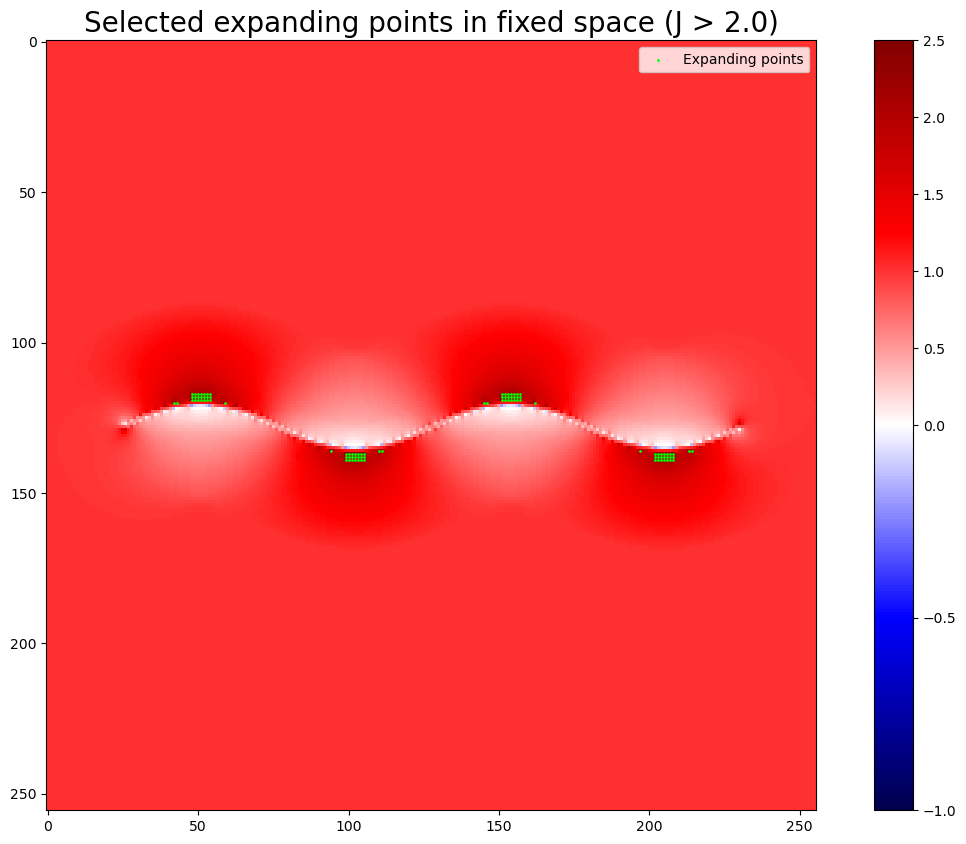

New moving points shape: (96, 3)
New fixed points shape: (96, 3)
Cleaned new moving points shape: (96, 3)
Cleaned new fixed points shape: (96, 3)
Cleaned new fixed points shape: (96, 3)
Cleaned new moving points shape: (96, 3)


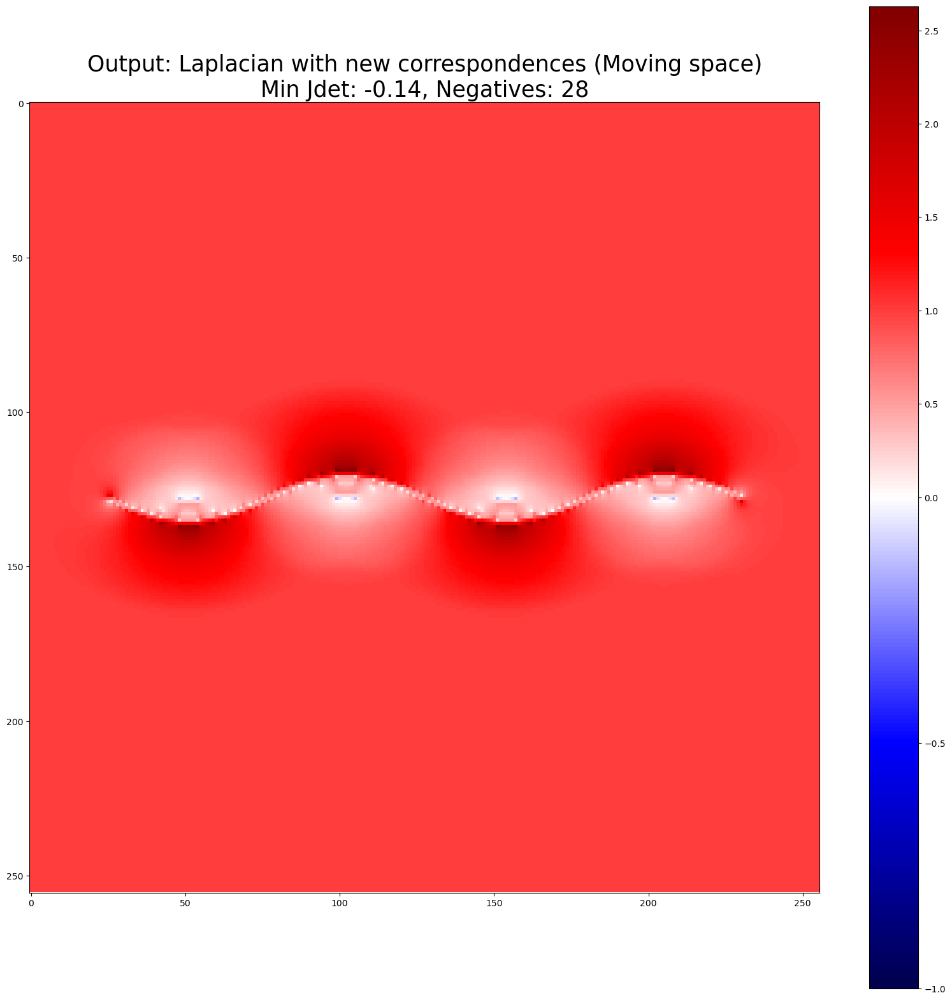

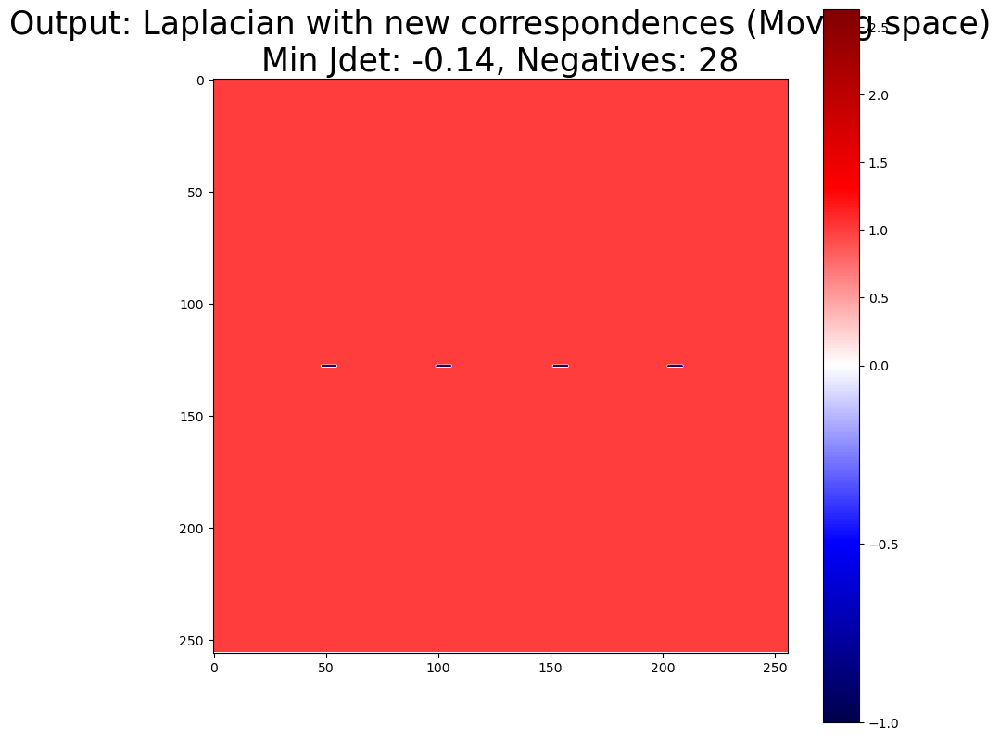

C:\Users\Andy\AppData\Local\Temp\ipykernel_9752\1100470945.py:209: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


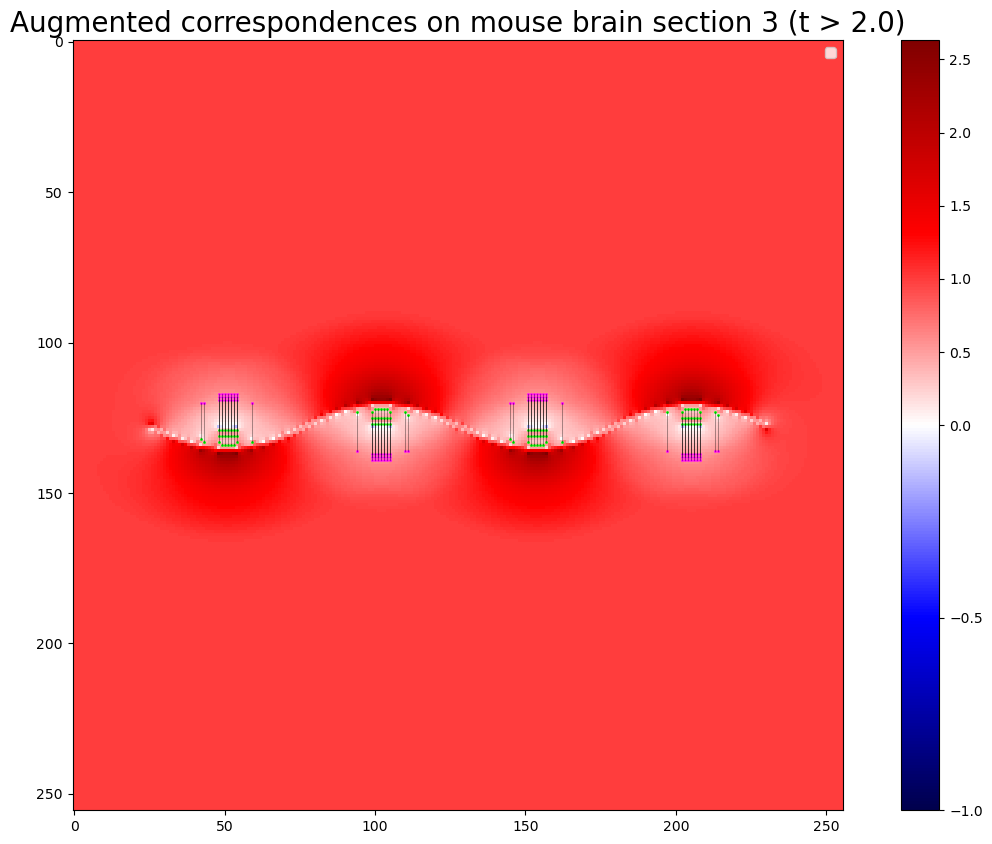

Old displacement at (129, 48): (8.229575271139424, 0.0)
New displacement at (129, 48): (-12.0, 0.0)
Old displacement at (129, 49): (8.28161978926392, 0.0)
New displacement at (129, 49): (-12.0, 0.0)
Old displacement at (129, 50): (8.310521575222017, 0.0)
New displacement at (129, 50): (-12.0, 0.0)
Old displacement at (129, 51): (8.313268814446387, 0.0)
New displacement at (129, 51): (-12.0, 0.0)
Old displacement at (129, 52): (8.293621306002828, 0.0)
New displacement at (129, 52): (-12.0, 0.0)
Old displacement at (129, 53): (8.247443340640158, 0.0)
New displacement at (129, 53): (-12.0, 0.0)
Old displacement at (129, 54): (8.177081798781135, 0.0)
New displacement at (129, 54): (-12.0, 0.0)
Old displacement at (129, 151): (8.206318165141857, 0.0)
New displacement at (129, 151): (-12.0, 0.0)
Old displacement at (129, 152): (8.264665069468837, 0.0)
New displacement at (129, 152): (-12.0, 0.0)
Old displacement at (129, 153): (8.298751024197564, 0.0)
New displacement at (129, 153): (-12.0, 

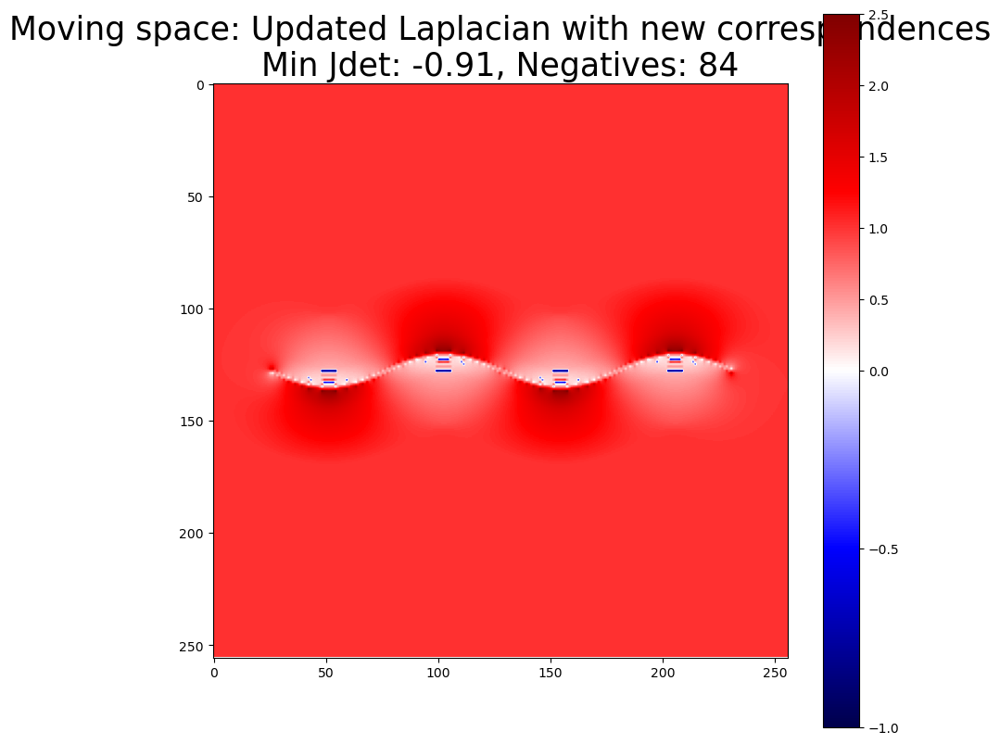

In [ ]:
scale = 3
jdet_threshold = 2.0
verbose = False
resolution = (256, 256)
# Remove point pairs where the distance between new_mpoints and new_fpoints is above a threshold
magnitude_thresh = 50  # 100 elsewhere
plot_points = True


# Create a specific double helix for correspondence analysis
print("\n=== Creating Double Helix for Point Correspondence ===")
mpoints, fpoints, _ = data_utils.create_double_helix_waves(
    grid_size=256,
    num_cycles=2,
    amplitude_ratio=0.03,
    phase_offset=np.pi,  # 180 degrees for maximum separation
    padding_ratio=0.1,
    plot=False, horizontal=False,  # Set horizontal to False for vertical helix
)

mpoints = mpoints[:, [1, 0]]  # Swap to (y, x) format
fpoints = fpoints[:, [1, 0]]  # Swap to (y, x) format 

# Add 0s on the first axis to format for Data class
mpoints = np.pad(mpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)
fpoints = np.pad(fpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)


#mpoints = mdata
#fpoints = fdata


# Create data classes
d_fixed = Data(mpoints, fpoints, resolution)  # 256x256 grid (320x456 for the real data)
d_moving = np.load("d_moving.npy", allow_pickle=True).item()
d_moving = Data_Moving(mpoints, fpoints, resolution)

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Moving space: Initial Laplacian\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

#d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
#       title=f"Moving space: Initial Laplacian - Negative Jacobians\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

d_fixed.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Fixed space: Initial Laplacian\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")

#d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
#       title=f"Fixed space: Initial Laplacian - Negative Jacobians\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")


# Upscale the deformation fields
upscaled_fixed = upscale_dvf_preserve(d_fixed.deformation, scale=scale)
upscaled_moving = upscale_dvf_preserve(d_moving.deformation, scale=scale)



########### EDIT:  DO IT IN MOVING SPACE ###########
#d_moving = d_fixed


expanding_coord = get_expanding_coordinates(d_fixed.jdet_field, threshold=jdet_threshold, verbose=False)
# Remove points that occur in the fixed points set
expanding_coord = np.array([coord for coord in expanding_coord if tuple(coord) not in set(map(tuple, d_moving.fpoints[:, 1:]))])




# For each expanding coordinate, get the adjacent coordinates in the upscaled deformation field
print()

new_mpoints = []
new_fpoints = []
for y, x in expanding_coord:
    # Get the corresponding coordinates in the upscaled deformation field (now use upscaled_moving)
    
    """
    y_curr = y * scale
    x_curr = x * scale
    displacement_curr = upscaled_moving[:, 0, y_curr, x_curr]
    mapped_point_curr = np.array((y + displacement_curr[1], x + displacement_curr[2]))

    # Left and right coordinates in the upscaled deformation field
    x_left = x_curr - 1
    x_right = x_curr + 1
    y_up = y_curr - 1
    y_down = y_curr + 1

    displacement_left = upscaled_moving[:, 0, y_curr, x_left]
    displacement_right = upscaled_moving[:, 0, y_curr, x_right]
    displacement_up = upscaled_moving[:, 0, y_up, x_curr]
    displacement_down = upscaled_moving[:, 0, y_down, x_curr]

    mapped_point_left = np.array((y + displacement_left[1], x + displacement_left[2]))
    mapped_point_right = np.array((y + displacement_right[1], x + displacement_right[2]))
    mapped_point_up = np.array((y + displacement_up[1], x + displacement_up[2]))
    mapped_point_down = np.array((y + displacement_down[1], x + displacement_down[2]))

    # Of all of the mapped points, find the mapped point that is closest to an integer coordinate
    mapped_points = [mapped_point_left, mapped_point_right, mapped_point_up, mapped_point_down, mapped_point_curr]
    closest_point = min(mapped_points, key=lambda p: np.linalg.norm(p - np.round(p)))
    closest_point = np.round(closest_point).astype(int)
    """
    # Now, moving point is [0, y, x], fixed point is [0, closest_point[0], closest_point[1]]
    new_fpoints.append([0, y, x])
    #new_fpoints.append([0, closest_point[0], closest_point[1]])
    #new_mpoints = [np.round(get_mapped_point(f[1:], d_fixed.deformation)).astype(int) for f in new_fpoints]
    # Add zero to the first axis for Data class compatibility
    new_mpoints = [np.concatenate([[0], np.round(get_mapped_point(f[1:], d_fixed.deformation)).astype(int)]) for f in new_fpoints]

    #for f in new_fpoints:
    #f = m.copy()
    #m -= np.array([0, 0, 0])  # Adjust to (y, x) format
    #mapped_point = get_mapped_point(m[1:], d_fixed.deformation)
    #print(f"Fixed point: {m[1:]} -> displacement: {get_displacement(m[1:], d_fixed.deformation)[1:]}, \tmapped point: {get_mapped_point(m[1:], d_fixed.deformation)}, \tjacobian: {d_fixed.jdet_field[m[1], m[2]]}")
    #print(mapped_point)
    #plt.scatter(mapped_point[1], mapped_point[0], c='violet', s=1, label='Mapped Points')


# Convert to numpy arrays for consistency
new_mpoints = np.array(new_mpoints)
new_fpoints = np.array(new_fpoints)

###### Visualize the Jacobian determinant field with J > thresh ######
plt.figure(figsize=(15, 10))
jdet_field = d_fixed.jdet_field.copy()
norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())

plt.imshow(jdet_field, cmap='seismic', norm=norm)
plt.colorbar()
# Connect moving and fixed points
plt.scatter(new_fpoints[:, 2], new_fpoints[:, 1], c='lime', s=1, label='Expanding points')
plt.title(f"Selected expanding points in fixed space (J > {jdet_threshold:.1f})", fontsize=20)
plt.legend()
plt.show()



print("New moving points shape:", new_mpoints.shape)
print("New fixed points shape:", new_fpoints.shape)

# Remove duplicates as before
new_fpoints = np.array([fp for fp in new_fpoints if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])
new_mpoints = np.array([mp for mp, fp in zip(new_mpoints, new_fpoints) if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])

new_mpoints = np.array([mp for mp in new_mpoints if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])
new_fpoints = np.array([fp for fp, mp in zip(new_fpoints, new_mpoints) if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])


# Compute distances for each pair
distances = np.linalg.norm(new_mpoints[:, 1:] - new_fpoints[:, 1:], axis=1)

# Create a mask for pairs within the threshold
mask = distances < magnitude_thresh

# Filter both arrays using the mask
new_mpoints = new_mpoints[mask]
new_fpoints = new_fpoints[mask]

print("Cleaned new moving points shape:", new_mpoints.shape)
print("Cleaned new fixed points shape:", new_fpoints.shape)

old_mpoints = mpoints.copy()
old_fpoints = fpoints.copy()


# Add to original set of correspondences
mpoints = np.vstack((mpoints, new_mpoints))
fpoints = np.vstack((fpoints, new_fpoints))

# ...existing code...
print("Cleaned new fixed points shape:", new_fpoints.shape)
print("Cleaned new moving points shape:", new_mpoints.shape)

# Add to original set of correspondences
mpoints = np.vstack((mpoints, new_mpoints))
fpoints = np.vstack((fpoints, new_fpoints))

# Create a new Data object with the updated points
d_expanded = Data_Moving(mpoints, fpoints, resolution)  # 256x256 grid (320x456 for the real data)
d_expanded.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 20), binarize_negatives=False,
       title=f"Output: Laplacian with new correspondences (Moving space)\nMin Jdet: {d_expanded.min():.2f}, Negatives: {d_expanded.count_negatives()}")
d_expanded.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
       title=f"Output: Laplacian with new correspondences (Moving space)\nMin Jdet: {d_expanded.min():.2f}, Negatives: {d_expanded.count_negatives()}")

###### Visualize the Jacobian determinant field with new correspondences ######
plt.figure(figsize=(15, 10))
jdet_field = d_expanded.jdet_field.copy()
norm = mcolors.TwoSlopeNorm(vmin=min(jdet_field.min(), -1), vcenter=0, vmax=jdet_field.max())
plt.imshow(jdet_field, cmap='seismic', norm=norm)
plt.colorbar()
# Vectorized plotting for all correspondences
# Draw lines between new_mpoints and new_fpoints
if plot_points:
       plt.plot(
       np.stack([new_mpoints[:, 2], new_fpoints[:, 2]]),
       np.stack([new_mpoints[:, 1], new_fpoints[:, 1]]),
       c='black', linewidth=0.5, alpha=0.5
       )

       # Scatter all points at once
       plt.scatter(new_mpoints[:, 2], new_mpoints[:, 1], c='lime', s=1)
       plt.scatter(new_fpoints[:, 2], new_fpoints[:, 1], c='magenta', s=1)
       #plt.scatter(old_mpoints[:, 2], old_mpoints[:, 1], c='green', s=1, label='Moving points', alpha=1)  # 0.15
       #plt.scatter(old_fpoints[:, 2], old_fpoints[:, 1], c='magenta', s=1, label='Fixed points', alpha=1)
       
#plt.grid(True, which='both', linestyle='--', linewidth=0.25)
#plt.gca().invert_yaxis()
plt.title(f"Augmented correspondences on mouse brain section 3 (t > {jdet_threshold:.1f})", fontsize=20)
plt.legend()
plt.show()

from copy import deepcopy
d_new = deepcopy(d_moving)
# Compute displacements for new correspondences
for mpoint, fpoint in zip(new_mpoints, new_fpoints):
    # mpoint and fpoint are [0, y, x]
    y, x = mpoint[1:]
    fy, fx = fpoint[1:]
    disp_y = fy - y
    disp_x = fx - x
    # Update the deformation field at (y, x)
    # Assuming d_expanded.deformation has shape (3, 1, H, W)
    print(f"mpoint: {mpoint}, fpoint: {fpoint}")
    print(f"Old displacement at ({y}, {x}): ({d_fixed.deformation[1, 0, y, x]}, {d_fixed.deformation[2, 0, y, x]})")
    d_new.deformation[1, 0, y, x] = disp_y
    d_new.deformation[2, 0, y, x] = disp_x
    print(f"New displacement at ({y}, {x}): ({d_new.deformation[1, 0, y, x]}, {d_new.deformation[2, 0, y, x]})")
    
d_new.jdet_field = jacobian.sitk_jacobian_determinant(d_new.deformation)[0]
d_new.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Moving space: Updated Laplacian with new correspondences\nMin Jdet: {d_new.min():.2f}, Negatives: {d_new.count_negatives()}")
# Save to raw image
#moving_img = data_utils.create_raw_image(d_fixed.mpoints, resolution, save_path="wave1.png")
#fixed_img = data_utils.create_raw_image(d_fixed.fpoints, resolution, save_path="wave2.png")
#transformed_img = reg_utils.apply_transformation(d_expanded, moving_img, title="Transformed Image (Moving space)")


=== Creating Double Helix for Point Correspondence ===
Created double helix with 206 points per wave
Grid size: 256x256
Padding: 25 pixels on each side
Number of cycles: 2
Phase offset: 3.142 radians (180.0 degrees)
Wave 1 - X range: [25, 230], Y range: [120, 136]
Wave 2 - X range: [25, 230], Y range: [120, 136]
Number of intersection points: 10


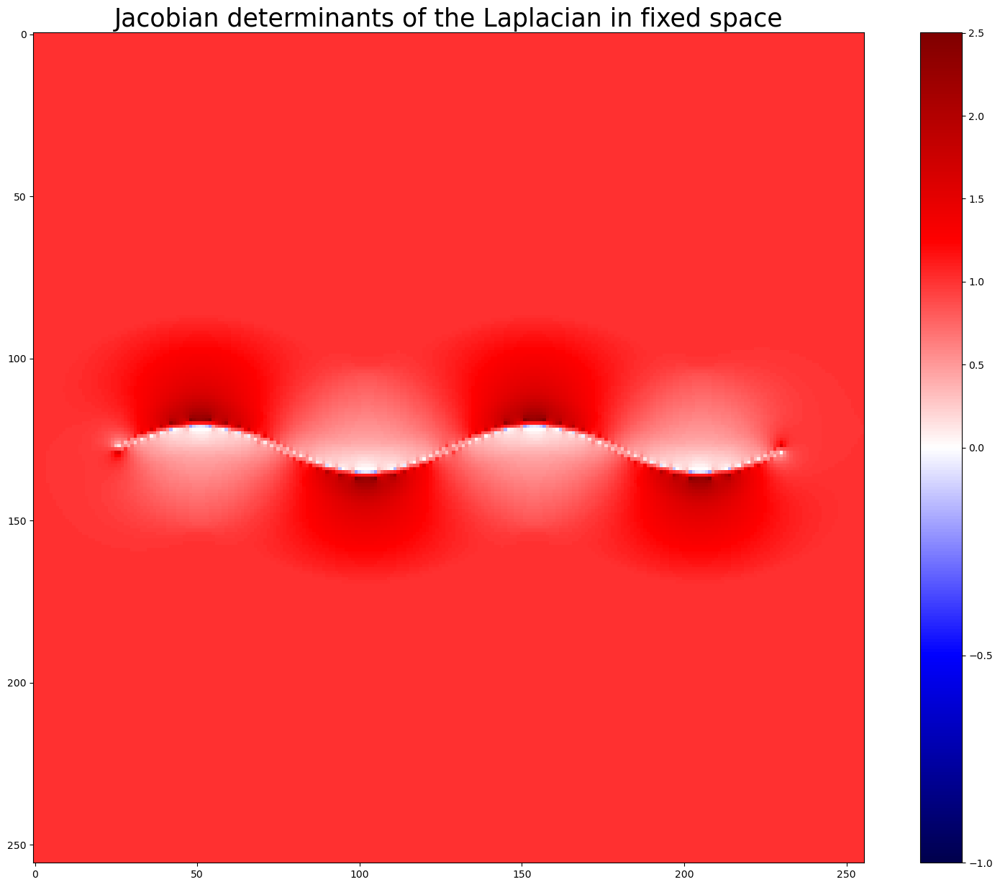

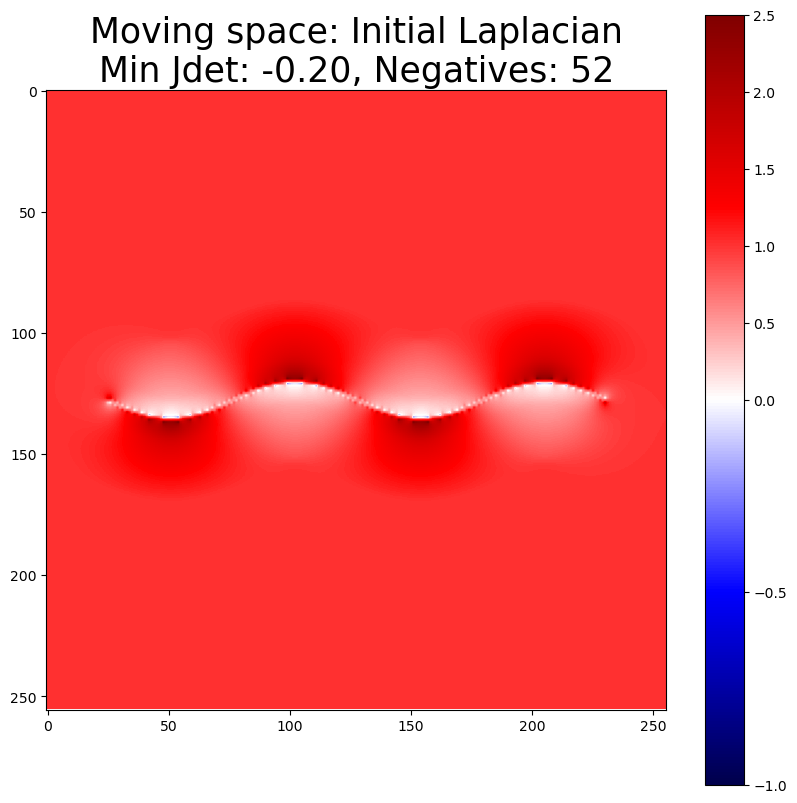

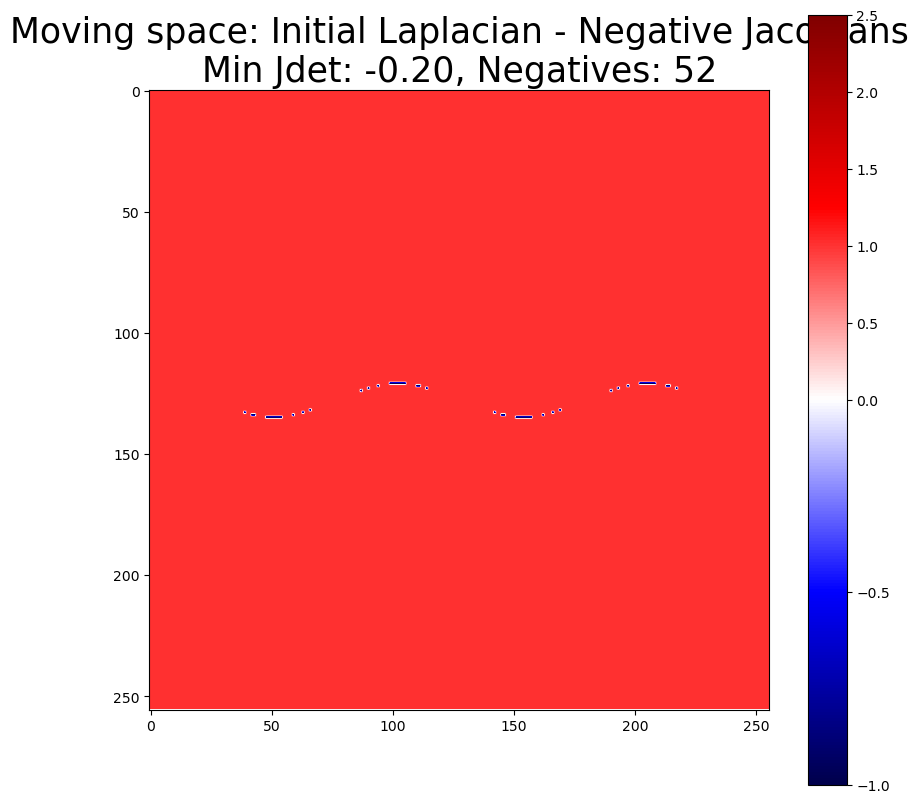

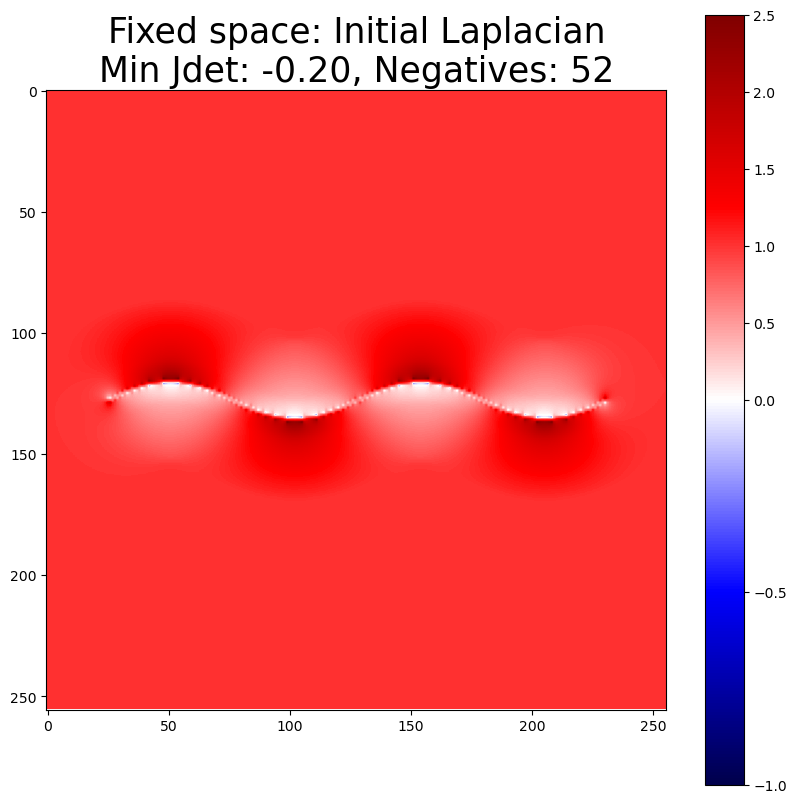

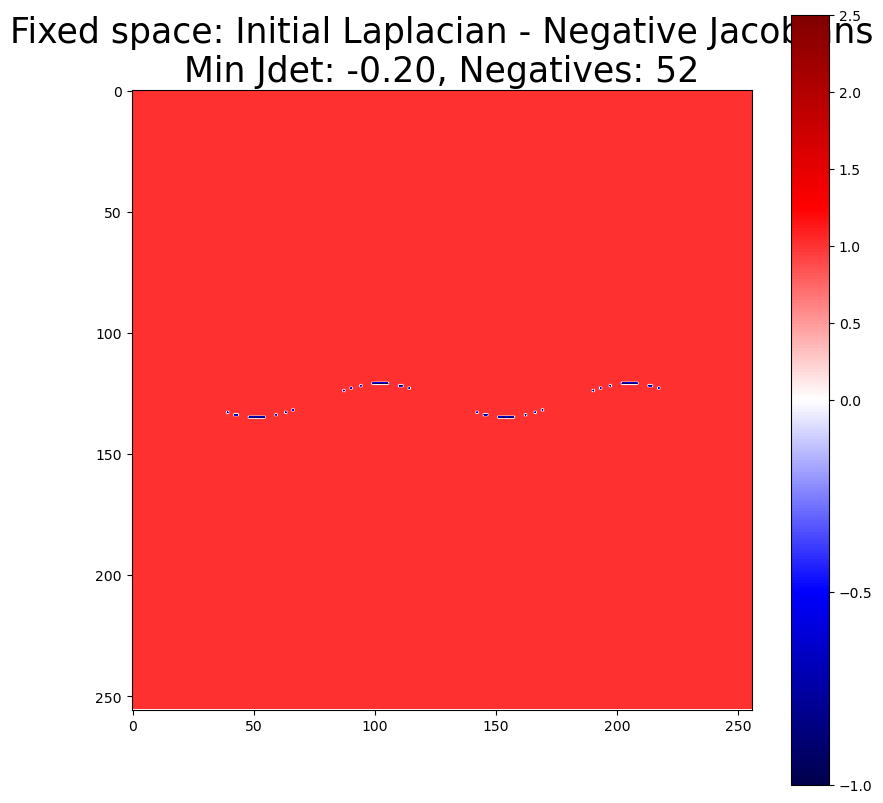

Found 96 expanding Jacobian determinants with threshold 2.0.

New fixed points shape: (96, 3)
New moving points shape: (96, 3)
Cleaned new fixed points shape: (96, 3)
Cleaned new moving points shape: (96, 3)


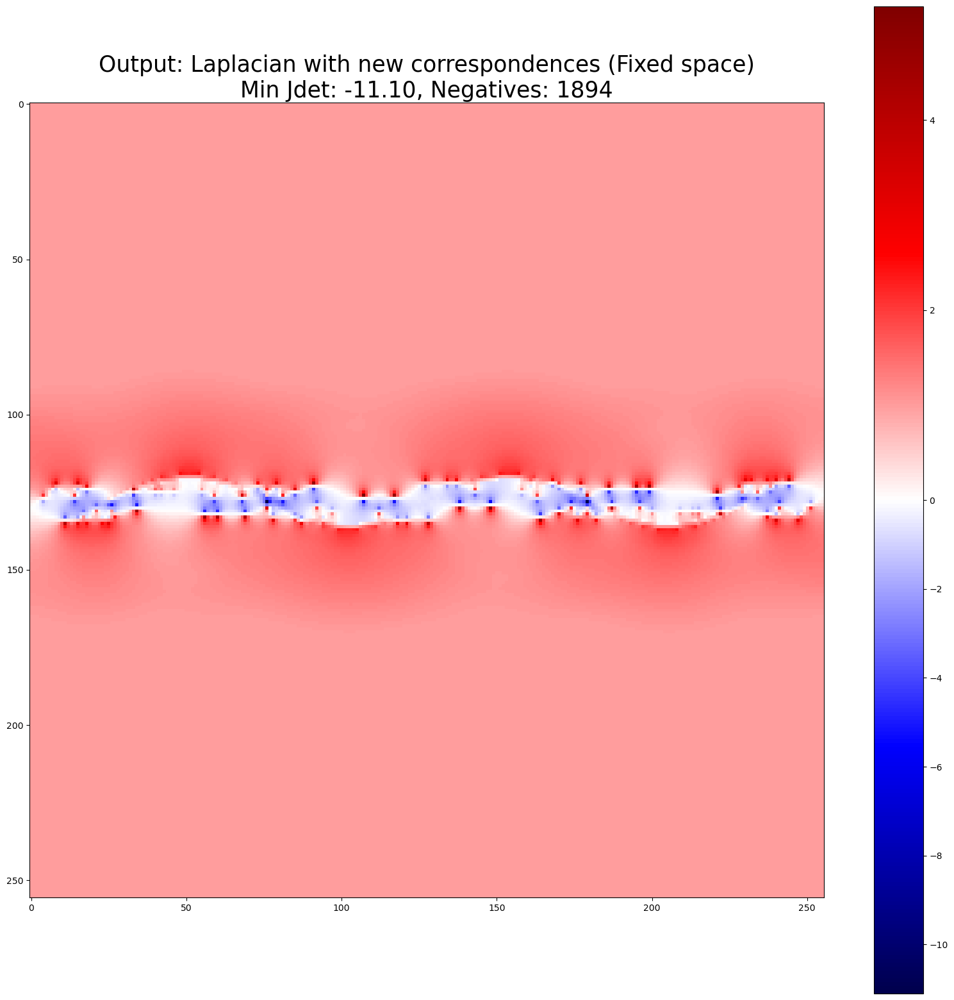

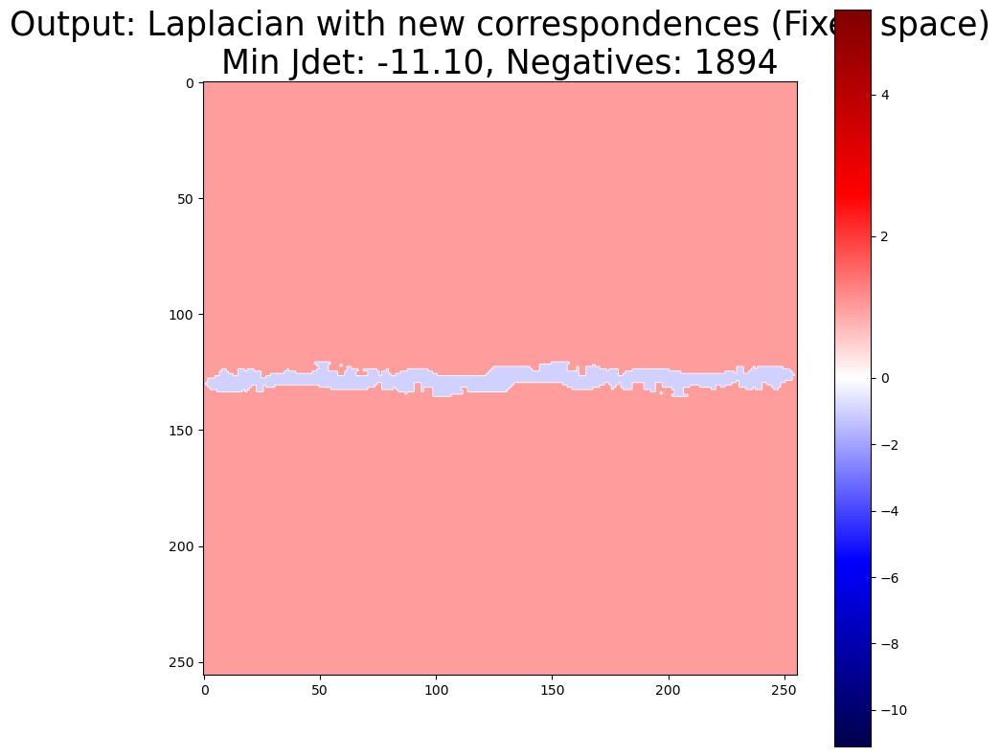

Old displacement at (117, 99): (-3.3693268272163555, 0.0)
New displacement at (117, 99): (11.912665193388165, 0.0)
Old displacement at (117, 100): (-3.409449114148283, 0.0)
New displacement at (117, 100): (12.149447128479864, 0.0)
Old displacement at (117, 101): (-3.4349095536702263, 0.0)
New displacement at (117, 101): (12.287299016202581, 0.0)
Old displacement at (117, 102): (-3.445638297916785, 0.0)
New displacement at (117, 102): (12.334840437159016, 0.0)
Old displacement at (117, 103): (-3.441345879855852, 0.0)
New displacement at (117, 103): (12.29831179060298, 0.0)
Old displacement at (117, 104): (-3.4218348148784714, 0.0)
New displacement at (117, 104): (12.173732898572297, 0.0)
Old displacement at (117, 105): (-3.3880655050699566, 0.0)
New displacement at (117, 105): (11.952406829362502, 0.0)
Old displacement at (117, 202): (-3.37017301686882, 0.0)
New displacement at (117, 202): (11.912674077653804, 0.0)
Old displacement at (117, 203): (-3.411451487400671, 0.0)
New displaceme

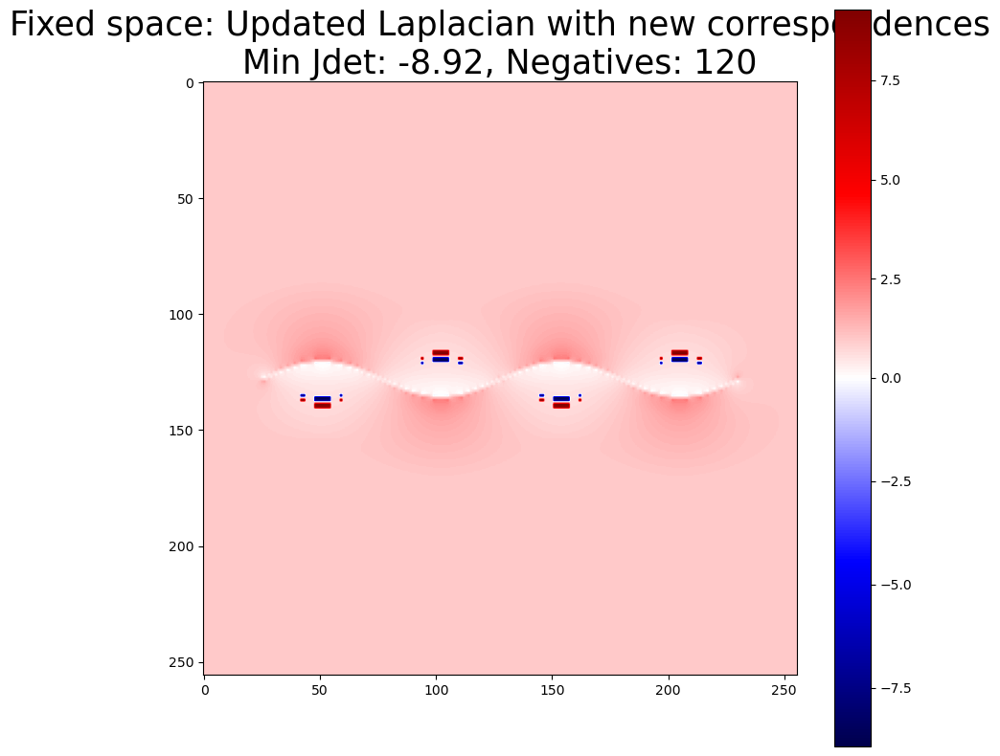

In [20]:
scale = 3
jdet_threshold = 2.0
verbose = False
resolution = (256, 256)
# Remove point pairs where the distance between new_mpoints and new_fpoints is above a threshold
magnitude_thresh = 9999  # 100 elsewhere
plot_points = True


# Create a specific double helix for correspondence analysis
print("\n=== Creating Double Helix for Point Correspondence ===")
mpoints, fpoints, _ = data_utils.create_double_helix_waves(
    grid_size=256,
    num_cycles=2,
    amplitude_ratio=0.03,
    phase_offset=np.pi,  # 180 degrees for maximum separation
    padding_ratio=0.1,
    plot=False, horizontal=False,  # Set horizontal to False for vertical helix
)

mpoints = mpoints[:, [1, 0]]  # Swap to (y, x) format
fpoints = fpoints[:, [1, 0]]  # Swap to (y, x) format 

# Add 0s on the first axis to format for Data class
mpoints = np.pad(mpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)
fpoints = np.pad(fpoints, ((0, 0), (1, 0)), mode='constant', constant_values=0)

#mpoints = mdata
#fpoints = fdata

d_fixed = Data(mpoints, fpoints, resolution)
#d_moving = np.load("d_moving.npy", allow_pickle=True).item()
#d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 15),
#       title=f"Jacobian determinants of the Laplacian in moving space")
d_moving = Data_Moving(mpoints, fpoints, resolution)

upscaled_fixed = upscale_dvf_preserve(d_fixed.deformation, scale=scale)
upscaled_moving = upscale_dvf_preserve(d_moving.deformation, scale=scale)

d_fixed.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 15), binarize_negatives=False,
       title=f"Jacobian determinants of the Laplacian in fixed space")


d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Moving space: Initial Laplacian\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
       title=f"Moving space: Initial Laplacian - Negative Jacobians\nMin Jdet: {d_moving.min():.2f}, Negatives: {d_moving.count_negatives()}")

d_fixed.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Fixed space: Initial Laplacian\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")

d_moving.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
       title=f"Fixed space: Initial Laplacian - Negative Jacobians\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")


########### EDIT:  DO IT IN MOVING SPACE ###########
#d_fixed = d_moving


expanding_coord = get_expanding_coordinates(d_moving.jdet_field, threshold=jdet_threshold, verbose=False)
# Remove points that occur in the fixed points set
expanding_coord = np.array([coord for coord in expanding_coord if tuple(coord) not in set(map(tuple, d_moving.fpoints[:, 1:]))])

# For each expanding coordinate, get the adjacent coordinates in the upscaled deformation field
print()

new_mpoints = []
new_fpoints = []
for y, x in expanding_coord:
    # Get the corresponding coordinates in the upscaled deformation field
    y_curr = y * scale
    x_curr = x * scale
    displacement_curr = upscaled_fixed[:, 0, y_curr, x_curr]
    mapped_point_curr = np.array((y + displacement_curr[1], x + displacement_curr[2]))
    
    # Left and right coordinates in the upscaled deformation field
    x_left = x_curr - 1
    x_right = x_curr + 1
    y_up = y_curr - 1
    y_down = y_curr + 1
    
    displacement_left = upscaled_fixed[:, 0, y_curr, x_left]
    displacement_left_1 = upscaled_fixed[:, 0, y_curr, x_left - 1]
    displacement_right = upscaled_fixed[:, 0, y_curr, x_right]
    displacement_right_1 = upscaled_fixed[:, 0, y_curr, x_right + 1]
    displacement_up = upscaled_fixed[:, 0, y_up, x_curr]
    displacement_up_1 = upscaled_fixed[:, 0, y_up - 1, x_curr]
    displacement_down = upscaled_fixed[:, 0, y_down, x_curr]
    displacement_down_1 = upscaled_fixed[:, 0, y_down + 1, x_curr]
    
    mapped_point_left = np.array((y + displacement_left[1], x + displacement_left[2]))
    mapped_point_left_1 = np.array((y + displacement_left_1[1], x + displacement_left_1[2]))
    mapped_point_right = np.array((y + displacement_right[1], x + displacement_right[2]))
    mapped_point_right_1 = np.array((y + displacement_right_1[1], x + displacement_right_1[2]))
    mapped_point_up = np.array((y + displacement_up[1], x + displacement_up[2]))
    mapped_point_up_1 = np.array((y + displacement_up_1[1], x + displacement_up_1[2]))
    mapped_point_up_neighbor = np.array((y - 1 + upscaled_fixed[:, 0, y_curr - 3], x + upscaled_fixed[:, 0, y_curr - 3]))
    mapped_point_down = np.array((y + displacement_down[1], x + displacement_down[2]))
    mapped_point_down_1 = np.array((y + displacement_down_1[1], x + displacement_down_1[2]))
    
    # Print the information
    if verbose:
        print(f"Expanding coordinate ({y}, {x}) in original field corresponds to ({y_curr}, {x_curr}) in upscaled field.")
        print(f"Deformation vector at this point: {displacement_curr}")
        #print(f"Mapped point in moving space: {mapped_point_curr} = {np.round(mapped_point_curr)}")
        
        #print(f"Left point - 2 ({y_curr//scale}, {(x_left-1)/scale:.2f}) -> Mapped: {mapped_point_left_1} = {np.round(mapped_point_left_1)}")
        print(f"Left point - 1 \t({y_curr//scale}, {x_left/scale:.2f}) \t-> Mapped: {mapped_point_left} = {np.round(mapped_point_left)}")
        
        #print(f"Right point + 2 ({y_curr//scale}, {(x_right + 1)/scale:.2f}) -> Mapped: {mapped_point_right_1} = {np.round(mapped_point_right_1)}")
        #print(f"Up neighbor \t({(y_up - 2)//scale}, {x_curr//scale}) \t-> Mapped: {mapped_point_up_neighbor} = {np.round(mapped_point_up_neighbor)}")
        #print(f"Up point - 2 \t({(y_up - 1)/scale:.2f}, {x_curr//scale}) \t-> Mapped: {mapped_point_up_1} = {np.round(mapped_point_up_1)}")
        print(f"Up point - 1 \t({y_up/scale:.2f}, {x_curr//scale}) \t-> Mapped: {mapped_point_up} = {np.round(mapped_point_up)}")
        print(f"Current point \t({y_curr//scale:.2f}, {x_curr//scale}) \t-> Mapped: {mapped_point_curr} = {np.round(mapped_point_curr)}")
        print(f"Down point + 1\t({y_down/scale:.2f}, {x_curr//scale}) \t-> Mapped: {mapped_point_down} = {np.round(mapped_point_down)}")
        print(f"Right point + 1\t({y_curr//scale}, {x_right/scale:.2f}) \t-> Mapped: {mapped_point_right} = {np.round(mapped_point_right)}")
        #print(f"Down point + 2 \t({(y_down + 1)/scale:.2f}, {x_curr//scale}) \t-> Mapped: {mapped_point_down_1} = {np.round(mapped_point_down_1)}")
    
    # Of all of the mapped points, find the mapped point that is closest to an integer coordinate
    mapped_points = [mapped_point_left, mapped_point_right, mapped_point_up, mapped_point_down, mapped_point_curr]
    closest_point = min(mapped_points, key=lambda p: np.linalg.norm(p - np.round(p)))
    if verbose:
        print(f"Closest mapped point to integer coordinate: {closest_point} = {np.round(closest_point)}")
        print()
        print()
        
    #closest_point = np.round(closest_point).astype(int)

    #new_fpoints.append([0, y, x])
    #new_mpoints.append([0, closest_point[0], closest_point[1]])
    
    # Now, moving point is [0, y, x], fixed point is [0, closest_point[0], closest_point[1]]
    new_mpoints.append([0, y, x])
    #new_fpoints.append([0, closest_point[0], closest_point[1]])
    #new_fpoints = [np.round(get_mapped_point(f[1:], d_moving.deformation)).astype(int) for f in new_mpoints]
    # Add zero to the first axis for Data class compatibility
    #new_fpoints = [np.concatenate([[0], np.round(get_mapped_point(f[1:], d_moving.deformation)).astype(int)]) 
    #               for f in new_mpoints]
    
    new_fpoints = [np.concatenate([[0], get_mapped_point(f[1:], d_moving.deformation)]) 
                   for f in new_mpoints]
    
    
    
# Convert to numpy arrays for consistency
new_fpoints = np.array(new_fpoints)
new_mpoints = np.array(new_mpoints)
    
print("New fixed points shape:", new_fpoints.shape)
print("New moving points shape:", new_mpoints.shape)


# Remove duplicates as before
new_fpoints = np.array([fp for fp in new_fpoints if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])
new_mpoints = np.array([mp for mp, fp in zip(new_mpoints, new_fpoints) if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])

new_mpoints = np.array([mp for mp in new_mpoints if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])
new_fpoints = np.array([fp for fp, mp in zip(new_fpoints, new_mpoints) if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])


# Compute distances for each pair
distances = np.linalg.norm(new_mpoints[:, 1:] - new_fpoints[:, 1:], axis=1)

# Create a mask for pairs within the threshold
mask = distances < magnitude_thresh

# Filter both arrays using the mask
new_mpoints = new_mpoints[mask]
new_fpoints = new_fpoints[mask]


# If a new moving point is already in the original mpoints, remove it and its corresponding fixed point
#new_mpoints = np.array([mp for mp in new_mpoints if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])
#new_fpoints = np.array([fp for fp, mp in zip(new_fpoints, new_mpoints) if tuple(mp[1:]) not in set(map(tuple, mpoints[:, 1:]))])

# If a new fixed point is already in the original fpoints, remove it and its corresponding moving point
#new_fpoints = np.array([fp for fp in new_fpoints if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])
#new_mpoints = np.array([mp for mp, fp in zip(new_mpoints, new_fpoints) if tuple(fp[1:]) not in set(map(tuple, fpoints[:, 1:]))])  

print("Cleaned new fixed points shape:", new_fpoints.shape)
print("Cleaned new moving points shape:", new_mpoints.shape)

# Add to original set of correspondences
mpoints = np.vstack((mpoints, new_mpoints))
fpoints = np.vstack((fpoints, new_fpoints))

# Create a new Data object with the updated points
d_expanded = Data(mpoints, fpoints, resolution)
d_expanded.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(20, 20), binarize_negatives=False,
       title=f"Output: Laplacian with new correspondences (Fixed space)\nMin Jdet: {d_expanded.min():.2f}, Negatives: {d_expanded.count_negatives()}")
d_expanded.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=True,
       title=f"Output: Laplacian with new correspondences (Fixed space)\nMin Jdet: {d_expanded.min():.2f}, Negatives: {d_expanded.count_negatives()}")

# Compute displacements for new correspondences
for mpoint, fpoint in zip(new_mpoints, new_fpoints):
    # mpoint and fpoint are [0, y, x]
    y, x = mpoint[1:]
    fy, fx = fpoint[1:]
    disp_y = fy - y
    disp_x = fx - x
    # Update the deformation field at (y, x)
    # Assuming d_expanded.deformation has shape (3, 1, H, W)
    print(f"Old displacement at ({y}, {x}): ({d_fixed.deformation[1, 0, y, x]}, {d_fixed.deformation[2, 0, y, x]})")
    d_fixed.deformation[1, 0, y, x] = disp_y
    d_fixed.deformation[2, 0, y, x] = disp_x
    print(f"New displacement at ({y}, {x}): ({d_fixed.deformation[1, 0, y, x]}, {d_fixed.deformation[2, 0, y, x]})")
    
    

d_fixed.jdet_field = jacobian.sitk_jacobian_determinant(d_fixed.deformation)[0]

d_fixed.show(fontsize=0, show_text=False, show_axis=False, show_correspondence=False, show_orientation=False, figsize=(10, 10), binarize_negatives=False,
       title=f"Fixed space: Updated Laplacian with new correspondences\nMin Jdet: {d_fixed.min():.2f}, Negatives: {d_fixed.count_negatives()}")


# Save to raw image
#moving_img = data_utils.create_raw_image(d_fixed.mpoints, resolution, save_path="wave1.png")
#fixed_img = data_utils.create_raw_image(d_fixed.mpoints, resolution, save_path="wave2.png")

#original_transformation = reg_utils.apply_transformation_fixed(d_fixed, brain_img, title="Mouse brain section 1 - original transformation")
#transformed_img = reg_utils.apply_transformation_fixed(d_expanded, brain_img, title="Mouse brain section 1 - augmented correspondences")


# Generate paper header image

In [21]:
b0039_path = "data/b0039_brain_25.nii.gz"
elastixRefined_path = "data/corrected_correspondences_count_touching/registered_output/elastixRefined.nii.gz"
annotation_path = "data/CCF_DATA/annotation_25.nii.gz"
average_path = "data/CCF_DATA/average_template_25.nii.gz"
moving_path = "data/corrected_correspondences_count_touching/mpoints.npy"
fixed_path = "data/corrected_correspondences_count_touching/fpoints.npy"

CURR_IDX = 500
font_size = 20

#################################################################################################

# Load the moving and fixed points
mpoints = np.load(moving_path, allow_pickle=True)
fpoints = np.load(fixed_path, allow_pickle=True)

# Get only coordinates at the current z index
mpoints = mpoints[mpoints[:, 0] == CURR_IDX]
fpoints = fpoints[fpoints[:, 0] == CURR_IDX]

# Zero out the first axis values to match a 2D image format
mpoints[:, 0] = 0
fpoints[:, 0] = 0

# Load the data volume image
import nibabel as nib
b0039 = nib.load(b0039_path).get_fdata()  # Get the specific z slice
refined_img = nib.load(elastixRefined_path).get_fdata()[CURR_IDX, :, :]  # Get the specific z slice

# Load the annotation and average images
annotation_img = nib.load(annotation_path).get_fdata()[CURR_IDX, :, :]  # Get the specific z slice
average_img = nib.load(average_path).get_fdata()[CURR_IDX, :, :]  # Get the specific z slice

# Create a Data object with the loaded points
d_loaded = Data(mpoints, fpoints, resolution=(refined_img.shape[0], refined_img.shape[1]))

In [22]:
import cv2

def auto_contrast(data: np.ndarray, alpha: float = None, beta: float = None) -> np.ndarray:
    """
    Preprocess tiff files to automatically adjust brightness and contrast.
    https://stackoverflow.com/questions/56905592/automatic-contrast-and-brightness-adjustment-of-a-color-photo-of-a-sheet-of-pape
    """
    if not alpha:
        alpha = np.iinfo(data.dtype).max / (np.max(data) - np.min(data))
    if not beta:
        beta = -np.min(data) * alpha
    img = cv2.convertScaleAbs(data.copy(), alpha=alpha, beta=beta)
    return img

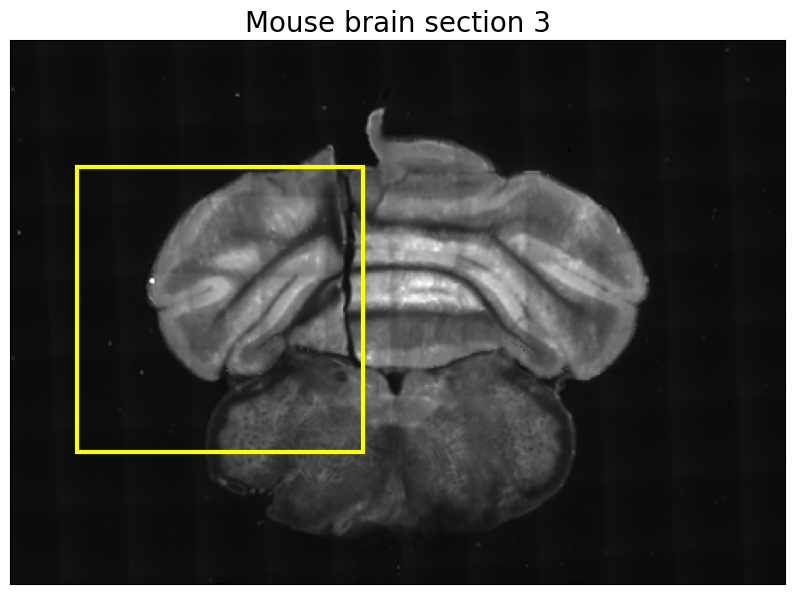

In [23]:
# slice 200, skip 2 window offset 40 offset -15 for y
# ylim = (79, 88)
# xlim = (275, 284)

# For 350: skip 3, window offset 100, max dist 10
# (235 - 23, 242 - 23)
# (197, 204)
# For 350: skip 3, window offset 100 (new 50), max dist 10
# (212, 219)
# (197, 204)

# For 500: skip 3, max dist 50, window offset 80, offset 80 (new 70)
# 84 92
# 119 127

#jylim = (235 - 23 - 100, 242 - 23 + 100)
#jxlim = (197 - 100, 204 + 100)

jylim = (84 - 80 + 70, 92 + 80 + 70)
jxlim = (119 - 80, 127 + 80)

box_coords = [
    (jylim[0], jxlim[0]),  # top-left
    (jylim[0], jxlim[1]),  # top-right
    (jylim[1], jxlim[1]),  # bottom-right
    (jylim[1], jxlim[0])   # bottom-left
]

# Compute bounding box
ys, xs = zip(*box_coords)
min_x, max_x = min(xs), max(xs)
min_y, max_y = min(ys), max(ys)
width = max_x - min_x
height = max_y - min_y

# Moving image - elastixRefined
plt.figure(figsize=(10, 10))
plt.imshow(auto_contrast(refined_img, alpha=0.45), cmap='gray')
ax = plt.gca()
rect = patches.Rectangle((min_x, min_y), width, height, linewidth=3, edgecolor='yellow', facecolor='none')
ax.add_patch(rect)

plt.title(f"Mouse brain section 3", fontsize=font_size)
plt.xticks([])
plt.yticks([])
plt.show()

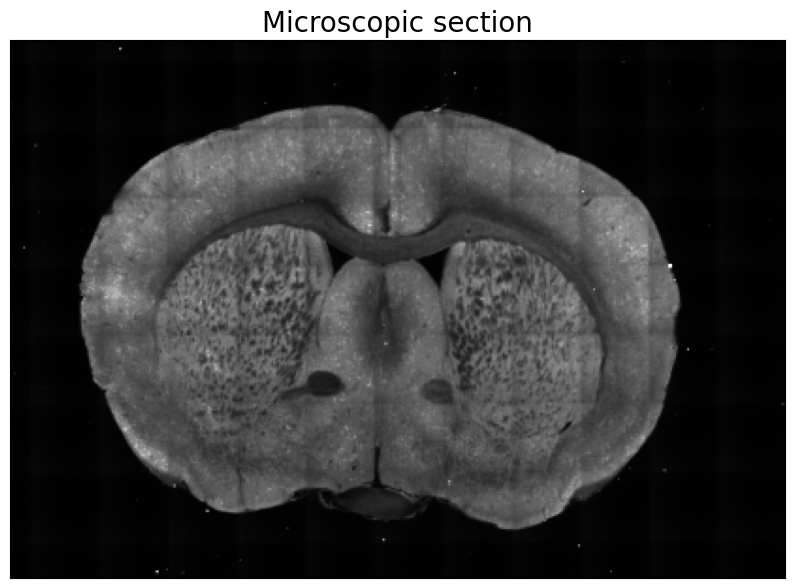

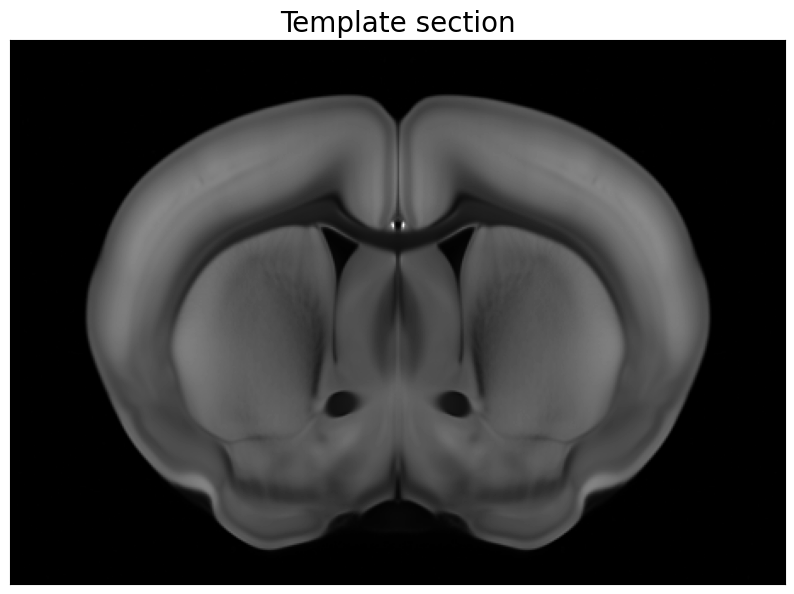

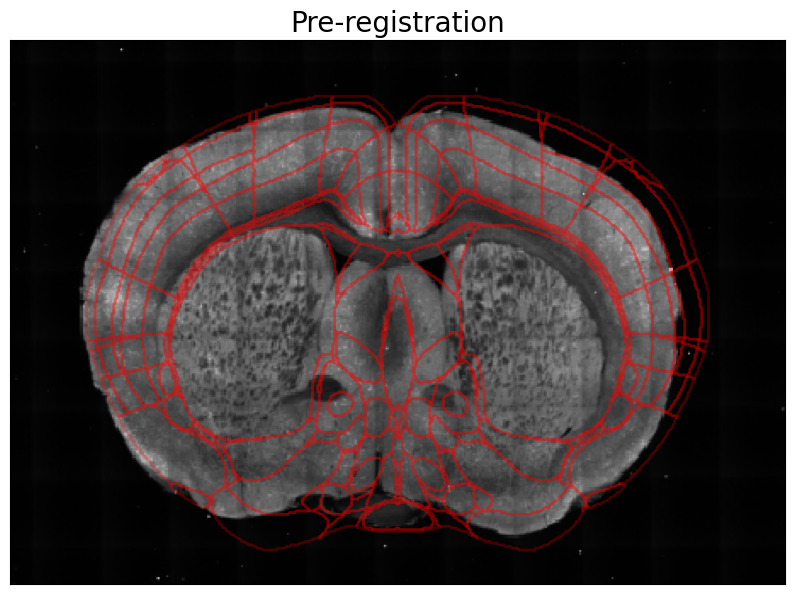

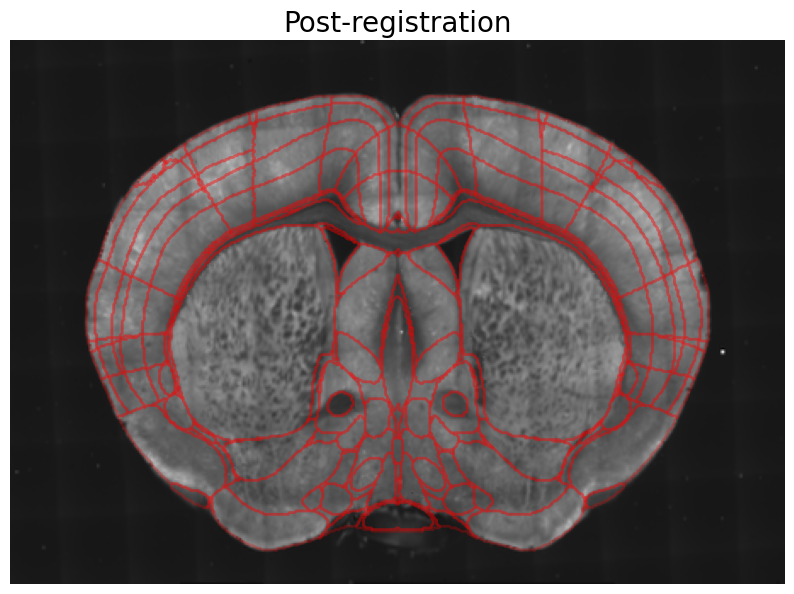

In [28]:
from skimage import measure
from functools import partial

before_reg = auto_contrast(b0039[92], alpha=0.45)[50:-100, 100:-50]  # Crop the image to match the annotation size

# Moving image 
plt.figure(figsize=(10, 10))
plt.imshow(before_reg, cmap='gray')
plt.title("Microscopic section", fontsize=font_size)
plt.xticks([])
plt.yticks([])
plt.show()

# Fixed image - average annotation
plt.figure(figsize=(10, 10))
plt.imshow(average_img, cmap='gray')
plt.title("Template section", fontsize=font_size)
plt.xticks([])
plt.yticks([])
plt.show()

# Before registration (show outline of annotation regions on the moving image)
# Resize the annotation image to match the moving image size
before_reg = cv2.resize(before_reg, (456, 320), interpolation=cv2.INTER_NEAREST)

plt.figure(figsize=(10, 10))
plt.imshow(before_reg, cmap='gray')
plt.title("Pre-registration", fontsize=font_size)
# For each label (skip background 0)
for label in range(1, int(annotation_img.max()) + 1):
    contours = measure.find_contours(annotation_img == label, 0.5)
    for contour in contours:
        plt.plot(contour[:, 1], contour[:, 0], linewidth=2, color='red', alpha=0.25)
plt.xticks([])
plt.yticks([])
plt.show()

# Apply registration
plt.figure(figsize=(10, 10))
deformation_field = d_loaded.deformation  # Get the deformation field (dx, dy, dz)
transformedData = reg_utils.geometric_transform(refined_img, 
                                        partial(reg_utils.shift3Dfunc, dx=deformation_field[0], dy=deformation_field[1], dz=deformation_field[2]), order=1, prefilter=False)
#transformedData = transformedData[0, :, :]  # Get the first channel only
plt.imshow(refined_img, cmap='gray')
# For each label (skip background 0)
for label in range(1, int(annotation_img.max()) + 1):
    contours = measure.find_contours(annotation_img == label, 0.5)
    for contour in contours:
        plt.plot(contour[:, 1], contour[:, 0], linewidth=2, color='red', alpha=0.25)
plt.title("Post-registration", fontsize=font_size)
plt.axis('off')  # Hide axes
plt.show()